# Chapter 11 - Single Objective Optimization


© 2021, 2022 Packt Publishing

Written by Alex Khan

In [1]:
# Enter the S3 bucket you created during onboarding in the code below
my_bucket = "amazon-braket-[your bucket]" # the name of the bucket
my_prefix = "[your folder]" # the name of the folder in the bucket
s3_folder = (my_bucket, my_prefix)

In [3]:
from braket.circuits import Circuit, Gate, Observable
from braket.devices import LocalSimulator
from braket.aws import AwsDevice, AwsQuantumTask
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
%matplotlib inline

In [4]:
import numpy as np

In [5]:
from scipy.optimize import minimize, curve_fit


In [6]:
# to check all gate operations refer to 
# https://docs.aws.amazon.com/braket/latest/developerguide/braket-constructing-circuit.html

https://docs.aws.amazon.com/braket/latest/developerguide/braket-constructing-circuit.html

In [7]:
def available_devices():
    from braket.aws import AwsDevice
    device_list=AwsDevice.get_devices(statuses=['ONLINE'])
    device_name_list=[]
    for device in device_list:
        device_name_list.append(device.name)
    #print('Valid device names: ',device_name_list)
    return(device_name_list)

In [8]:
def set_device(Name):
    device_list=AwsDevice.get_devices(names=Name)
    if len(device_list)==1:
        device=device_list[0]
        print(device)
        return(device)
    else:
        print('No device found')
        print('use name from list', available_devices())

In [9]:
def estimate_cost(device,num_shots=1000):
    #device=set_device(Name)
    cost_per_task=0.30
    Name=device.name
    if Name in ['SV1','TN1','dm1']:
        price_per_min=device.properties.service.deviceCost.price
        unit=device.properties.service.deviceCost.unit
        print('simulator cost per ',unit,': $', price_per_min)
        print('total cost cannot be estimated')
    elif Name in['Advantage_system1.1','DW_2000Q_6','Aspen-11','IonQ Device','Aspen-M-1']:
        price_per_shot=device.properties.service.deviceCost.price
        unit=device.properties.service.deviceCost.unit
        print('device cost per ',unit,': $', price_per_shot)
        print('total cost for {} shots is ${:.2f}'.format(num_shots,cost_per_task+num_shots*price_per_shot))
    else:
        print('device not found')
        print('use name from list', available_devices())


In [10]:
# This function was modified with a return of num_shots
def estimate_cost_measured_qubits(device,measured_qubits):
    #device=set_device(Name)
    min_shots_per_variable=25
    max_shots=device.properties.service.shotsRange[1]
    print('max shots:', max_shots)
    num_shots=min_shots_per_variable*2**measured_qubits
    if num_shots>max_shots:
        num_shots=max_shots
        print('for {} measured qubits the maximum allowed shots: {:,}'.format(measured_qubits,num_shots))
    else:
        print('for {} measured qubits the number of shots recommended: {:,}'.format(measured_qubits,num_shots))
    estimate_cost(device,num_shots)
    return(num_shots)

In [11]:
def actual_simulator_cost(device, result):
        price_per_min=device.properties.service.deviceCost.price
        price_per_ms=price_per_min/60/1000
        unit=device.properties.service.deviceCost.unit
        duration_ms=result.additional_metadata.simulatorMetadata.executionDuration
        if unit=='minute':
            print('simulator cost per ',unit,': $', price_per_min)
            print('total execution time: ', duration_ms, "ms")
            print('total cost estimated: $',duration_ms*price_per_ms)

In [12]:
# this function has been updated from the function in past chapters
def run_circuit(circuit, shots, local=True, device_name='', s3_folder='', display_binary=False, disable_qubit_rewiring=False):
    import matplotlib.pyplot as plt
    %matplotlib inline
    if local==True:
        device = LocalSimulator()
        result = device.run(circuit, shots=shots).result()
    else:
        device=set_device(device_name)
        if shots==0:
            measured_qubits=len(circuit.qubits)
            num_reads=estimate_cost_measured_qubits(device,measured_qubits)
        else:
            num_reads=shots
        print('device', device)
        print('num reads', num_reads)
        if device_name=='Aspen-11' or device_name=='Aspen-M-1':
            result = device.run(circuit, shots=num_reads, s3_destination_folder=s3_folder, disable_qubit_rewiring=disable_qubit_rewiring).result()
        else:
            result = device.run(circuit, shots=num_reads, s3_destination_folder=s3_folder).result()
        if device_name in (['SV1','TN1']):
            actual_simulator_cost(device, result)
        else:
            estimate_cost(device, num_reads)
    counts = result.measurement_counts
    if display_binary==True:
        print(counts)
        plt.bar(int(counts.keys(),2), counts.values());
        plt.xlabel('states');
        plt.ylabel('counts');
    else:
        x_val=[]
        y_val=[]
        dec_counts={}
        for i in (counts.keys()):
            x_val.append(int(i,2))
        for i in (counts.values()):
            y_val.append(i)
        for i in range(len(x_val)):
            dec_counts[x_val[i]]=y_val[i]
        print(dec_counts)
        plt.bar(x_val, y_val)

        plt.xlabel('states');
        plt.ylabel('counts');
    
    return(result)

In [13]:
def draw_bloch(q, info=True):
    #©2021-2 Alex Khan
    
    import matplotlib.pyplot as plt
    import numpy as np

    if q.shape != (2,1):
        print('Matrix must be only for one qubit')
        print('Shape needed (2,1). Shape given ',q.shape)
        return
    
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.set_aspect("auto")
    if info==True:
        print('Matrix:')
        print(q)
    # draw Bloch Sphere
    u, v = np.mgrid[0:2*np.pi:50j, 0:np.pi:50j]
    x = np.cos(u)*np.sin(v)
    y = np.sin(u)*np.sin(v)
    z = np.cos(v)
    ax.plot_surface(x, y, z, color="y", alpha=0.2)

    u = np.linspace(0, 2* np.pi, 100)

    ax.plot(np.sin(u),np.cos(u),0*(u),color='y')
    ax.plot(0*(u),np.sin(u),np.cos(u),color='y')
    ax.plot(np.sin(u),0*(u),np.cos(u),color='y')

    # draw axes
    ax.plot([0,0],[1,-1],[0,0], color='y', linestyle='dotted')
    ax.plot([1,-1],[0,0],[0,0], color='y', linestyle='dotted')
    ax.plot([0,0],[0,0],[1,-1], color='y', linestyle='dotted')

    # draw state labels
    ax.annotate("|0>", xy=(0.0, 0.04), xytext=(0.0, 0.07), arrowprops=dict(arrowstyle="->"), color='y')
    ax.annotate("|1>", xy=(0.0, -0.04), xytext=(0.0, -0.07), arrowprops=dict(arrowstyle="->"), color='y')
    ax.annotate("|+>", xy=(-0.025, -0.022), xytext=(-0.06, -0.04), arrowprops=dict(arrowstyle="->"), color='y')

    # calculate vector
    
    r0=((q[0].real)**2+(q[0].imag)**2)**0.5
    #print('r0=',r0)
    if r0==0:
        phi0=0
    else:
    
        phi0=np.arccos(q[0].real/r0)
    
    r1=((q[1].real)**2+(q[1].imag)**2)**0.5
    #print('r1=',r1)
    if r1==0:
        phi1=0
    else:
    
        phi1=np.arccos(q[1].real/r1)
    r=(r0**2+r1**2)**0.5
    
    if(r<0.999 or r>1.0001):
        print('vector is  not normalized.  Cannot draw')
        return
    
    if np.sin(q[1].imag)<0:
        s1=-1
    else:
        s1=+1#

    if np.sin(q[0].imag)<0:
        s0=-1
    else:
        s0=+1
    

    #print('phi1',phi1,'phi0', phi0)
    phi=s1*phi1-s0*phi0   


    theta=2*np.arccos((q[0].real**2+q[0].imag**2)**0.5)
    
    v_x = np.cos(phi)*np.sin(theta)
    v_y = np.sin(phi)*np.sin(theta)


    v_z = np.cos(theta)
    v_z2= np.sin(theta)
    #print('theta',theta, 'phi',phi)

    #print('vx=cos(phi)',np.cos(phi), 'x sin(theta)', np.sin(theta),'= ',v_x)
    #print('vy=sin(phi)',np.sin(phi), 'x sin(theta)', np.sin(theta),'= ',v_y )
    #print('vz=cos(theta)', v_z)
    
    # print state
    if info==True:
        print(' ')
        print('State Vector: |psi> = sqrt(', q[0].real**2+q[0].imag**2, ') |0> + ( sqrt(', q[1].real**2+q[1].imag**2,')) e^i', phi/np.pi,'pi |1>')
        print(' ')
    # draw vector
    ax.quiver(0,0,0,v_y, -v_x, v_z, color='r')
    #print('cartesian coordinates on Bloch Sphere')
    #print(v_x, v_y, v_z)
    plt.axis('off')
    fig.set_size_inches(7, 7)
    #ax.view_init(10, 10, 10)
    #print('Bloch Sphere:')
    plt.show()
    return(q)

In [14]:
def draw_circuit(circ, info=True):
    # this function is only for one qubit and draws the Bloch sphere
    circ=circ.state_vector()
    if info==True:
        print(circ)
    device = LocalSimulator()
    result = device.run(circ).result()
    arr_r=np.array([[result.values[0][0]],[result.values[0][1]]])
    draw_bloch(arr_r, info)

In [15]:
def qft_gate(qc,qubits_needed):
    
    power=0

    for target in range(qubits_needed-1,-1,-1):
        qc.h(target)
        for control in range(target-1,-1,-1):
 
            power=target-control

            qc.cphaseshift(control, target, (np.pi/(2**(power))))


    #reverse qubits

    #for i in range (int(qubits_needed/2)):
        
        #qc.swap(i,qubits_needed-i-1)
    return(qc)

In [16]:
def qft_inv_gate(qc, qubits_needed, q_start=0):
    
    power=0

    for target in range(0,qubits_needed):
        
        for control in range(0,target):

            power=target-control

            qc.cphaseshift(control+q_start, target+q_start, -(np.pi/(2**(power))))
        
        qc.h(target+q_start)
    
    for i in range (int(qubits_needed/2)-1,-1,-1):
        
        qc.swap(i+q_start,qubits_needed-i-1+q_start)

    return(qc)

In [17]:
def draw_multi_qubit_phase(Qubits, Number, add_hadamard=True):

    b_Number=format(Number, '0'+str(Qubits)+'b')

    print('Qubits:', Qubits, 'Number:', Number, 'binary:', b_Number)
    # qc builds the full circuit 
    # circ is only a qubit by qubit model for showing the bloch sphere
    qc=Circuit()
    for q in range(Qubits):
        print('qubit',q)
        circ=Circuit().h(0)
        
        if add_hadamard==True:
            qc=qc.h(q)
        p=0
        for i in range(Qubits-q-1,Qubits):

            if b_Number[i]=='1':
                circ.phaseshift(0,np.pi/(2**p))
                qc.phaseshift(q,np.pi/(2**p))

            p+=1
        # draw the bloch sphere for each qubit
        draw_circuit(circ, False) 
    return(qc)
        
        
    

In [18]:
def qc_num(num, qubits_needed):
    qubits_format='0'+str(qubits_needed)+'b'
    n_bin=format(num, qubits_format)

    qubits_needed=len(n_bin)

    qc=Circuit()
    for i in range(qubits_needed):
        if n_bin[i]=='1':
            #reverse number
            #qc.x(qubits_needed-i-1)
            qc.x(qubits_needed-i-1)


    return(qc)

In [19]:
def add_coefficient(qc, q_start, Qubits, control_qubit, Number):
    b_Number=format(Number, '0'+str(Qubits)+'b')

    #print('Qubits:', Qubits, 'Number:', Number, 'binary:', b_Number, q_start, control_qubit)


    for q in range(Qubits):
        #print('qubit',q)

        p=0
        for k in range(Qubits-q-1,Qubits):

            if b_Number[k]=='1':

                qc.cphaseshift(control_qubit,q+q_start,np.pi/(2**p))

            p+=1

    return(qc)

In [20]:
def subtract_coefficient(qc, q_start, Qubits, control_qubit, Number):
    b_Number=format(Number, '0'+str(Qubits)+'b')

    #print('Qubits:', Qubits, 'Number:', Number, 'binary:', b_Number, q_start, control_qubit)


    for q in range(Qubits):
        #print('qubit',q)

        p=0
        for k in range(Qubits-q-1,Qubits):

            if b_Number[k]=='1':

                qc.cphaseshift(control_qubit,q+q_start,-np.pi/(2**p))

            p+=1

    return(qc)

In [21]:
def matrix_to_polynomial(objective):
    #Qubits=3    
    #objective=np.array([[2,-1],[0,3]])
    eq=''
    SUB = str.maketrans("0123456789", "₀₁₂₃₄₅₆₇₈₉")
    SUP = str.maketrans("0123456789", "⁰¹²³⁴⁵⁶⁷⁸⁹")
    len_r1=len(objective)

    #extra_qubits={}
    #r2=len_r1
    ex_qu=0

    for i in range (len_r1):
        if objective[i,i]<0:
            eq=eq+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)
        elif objective[i,i]>0:
            eq=eq+'+'+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)

    for i in range (len_r1):
        for j in range (len_r1):
            if i<j:

                if objective[i,j]<0:
                    #extra_qubits[(i,j)]=r2
                    #r2+=1
                    eq=eq+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
                elif objective[i,j]>0:
                    #extra_qubits[(i,j)]=r2
                    #r2+=1                
                    eq=eq+'+'+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
    print(eq)
    return(eq)

In [22]:
def multi_qubit_polynomial(Qubits, objective):
    #Qubits=3    
    #objective=np.array([[2,-1],[0,3]])
    eq=''
    SUB = str.maketrans("0123456789", "₀₁₂₃₄₅₆₇₈₉")
    SUP = str.maketrans("0123456789", "⁰¹²³⁴⁵⁶⁷⁸⁹")
    len_r1=len(objective)

    extra_qubits={}
    r2=len_r1
    ex_qu=0

    for i in range (len_r1):
        if objective[i,i]<0:
            eq=eq+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)
        elif objective[i,i]>0:
            eq=eq+'+'+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)

    for i in range (len_r1):
        for j in range (len_r1):
            if i<j:

                if objective[i,j]<0:
                    extra_qubits[(i,j)]=r2
                    r2+=1
                    eq=eq+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
                elif objective[i,j]>0:
                    extra_qubits[(i,j)]=r2
                    r2+=1                
                    eq=eq+'+'+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
    print(eq)
    # starting qubit for register 2

    q_start=r2

    qc=Circuit()

    #qc=qc.x(1).x(0)
    qc=qc.h(np.arange(len_r1))


    for q in range(Qubits):
        qc=qc.h(q+q_start)


    for i in range (len_r1):
        if objective[i,i]<0:
            qc=subtract_coefficient(qc, q_start, Qubits, i, objective[i,i])
        elif objective[i,i]>0:
            qc=add_coefficient(qc, q_start, Qubits, i, objective[i,i])
    for i in range (len_r1):
        for j in range (len_r1):
            if i<j:
                if objective[i,j]<0:
                    qc=qc.ccnot(i,j,extra_qubits[i,j])
                    qc=subtract_coefficient(qc, q_start, Qubits, extra_qubits[i,j], objective[i,j])
                elif objective[i,j]>0:
                    qc=qc.ccnot(i,j,extra_qubits[i,j])
                    qc=add_coefficient(qc, q_start, Qubits, extra_qubits[i,j], objective[i,j])

    qc=qft_inv_gate(qc, Qubits, q_start ) 

    
    return(qc, len_r1, q_start)

In [23]:
def plot_results_mc(counts):

    figure(figsize=(10, 6), dpi=100)

    len1=len(objective)
    print('valid values',-max_val/2,'to',max_val/2)
    x_val=[]
    y_val=[]
    cost=[]
    #print(len1,Qubits)
    for val in zip(counts.values(), counts.keys()):
        result=int(val[1][q_start:q_start+Qubits],2)
        #print(val[1], val[1][0:len1], result, val[0])
        if result <= max_val/2:


            x_val.append(str(val[1][0:len1])+'('+str(result)+')')
            y_val.append(val[0])
            cost.append(result)
        else:
            x_val.append(str(val[1][0:len1])+'('+str(result-max_val)+')')
            y_val.append(val[0])
            cost.append(result-max_val)        

    sort_index = np.argsort(cost)
    x_val = [x_val[i] for i in sort_index]
    y_val = [y_val[i] for i in sort_index]
    cost = [cost[i] for i in sort_index]

    print('from lowest to highest value')
    print('input (cost) count')
    print('-----  ----- -----')
    for i in range(len(x_val)):
        print(x_val[i], y_val[i])

    plt.bar(x_val, y_val)
    plt.xlabel('value')
    plt.ylabel('counts')
    plt.xticks(rotation = 89) # Rotates X-Axis Ticks by 45-degrees
    plt.show()

In [24]:
def sum_energy(Q,array):
    vals=[]
    for i in range(len(array)):
        if array[int(i)]=='1':
            vals.append(i)
            
    sum=0
    #print(vals)
    for i in (vals):
        sum+=Q[int(i),int(i)]
    for i in (vals):
        for j in (vals):
            if i<j:
                sum+=Q[int(i),int(j)]
    return(sum)
            
    

In [25]:

def param_optimizer(param1, param2, Q, shots):
    import seaborn as sns
    lowest_energy=999999
    lowest_param1=0
    lowest_param2=0
    D=np.zeros((len(param1),len(param2)))


    for p1 in range(len(param1)):
        for p2 in range(len(param2)):

            qc=Circuit()
            qc=qc.x(range(len(Q))).h(range(len(Q)))
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rz(i,-2*param1[p1]*Q[i,i])
            for i in range (len(Q)):
                for j in range (len(Q)):
                    if i<j:
                        if Q[i,j]!=0:
                            qc=qc.zz(i,j,2*param1[p1]*Q[i,j])
            for i in range(len(Q)):
                qc=qc.rx(i,2*param2[p2])
            print(qc)
            

            device = LocalSimulator()
            result = device.run(qc, shots=shots).result()
            counts = result.measurement_counts

            solution=[]
            quantity=[]
            energy=[]
            for keys,values in zip(counts.keys(),counts.values()):
                solution.append(keys)
                quantity.append(values)
                energy.append(sum_energy(Q,keys))
            index=np.argsort(energy)

            #plt.scatter(energy,quantity)   
            #plt.show()
            D[p1,p2]=energy[index[0]]
            if energy[index[0]]<lowest_energy:
                lowest_energy=energy[index[0]]
                lowest_param1=param1[p1]
                lowest_param2=param2[p2]
            

            #print(p1,p2,'lowest',energy[0])
    plt.figure(1, figsize=[7, 5])
    sns.heatmap(D, annot=True,  linewidths=.5, cmap="YlGnBu", annot_kws = {'alpha': 1})
    plt.title('parameter landscape');
    plt.tight_layout();
    return(lowest_param1, lowest_param2, lowest_energy)

In [26]:
def param_optimizer_device(param1, param2, Q, shots,device_name):
    import seaborn as sns
    lowest_energy=999999
    lowest_param1=0
    lowest_param2=0
    D=np.zeros((len(param1),len(param2)))

    
    for p1 in range(len(param1)):
        for p2 in range(len(param2)):

            qc=Circuit()
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    #print(i,Q[i,i])
                    qc=qc.x(i).h(i)
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rz(i,-2*param1[p1]*Q[i,i])
            for i in range (len(Q)):
                for j in range (len(Q)):
                    if i<j:
                        if Q[i,j]!=0:
                            if device_name=='Aspen-11' or device_name=='Aspen-M-1':
                                qc=qc.cnot(i, j).rz(j, param1[p1]*Q[i,j]).cnot(i, j)
                            else:
                                qc=qc.zz(i,j,2*param1[p1]*Q[i,j])
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rx(i,2*param2[p2])
            print(qc)
            

            result=run_circuit(qc, shots, False, device_name, s3_folder, False, True)
            counts = result.measurement_counts
            
            solution=[]
            quantity=[]
            energy=[]
            for keys,values in zip(counts.keys(),counts.values()):
                solution.append(keys)
                quantity.append(values)
                energy.append(sum_energy(Q,keys))
            index=np.argsort(energy)

            #plt.scatter(energy,quantity)   
            #plt.show()
            D[p1,p2]=energy[index[0]]
            if energy[index[0]]<lowest_energy:
                lowest_energy=energy[index[0]]
                lowest_param1=param1[p1]
                lowest_param2=param2[p2]
            

            #print(p1,p2,'lowest',energy[0])
    plt.figure(1, figsize=[7, 5])
    sns.heatmap(D, annot=True,  linewidths=.5, cmap="YlGnBu", annot_kws = {'alpha': 1})
    plt.title('parameter landscape');
    plt.tight_layout();
    return(lowest_param1, lowest_param2, lowest_energy)

In [27]:
def schedule_task(qc, shots, device):
    if device.name=='Aspen-M-1':
        qc_task = device.run(qc, s3_folder, shots=shots, poll_timeout_seconds=5*24*60*60, disable_qubit_rewiring=disable_qubit_rewiring)
    else:
        qc_task = device.run(qc, s3_folder, shots=shots, poll_timeout_seconds=5*24*60*60)
    qc_status = qc_task.state()
    print('ID of task:', qc_task.id)
    print('Status of task:', qc_status)
    
    # to retrieve task use
    # results, metadata, counts=recover_task_sum(qc_task_id)
    return(qc_task.id)

In [28]:
def recover_task(task_id):
    # recover task
    task_load = AwsQuantumTask(arn=task_id)

    # print status
    status = task_load.state()
    #print('Status of (reconstructed) task:', status)

    # wait for job to complete
    # terminal_states = ['COMPLETED', 'FAILED', 'CANCELLED']
    if status == 'COMPLETED':
        # get results
        results = task_load.result()
        # print(rigetti_results)

        # get all metadata of submitted task
        metadata = task_load.metadata()
        # example for metadata
        shots = metadata['shots']
        machine = metadata['deviceArn']
        # print example metadata
        print("{} shots taken on machine {}.".format(shots, machine))

        # get measurement counts
        counts = results.measurement_counts
        #print('Measurement counts:', counts)

        return(results, metadata, counts)
       
       

    elif status in ['FAILED', 'CANCELLED']:
        # print terminal message 
        print('Your task is in terminal status, but has not completed.')

    else:
        # print current status
        print('Sorry, your task is still being processed and has not been finalized yet.')

In [29]:
def schedule_optimize_bqm_task(param1, param2, Q, shots, device):
    
    qc=Circuit()
    for i in range(len(Q)):
        if Q[i,i]!=0:
            #print(i,Q[i,i])
            qc=qc.x(i).h(i)
    #qc=qc.x(range(len(Q))).h(range(len(Q)))

    for p in range(len(param1)):
        for i in range(len(Q)):
            if Q[i,i]!=0:
                qc=qc.rz(i,-2*param1[p]*Q[i,i])
        for i in range (len(Q)):
            for j in range (len(Q)):
                if i<j:
                    if Q[i,j]!=0:
                        if device.name=='Aspen-11' or device.name=='Aspen-M-1':
                            qc=qc.cnot(i, j).rz(j, param1[p]*Q[i,j]).cnot(i, j)
                        else:
                            qc=qc.zz(i,j,2*param1[p]*Q[i,j])
        for i in range(len(Q)):
            if Q[i,i]!=0:
                qc=qc.rx(i,2*param2[p])
    
    qc_task_id=schedule_task(qc, shots, device)
    
    return(qc_task_id)


In [30]:
# |0> state
arr_0=np.array([[1+0j],[0+0j]])
# |1> state
#arr_1=np.array([[0],[1]])
arr_1=np.array([[0+0j],[1+0j]])


# i operator
arr_i=np.array([[1,0],[0,1]])
# x operator
arr_x=np.array([[0,1],[1,0]])
# y operator
arr_y=np.array([[0,-1j],[1j,0]])
# z opeator
arr_z=np.array([[1,0],[0,-1]])
# h operator
arr_h=(1/np.sqrt(2))*(np.array([[1, 1],[1, -1]]))
# t operator
arr_t=np.array([[1,0],[0,np.exp(1j*np.pi/4)]])
# s operator
arr_s=np.array([[1,0],[0,np.exp(1j*np.pi/2)]])

In [31]:
def func_bqm(x):
    # This function is used by the scipy optimizer
    # It takes a matrix Q and returns the lowest energy found for a single set of parameters in x
    # It allows scipy to find the optimal single set of parameters
    #
    global Q
    global shots
    global param1_list
    global param2_list
    global min_value_list
    global quantity_list
    global solution_list
    global SV
    param1=x[0]
    param2=x[1]
    sum=0
    qc=Circuit()
    
    Qubits=len(Q)
    qc=qc.x(range(Qubits)).h(range(Qubits))
    for i in range(Qubits):
        if Q[i,i]!=0:
            qc=qc.rz(i,-2*param1*Q[i,i])
    for i in range (Qubits):
        for j in range (Qubits):
            if i<j:
                if Q[i,j]!=0:
                    qc=qc.zz(i,j,2*param1*Q[i,j])
    for i in range(len(Q)):
        qc=qc.rx(i,2*param2)
    
    device = LocalSimulator()
    solution=[]
    quantity=[]
    energy=[]
    
    if SV==True:
        qc=qc.state_vector()
        result = device.run(qc, shots=0).result()
        #print(result.values)
        counter=0
        for res in (result.values[0]):
            quantity.append(abs(res)**2)
            keys=format(counter, '0'+str(Qubits)+'b')
            #print(keys)
            solution.append(keys)
            counter+=1
            energy.append(sum_energy(Q,keys))

    else:
        result = device.run(qc, shots=shots).result()
        counts = result.measurement_counts

        for keys,values in zip(counts.keys(),counts.values()):
            solution.append(keys)
            quantity.append(values)
            energy.append(sum_energy(Q,keys))
    
    index=np.argsort(energy)
    param1_list.append(param1)
    param2_list.append(param2)
    min_value_list.append(energy[index[0]])
    solution_list.append(solution[index[0]])
    quantity_list.append(quantity[index[0]])
    return(energy[index[0]])

In [32]:
def optimize_bqm(param1, param2, Q, shots):
    # This function optimizes 
    qc=Circuit()
    qc=qc.x(range(len(Q))).h(range(len(Q)))

    for p in range(len(param1)):
        for i in range(len(Q)):
            if Q[i,i]!=0:
                qc=qc.rz(i,-2*param1[p]*Q[i,i])
        for i in range (len(Q)):
            for j in range (len(Q)):
                if i<j:
                    if Q[i,j]!=0:
                        qc=qc.zz(i,j,2*param1[p]*Q[i,j])
        for i in range(len(Q)):
            qc=qc.rx(i,2*param2[p])


    device = LocalSimulator()
    result = device.run(qc, shots=shots).result()
    counts = result.measurement_counts
    solution=[]
    quantity=[]
    energy=[]
    for keys,values in zip(counts.keys(),counts.values()):
        solution.append(keys)
        quantity.append(values)
        energy.append(sum_energy(Q,keys))
    energy_np=np.array(energy)
    index=np.argsort(energy)
    
    
    plt.title('param1:'+str(param1)+' param2:'+str(param2))
    plt.xlabel('cost')
    #plt.xlim(-3, 8)
    plt.ylabel('occurrence')
    #plt.ylim(0,2700)
    plt.scatter(energy,quantity)

    plt.show()
    return(solution[index[0]],energy[index[0]],quantity[index[0]])


In [33]:
def ProbabilisticSampler(Q,plot_limit,offset=0, min_limit=0, max_limit=0):
    #(C) 2021, 2022 Alex Khan 

    
    from itertools import combinations
    import numpy as np
    import pandas as pd
    import random
    import math
    import matplotlib.pyplot as plt
    
    def nCr(n,r):
        f = math.factorial
        return int(f(n) / f(r) / f(n-r))
    
    def random_combination(iterable, r):
        "Random selection from itertools.combinations(iterable, r)"
        pool = tuple(iterable)
        n = len(pool)
        indices = sorted(random.sample(range(n), r))
        return list(tuple(pool[i] for i in indices))
    
    def sum(i_list, Q):
        sum_lq=0

        for i in (i_list):
            for j in (i_list):
                
                sum_lq+=Q[i][j]
            
        return(sum_lq+offset)
    
    
    N=len(Q[0])
    if max_limit==0:
        max_limit=N
    t= (2**N)-1
    
    e_min=9999999
    count=0
    min_list=[]
    plot_data=[]
    x_label=[]
    comb_list=[]
    for n in range(min_limit,max_limit+1):  # for groups of items from 1 to N
        comb=nCr(N,n)
        comb_list.append(comb)
        #print('--m ', m, comb)
        if comb>plot_limit:
            combf=plot_limit
        else:
            combf=comb
                
        for i in range (combf):
            i_list=random_combination(range(N), n)
            plot_data.append(sum(list(i_list),Q))
            x_label.append(n)
            
            if sum(list(i_list),Q)<e_min:  

                    e_min=sum(list(i_list),Q)  
                    min_count=n
                    min_list=list(i_list)
                    
                    #print(list(i_list), sum(list(i_list),Q))
            count+=1
    #plt.plot(x_label,plot_data)
    plt.scatter(x_label,plot_data,s=1)
    plt.ylabel('Energy')
    plt.show()
    
    print('Best found:', min_list)
    print('count:', min_count)
    print('Energy:', e_min)
    print('Solutions Sampled:', count)
    #print('Total Possible solutions:', comb_list)
    return min_list, e_min, comb_list

In [35]:
def run_dwave(Q,strength):
    from braket.aws import AwsDevice
    from braket.ocean_plugin import BraketSampler, BraketDWaveSampler
    from dwave.system.composites import EmbeddingComposite
    import dimod 
    # device
    DWave_device='DW_2000Q_6' #if using 2000Q
    #DWave_device='Advantage_system4.1' #if using advantage
    
    device =AwsDevice.get_devices(names=DWave_device)[0]
    
    # sampler properties
    sampler = BraketDWaveSampler(s3_folder,device.arn)
    sampler = EmbeddingComposite(sampler)
    max_shots=device.properties.service.shotsRange[1]
    print('Number of qubits: ', device.properties.provider.qubitCount)
    print('Number of couplers', len(device.properties.provider.couplers))
    print('Shots max {:,}'.format(max_shots) )
    
    #Estimate cost and shots
    dim=len(Q)
    shots=25*2**dim
    print(shots)
    if shots>max_shots:
        shots=max_shots
    price_per_shot=device.properties.service.deviceCost.price
    print('Recommended shots', shots)
    print('Estimated cost ${:.2f}'.format(0.3+price_per_shot*shots))
    
    # create BQM
    linear={i:Q[i][i] for i in range(dim)}
    quadratic={(i,j):Q[i][j] for i in range(dim) for j in range(dim) if i<j}
    
    vartype = dimod.BINARY
    bqm = dimod.BinaryQuadraticModel(linear, quadratic, vartype)
    
    # Note: reduce shots if you want to reduce costs
    shots=shots
    # from 0.5 to 2.2
    chain_strength = strength
    
    # run sampler
    response = sampler.sample(bqm, num_reads=shots, chain_strength=chain_strength)
                              
    print(response)
                              
    solution=""
    for i in response:
        print(i)
        for s in i:
            solution=solution+str(i[s])
        break
    print(solution)
    print('decimal equivalent:',int(solution,2))
                              
    print('Validate energy',sum_energy(Q,solution))
    return(response)

In [36]:
def run_neal(Q):
    import neal
    import dimod 
    Nsampler = neal.SimulatedAnnealingSampler()
    QDWaveSA = dimod.BinaryQuadraticModel(Q, dimod.BINARY)
    SAresponse = Nsampler.sample(QDWaveSA)
    for SAsample in SAresponse.data():
        print( SAsample)
    solution=""
    for i in SAresponse:
        print(i)
        for s in i:
            solution=solution+str(i[s])
        break
    print(solution)
    #print(int(solution,2))
    return(solution)

In [37]:
def generate_matrix(Qubits):
    #Generate a fixed matrix for desired number of Qubits
    import pandas as pd
    E = pd.read_csv("100x100.csv", header=None ).values
    if (len(E[0])==len(E[1])):
        dim=len(E)
        print(dim)
    Q=np.zeros((Qubits,Qubits))
    count=0
    for i in range(Qubits):
        for j in range(Qubits):
            if i<j:
                Q[i,j]=E[i,j]
            elif i==j:
                Q[i,j]=-E[i,j]
    return(Q)

In [38]:
def reverse(bitstring):
    return(bitstring[::-1])

In [39]:
def import_file(dat_file_name):
    import pandas as pd
    df = pd.read_csv(data_file_name, header=None)
    df.columns = ['value', 'weight']
    print(df)

    v=df['value']
    w=df['weight']
    return(v,w)

In [40]:
def plot_knapsack(file_name,w_capacity):
    from itertools import combinations
    import numpy as np
    import matplotlib.pyplot as plt
    
    def sum(i_list, p):
        sum_p=0
        for item in (i_list):
            sum_p+=p[item]
        return(int(sum_p))
    
    v,w=import_file(file_name)
    N=len(v)
    v_max=0
    w_max=0
    max_list=[]
    
    plot_w=[]
    plot_v=[]
    plot_wc=[]
    plot_vc=[]
    
    for n in range(1,N):  # for groups of items from 1 to N
        for i_list in combinations(np.arange(N), n): # allcombinations of n items

            plot_v.append(sum(list(i_list),v))  
            plot_w.append(sum(list(i_list),w))  
            #print(list(i_list),sum(list(i_list),v), sum(list(i_list),w))
            
            if sum(list(i_list),w)<=w_capacity: # if the weight of the current list of items is within the weight capacity

                plot_vc.append(sum(list(i_list),v))  
                plot_wc.append(sum(list(i_list),w))                
                
                if sum(list(i_list),v)>v_max:  # if the value of the current list of items is more than the max cost found so far
                    v_max=sum(list(i_list),v)  #c_max updated the cost of the current list of items
                    w_max=sum(list(i_list),w)  #w_max upated to the weifht of the current items
                    max_list=list(i_list)
                    print(list(i_list), sum(list(i_list),v),sum(list(i_list),w))

    plt.plot(plot_v)
    plt.ylabel('value without constraint')
    plt.show()
    plt.plot(plot_w)
    plt.ylabel('weight without constraint')
    plt.show()
                    
    plt.plot(plot_vc)
    plt.ylabel('value with constraint')
    plt.show()
    plt.plot(plot_wc)
    plt.ylabel('weight with constraint')
    plt.show()
    
    print('max value:',v_max, 'weight used:',w_max)
    print('items included:',max_list)
    return

In [41]:
def quantum_device_sampler(param1, param2, Q, shots,device_name):
    import seaborn as sns
    lowest_energy=999999
    lowest_param1=0
    lowest_param2=0
    D=np.zeros((len(param1),len(param2)))
    solution=[]
    quantity=[]
    energy=[]
    
    for p1 in range(len(param1)):
        for p2 in range(len(param2)):

            qc=Circuit()
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    #print(i,Q[i,i])
                    qc=qc.x(i).h(i)
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rz(i,-2*param1[p1]*Q[i,i])
            for i in range (len(Q)):
                for j in range (len(Q)):
                    if i<j:
                        if Q[i,j]!=0:
                            if device_name=='Aspen-11' or device_name=='Aspen-M-1':
                                qc=qc.cnot(i, j).rz(j, param1[p1]*Q[i,j]).cnot(i, j)
                            else:
                                qc=qc.zz(i,j,2*param1[p1]*Q[i,j])
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rx(i,2*param2[p2])
            #print(qc)
            

            result=run_circuit(qc, shots, False, device_name, s3_folder, False, False)
            counts = result.measurement_counts
            
            if device_name=='Aspen-11' or device_name=='Aspen-M-1':
                for keys,values in zip(counts.keys(),counts.values()):
                    solution.append(keys[::-1])
                    quantity.append(values)
                    energy.append(sum_energy(Q,keys[::-1]))
                    #print(keys, values, sum_energy(Q,keys))
            else:
                for keys,values in zip(counts.keys(),counts.values()):
                    solution.append(keys)
                    quantity.append(values)
                    energy.append(sum_energy(Q,keys))
                    #print(keys, values, sum_energy(Q,keys))
    
    index=np.argsort(energy)

    return(solution, quantity, energy, index)

# 1. Knapsack Problems

Binary Knapsack problem using classical algorithms

In [42]:
import pandas as pd
data_file_name="knapsack_data.txt"

# parse input data
df = pd.read_csv(data_file_name, header=None)
df.columns = ['value', 'weight']
print(df)

   value  weight
0      2       2
1      4       3
2      6       2
3      8       3
4     10       3
5     12       5
6     14       6
7     16       5
8     18       8
9     20       9


In [43]:
value=[]
weight=[]
for i in (df.values.tolist()):
    value.append(i[0])
    weight.append(i[1])

Various classical recursive and dynamic programming solvers can be found here:
https://www.geeksforgeeks.org/0-1-knapsack-problem-dp-10/

In [44]:
weight_capacity=10

   value  weight
0      2       2
1      4       3
2      6       2
3      8       3
4     10       3
5     12       5
6     14       6
7     16       5
8     18       8
9     20       9
[0] 2 2
[1] 4 3
[2] 6 2
[3] 8 3
[4] 10 3
[5] 12 5
[6] 14 6
[7] 16 5
[8] 18 8
[9] 20 9
[2, 7] 22 7
[2, 8] 24 10
[4, 7] 26 8
[5, 7] 28 10
[2, 3, 7] 30 10
[2, 4, 7] 32 10


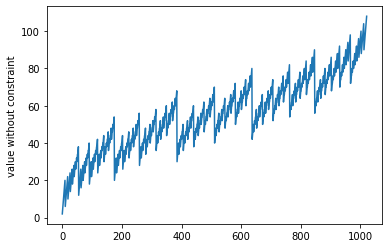

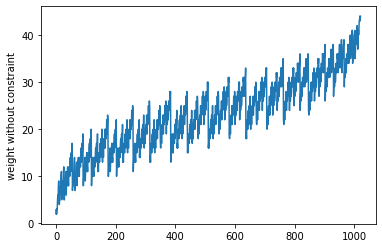

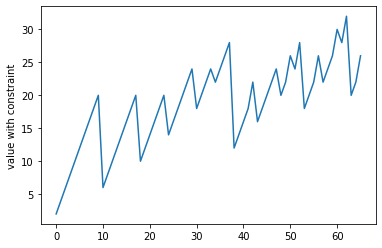

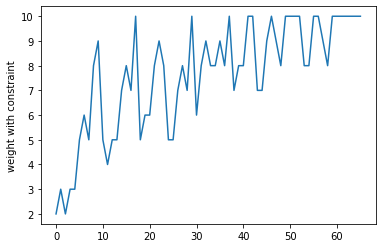

max value: 32 weight used: 10
items included: [2, 4, 7]


In [45]:
plot_knapsack(data_file_name,weight_capacity)

Build a QUBO for the knapsack problem

In [45]:
N=len(value)
Mv = np.zeros([N,N],dtype=float)
for i in range(N):
    Mv[i][i] =-value[i]
print(Mv)

[[ -2.   0.   0.   0.   0.   0.   0.   0.   0.   0.]
 [  0.  -4.   0.   0.   0.   0.   0.   0.   0.   0.]
 [  0.   0.  -6.   0.   0.   0.   0.   0.   0.   0.]
 [  0.   0.   0.  -8.   0.   0.   0.   0.   0.   0.]
 [  0.   0.   0.   0. -10.   0.   0.   0.   0.   0.]
 [  0.   0.   0.   0.   0. -12.   0.   0.   0.   0.]
 [  0.   0.   0.   0.   0.   0. -14.   0.   0.   0.]
 [  0.   0.   0.   0.   0.   0.   0. -16.   0.   0.]
 [  0.   0.   0.   0.   0.   0.   0.   0. -18.   0.]
 [  0.   0.   0.   0.   0.   0.   0.   0.   0. -20.]]


In [46]:
#ProbabilisticSampler(Q,plot_limit,offset=0, min_limit=0, max_limit=0):

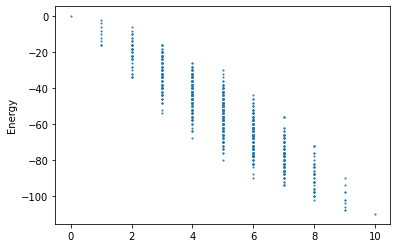

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
count: 10
Energy: -110.0
Solutions Sampled: 1024


([0, 1, 2, 3, 4, 5, 6, 7, 8, 9],
 -110.0,
 [1, 10, 45, 120, 210, 252, 210, 120, 45, 10, 1])

In [47]:
ProbabilisticSampler(Mv,1000)

In [48]:
N=len(value)
Mx = np.zeros([N,N],dtype=float)
for i in range(N):
    for j in range(N):
        if i==j:
            Mx[i][i] =weight[i]**2
        elif i<j:
            Mx[i][j]=2*weight[i]*weight[j]
print(Mx)

[[  4.  12.   8.  12.  12.  20.  24.  20.  32.  36.]
 [  0.   9.  12.  18.  18.  30.  36.  30.  48.  54.]
 [  0.   0.   4.  12.  12.  20.  24.  20.  32.  36.]
 [  0.   0.   0.   9.  18.  30.  36.  30.  48.  54.]
 [  0.   0.   0.   0.   9.  30.  36.  30.  48.  54.]
 [  0.   0.   0.   0.   0.  25.  60.  50.  80.  90.]
 [  0.   0.   0.   0.   0.   0.  36.  60.  96. 108.]
 [  0.   0.   0.   0.   0.   0.   0.  25.  80.  90.]
 [  0.   0.   0.   0.   0.   0.   0.   0.  64. 144.]
 [  0.   0.   0.   0.   0.   0.   0.   0.   0.  81.]]


In [49]:
wc=weight_capacity
Myc = np.zeros([wc,wc],dtype=float)
for i in range(wc):
    for j in range(wc):
        if i==j:
            Myc[i][i] =-1
        elif i<j:
            Myc[i][j]=2
print(Myc)
# offset = 1

[[-1.  2.  2.  2.  2.  2.  2.  2.  2.  2.]
 [ 0. -1.  2.  2.  2.  2.  2.  2.  2.  2.]
 [ 0.  0. -1.  2.  2.  2.  2.  2.  2.  2.]
 [ 0.  0.  0. -1.  2.  2.  2.  2.  2.  2.]
 [ 0.  0.  0.  0. -1.  2.  2.  2.  2.  2.]
 [ 0.  0.  0.  0.  0. -1.  2.  2.  2.  2.]
 [ 0.  0.  0.  0.  0.  0. -1.  2.  2.  2.]
 [ 0.  0.  0.  0.  0.  0.  0. -1.  2.  2.]
 [ 0.  0.  0.  0.  0.  0.  0.  0. -1.  2.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0. -1.]]


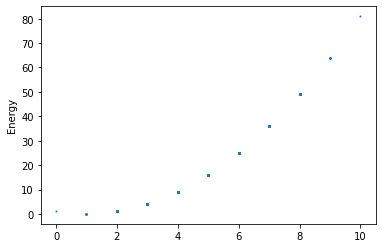

Best found: [7]
count: 1
Energy: 0.0
Solutions Sampled: 1024


([7], 0.0, [1, 10, 45, 120, 210, 252, 210, 120, 45, 10, 1])

In [50]:
ProbabilisticSampler(Myc,1000,1, 0,10)

In [51]:
wc=weight_capacity
My = np.zeros([wc,wc],dtype=float)
for n in range(1,wc+1):
    for m in range(1,wc+1):
        if n==m:
            My[n-1][m-1] =n**2
        elif n<m:
            My[n-1][m-1] =2*(n*m)  
print(My)


[[  1.   4.   6.   8.  10.  12.  14.  16.  18.  20.]
 [  0.   4.  12.  16.  20.  24.  28.  32.  36.  40.]
 [  0.   0.   9.  24.  30.  36.  42.  48.  54.  60.]
 [  0.   0.   0.  16.  40.  48.  56.  64.  72.  80.]
 [  0.   0.   0.   0.  25.  60.  70.  80.  90. 100.]
 [  0.   0.   0.   0.   0.  36.  84.  96. 108. 120.]
 [  0.   0.   0.   0.   0.   0.  49. 112. 126. 140.]
 [  0.   0.   0.   0.   0.   0.   0.  64. 144. 160.]
 [  0.   0.   0.   0.   0.   0.   0.   0.  81. 180.]
 [  0.   0.   0.   0.   0.   0.   0.   0.   0. 100.]]


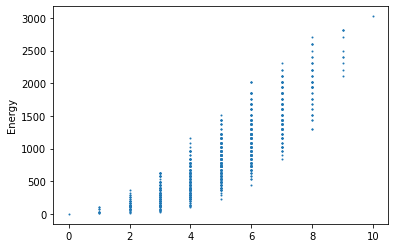

Best found: []
count: 0
Energy: 0
Solutions Sampled: 1024


([], 0, [1, 10, 45, 120, 210, 252, 210, 120, 45, 10, 1])

In [52]:
ProbabilisticSampler(My,1000)

In [53]:
wc=weight_capacity
Mxy = np.zeros([N,wc],dtype=float)
for i in range(N):
    for n in range(1,wc+1):

            Mxy[i][n-1] =-2*weight[i]*n
print(Mxy)


[[  -4.   -8.  -12.  -16.  -20.  -24.  -28.  -32.  -36.  -40.]
 [  -6.  -12.  -18.  -24.  -30.  -36.  -42.  -48.  -54.  -60.]
 [  -4.   -8.  -12.  -16.  -20.  -24.  -28.  -32.  -36.  -40.]
 [  -6.  -12.  -18.  -24.  -30.  -36.  -42.  -48.  -54.  -60.]
 [  -6.  -12.  -18.  -24.  -30.  -36.  -42.  -48.  -54.  -60.]
 [ -10.  -20.  -30.  -40.  -50.  -60.  -70.  -80.  -90. -100.]
 [ -12.  -24.  -36.  -48.  -60.  -72.  -84.  -96. -108. -120.]
 [ -10.  -20.  -30.  -40.  -50.  -60.  -70.  -80.  -90. -100.]
 [ -16.  -32.  -48.  -64.  -80.  -96. -112. -128. -144. -160.]
 [ -18.  -36.  -54.  -72.  -90. -108. -126. -144. -162. -180.]]


Run on probabilitic solver with multipliers equal to 1.

In [54]:
A=1 #ensure only one weight is selected
B=1 # ensure weight matches total weight
C=1   # ensure correct items are selected

Mxf=C*np.array(Mv)+B*np.array(Mx)
print('Mxf',np.shape(Mxf))
Myf=A*np.array(Myc)+B*np.array(My)
print('Myf',np.shape(Myf))
MxyMyf=np.append(B*Mxy, Myf , axis=0) 
print('MxyMyf',np.shape(MxyMyf))
Mxzeros=np.zeros([wc,N],dtype=float)
print('Mxzeros',np.shape(Mxzeros))
Mxflarge=np.append(Mxf, Mxzeros, axis=0)
print('Mxflarge',np.shape(Mxflarge))
Mf=np.append(Mxflarge,MxyMyf, axis=1)
print('Mf',np.shape(Mf))
print(Mf)
np.savetxt('Mf.csv', Mf, delimiter=',')

Mxf (10, 10)
Myf (10, 10)
MxyMyf (20, 10)
Mxzeros (10, 10)
Mxflarge (20, 10)
Mf (20, 20)
[[   2.   12.    8.   12.   12.   20.   24.   20.   32.   36.   -4.   -8.
   -12.  -16.  -20.  -24.  -28.  -32.  -36.  -40.]
 [   0.    5.   12.   18.   18.   30.   36.   30.   48.   54.   -6.  -12.
   -18.  -24.  -30.  -36.  -42.  -48.  -54.  -60.]
 [   0.    0.   -2.   12.   12.   20.   24.   20.   32.   36.   -4.   -8.
   -12.  -16.  -20.  -24.  -28.  -32.  -36.  -40.]
 [   0.    0.    0.    1.   18.   30.   36.   30.   48.   54.   -6.  -12.
   -18.  -24.  -30.  -36.  -42.  -48.  -54.  -60.]
 [   0.    0.    0.    0.   -1.   30.   36.   30.   48.   54.   -6.  -12.
   -18.  -24.  -30.  -36.  -42.  -48.  -54.  -60.]
 [   0.    0.    0.    0.    0.   13.   60.   50.   80.   90.  -10.  -20.
   -30.  -40.  -50.  -60.  -70.  -80.  -90. -100.]
 [   0.    0.    0.    0.    0.    0.   22.   60.   96.  108.  -12.  -24.
   -36.  -48.  -60.  -72.  -84.  -96. -108. -120.]
 [   0.    0.    0.    0.    0.    0

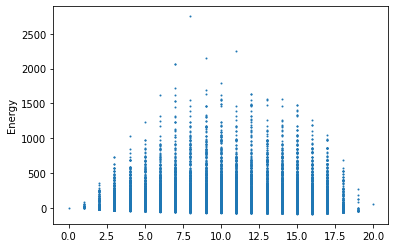

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


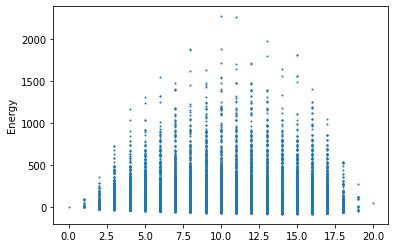

Best found: [1, 2, 3, 4, 6, 7, 8, 9, 14, 15, 17, 18, 19]
count: 13
Energy: -80.0
Solutions Sampled: 15422
[1, 2, 3, 4, 6, 7, 8, 9, 14, 15, 17, 18, 19] -80.0
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 8, 9]
Total value: 96
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 8, 9, 10]


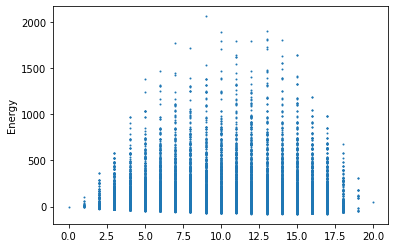

Best found: [0, 1, 3, 4, 5, 6, 7, 8, 9, 12, 15, 16, 17, 18, 19]
count: 15
Energy: -79.0
Solutions Sampled: 15422
[0, 1, 3, 4, 5, 6, 7, 8, 9, 12, 15, 16, 17, 18, 19] -79.0
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 8, 9]
Total value: 104
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 7, 8, 9, 10]


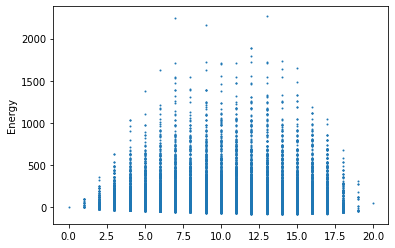

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 16, 17, 18, 19]
count: 12
Energy: -79.0
Solutions Sampled: 15422
[1, 2, 3, 4, 5, 6, 7, 8, 16, 17, 18, 19] -79.0
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8]
Total value: 88
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 8, 9, 10]


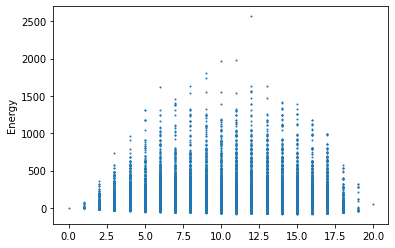

Best found: [2, 3, 4, 5, 7, 8, 9, 16, 17, 18, 19]
count: 11
Energy: -81.0
Solutions Sampled: 15422
[2, 3, 4, 5, 7, 8, 9, 16, 17, 18, 19] -81.0
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 5, 7, 8, 9]
Total value: 90
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 8, 9, 10]


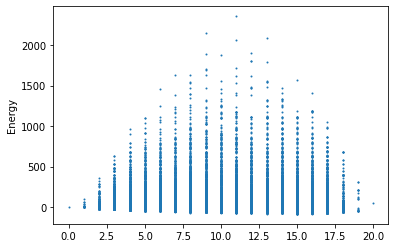

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 15
Energy: -83.0
Solutions Sampled: 15422
[1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -83.0
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 108
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


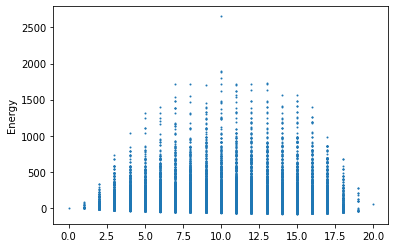

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19]
count: 15
Energy: -84.0
Solutions Sampled: 15422
[1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19] -84.0
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 108
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7, 8, 9, 10]


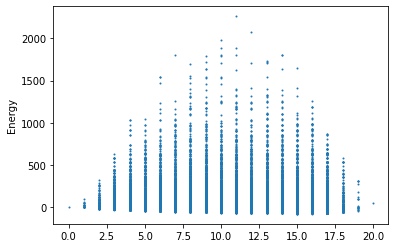

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19]
count: 16
Energy: -82.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19] -82.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7, 8, 9, 10]


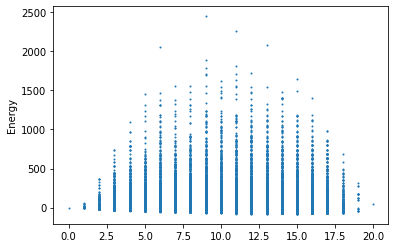

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19]
count: 15
Energy: -80.0
Solutions Sampled: 15422
[1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19] -80.0
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 108
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7, 8, 9, 10]


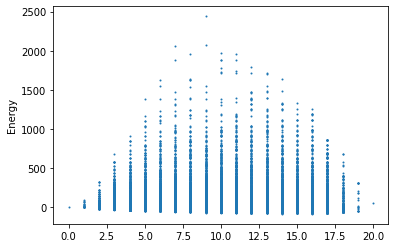

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


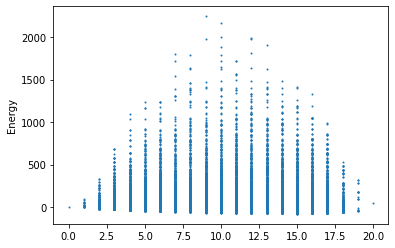

Best found: [0, 2, 3, 4, 5, 6, 7, 8, 9, 13, 14, 15, 17, 18, 19]
count: 15
Energy: -81.0
Solutions Sampled: 15422
[0, 2, 3, 4, 5, 6, 7, 8, 9, 13, 14, 15, 17, 18, 19] -81.0
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 8, 9, 10]


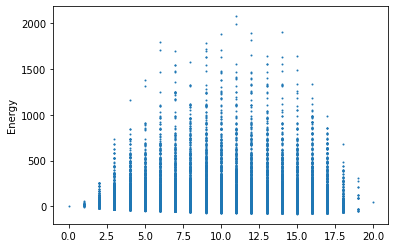

Best found: [0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 15, 16, 17, 18, 19]
count: 15
Energy: -81.0
Solutions Sampled: 15422
[0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 15, 16, 17, 18, 19] -81.0
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 6, 7, 8, 9, 10]


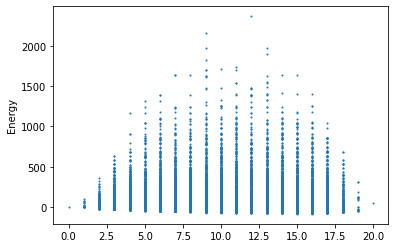

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


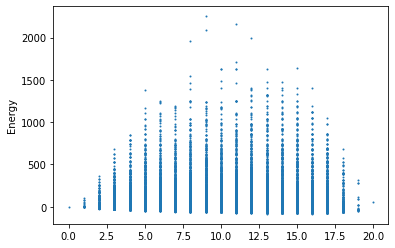

Best found: [2, 3, 4, 5, 6, 7, 8, 9, 14, 16, 17, 18, 19]
count: 13
Energy: -85.0
Solutions Sampled: 15422
[2, 3, 4, 5, 6, 7, 8, 9, 14, 16, 17, 18, 19] -85.0
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 7, 8, 9]
Total value: 104
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7, 8, 9, 10]


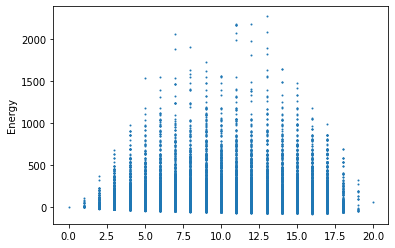

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


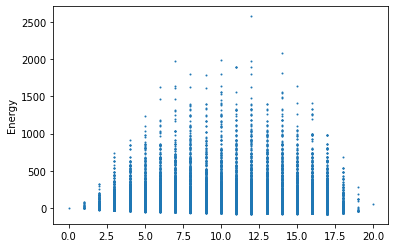

Best found: [1, 4, 5, 6, 7, 8, 9, 14, 16, 17, 18, 19]
count: 12
Energy: -79.0
Solutions Sampled: 15422
[1, 4, 5, 6, 7, 8, 9, 14, 16, 17, 18, 19] -79.0
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 4, 5, 6, 7, 8, 9]
Total value: 94
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7, 8, 9, 10]


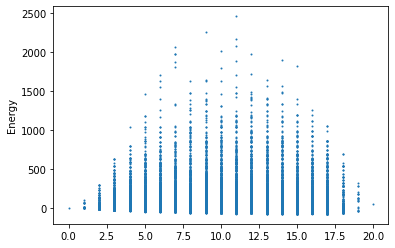

Best found: [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 16, 17, 18, 19]
count: 15
Energy: -78.0
Solutions Sampled: 15422
[0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 16, 17, 18, 19] -78.0
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 7, 8, 9, 10]


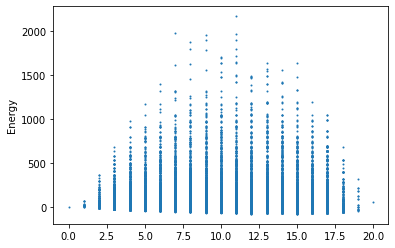

Best found: [3, 4, 5, 6, 7, 8, 9, 13, 16, 17, 18, 19]
count: 12
Energy: -82.0
Solutions Sampled: 15422
[3, 4, 5, 6, 7, 8, 9, 13, 16, 17, 18, 19] -82.0
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 4, 5, 6, 7, 8, 9]
Total value: 98
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 8, 9, 10]


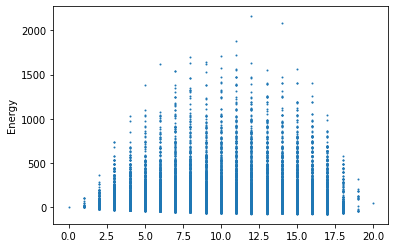

Best found: [0, 1, 3, 5, 6, 7, 8, 9, 15, 16, 17, 18, 19]
count: 13
Energy: -78.0
Solutions Sampled: 15422
[0, 1, 3, 5, 6, 7, 8, 9, 15, 16, 17, 18, 19] -78.0
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 5, 6, 7, 8, 9]
Total value: 94
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7, 8, 9, 10]


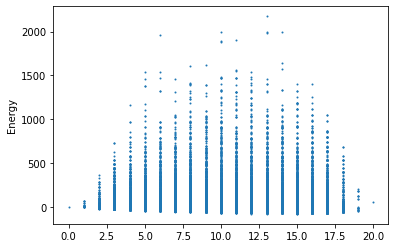

Best found: [0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 15, 16, 17, 18, 19]
count: 15
Energy: -81.0
Solutions Sampled: 15422
[0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 15, 16, 17, 18, 19] -81.0
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 6, 7, 8, 9, 10]


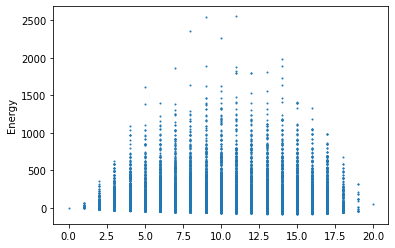

Best found: [0, 2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19]
count: 15
Energy: -81.0
Solutions Sampled: 15422
[0, 2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19] -81.0
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7, 8, 9, 10]


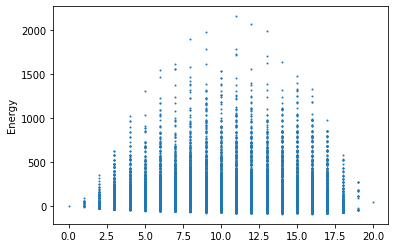

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


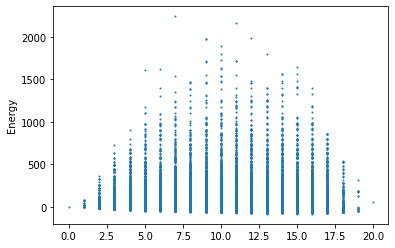

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


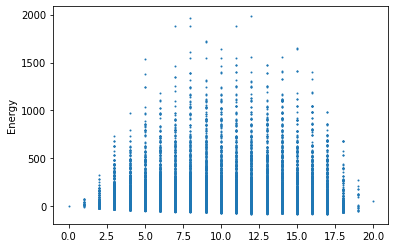

Best found: [0, 1, 3, 4, 5, 6, 7, 8, 9, 12, 15, 16, 17, 18, 19]
count: 15
Energy: -79.0
Solutions Sampled: 15422
[0, 1, 3, 4, 5, 6, 7, 8, 9, 12, 15, 16, 17, 18, 19] -79.0
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 8, 9]
Total value: 104
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 7, 8, 9, 10]


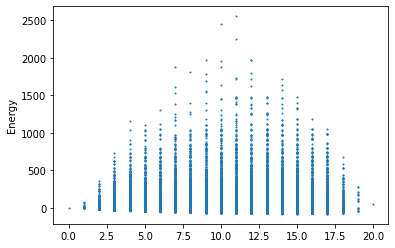

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 15, 16, 17, 18, 19]
count: 15
Energy: -80.0
Solutions Sampled: 15422
[1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 15, 16, 17, 18, 19] -80.0
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 108
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 6, 7, 8, 9, 10]


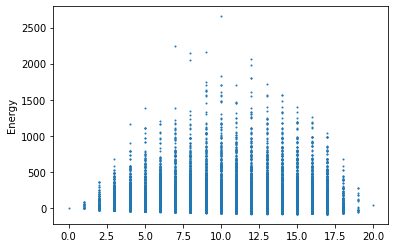

Best found: [0, 1, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 15
Energy: -79.0
Solutions Sampled: 15422
[0, 1, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -79.0
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 8, 9]
Total value: 104
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


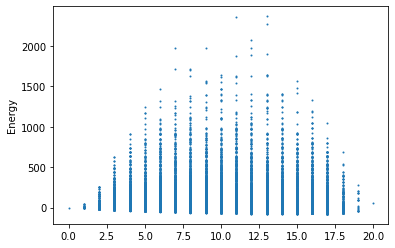

Best found: [1, 3, 4, 5, 6, 7, 8, 9, 13, 14, 15, 17, 18, 19]
count: 14
Energy: -78.0
Solutions Sampled: 15422
[1, 3, 4, 5, 6, 7, 8, 9, 13, 14, 15, 17, 18, 19] -78.0
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 3, 4, 5, 6, 7, 8, 9]
Total value: 102
Total weight: 42
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 8, 9, 10]


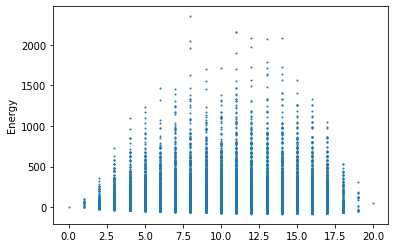

Best found: [3, 4, 5, 6, 7, 8, 9, 13, 16, 17, 18, 19]
count: 12
Energy: -82.0
Solutions Sampled: 15422
[3, 4, 5, 6, 7, 8, 9, 13, 16, 17, 18, 19] -82.0
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 4, 5, 6, 7, 8, 9]
Total value: 98
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 8, 9, 10]


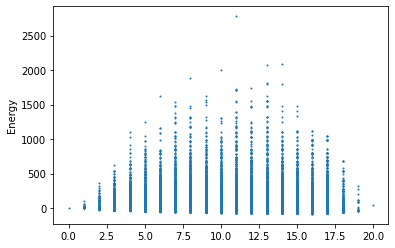

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


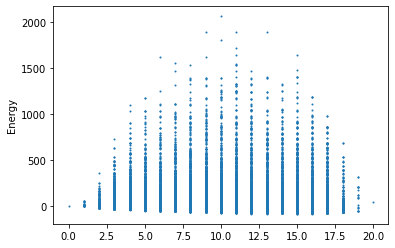

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19]
count: 16
Energy: -82.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19] -82.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7, 8, 9, 10]


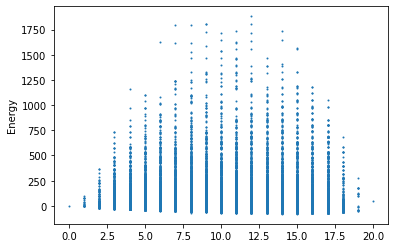

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19]
count: 15
Energy: -80.0
Solutions Sampled: 15422
[1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19] -80.0
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 108
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7, 8, 9, 10]


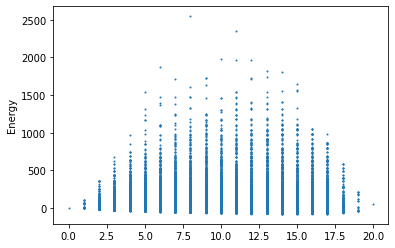

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19]
count: 15
Energy: -80.0
Solutions Sampled: 15422
[1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19] -80.0
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 108
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7, 8, 9, 10]


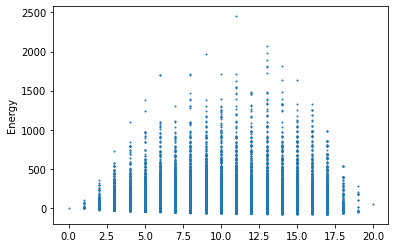

Best found: [0, 1, 2, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19]
count: 15
Energy: -77.0
Solutions Sampled: 15422
[0, 1, 2, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19] -77.0
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8, 9]
Total value: 102
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7, 8, 9, 10]


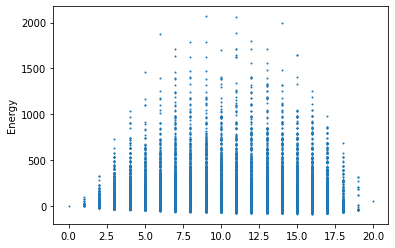

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


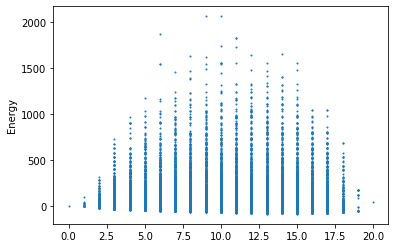

Best found: [0, 2, 3, 4, 5, 6, 7, 8, 9, 13, 14, 16, 17, 18, 19]
count: 15
Energy: -82.0
Solutions Sampled: 15422
[0, 2, 3, 4, 5, 6, 7, 8, 9, 13, 14, 16, 17, 18, 19] -82.0
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 8, 9, 10]


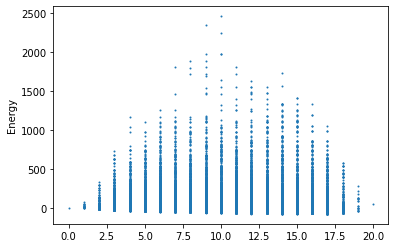

Best found: [2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 15, 17, 18, 19]
count: 14
Energy: -79.0
Solutions Sampled: 15422
[2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 15, 17, 18, 19] -79.0
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 7, 8, 9]
Total value: 104
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6, 8, 9, 10]


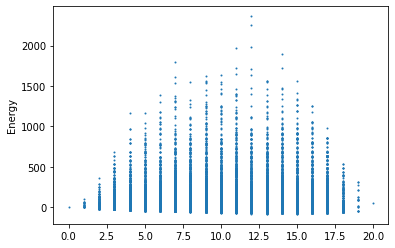

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 15
Energy: -83.0
Solutions Sampled: 15422
[1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -83.0
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 108
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


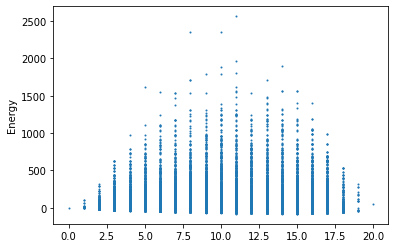

Best found: [0, 2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19]
count: 15
Energy: -81.0
Solutions Sampled: 15422
[0, 2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 17, 18, 19] -81.0
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7, 8, 9, 10]


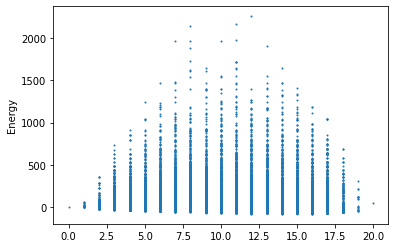

Best found: [0, 2, 3, 4, 5, 6, 7, 8, 9, 13, 14, 15, 17, 18, 19]
count: 15
Energy: -81.0
Solutions Sampled: 15422
[0, 2, 3, 4, 5, 6, 7, 8, 9, 13, 14, 15, 17, 18, 19] -81.0
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 8, 9, 10]


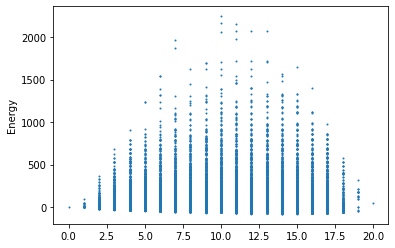

Best found: [0, 1, 2, 3, 4, 6, 7, 8, 9, 15, 16, 17, 18, 19]
count: 14
Energy: -82.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 6, 7, 8, 9, 15, 16, 17, 18, 19] -82.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 8, 9]
Total value: 98
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7, 8, 9, 10]


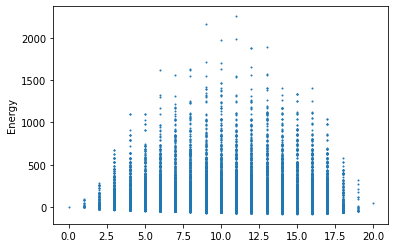

Best found: [0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 15, 16, 17, 18, 19]
count: 15
Energy: -81.0
Solutions Sampled: 15422
[0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 15, 16, 17, 18, 19] -81.0
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 6, 7, 8, 9, 10]


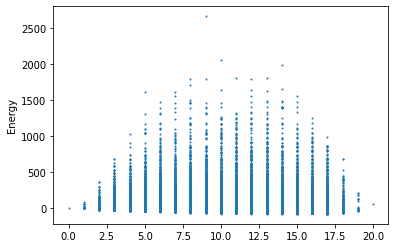

Best found: [2, 4, 5, 6, 7, 8, 9, 12, 16, 17, 18, 19]
count: 12
Energy: -80.0
Solutions Sampled: 15422
[2, 4, 5, 6, 7, 8, 9, 12, 16, 17, 18, 19] -80.0
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 4, 5, 6, 7, 8, 9]
Total value: 96
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 8, 9, 10]


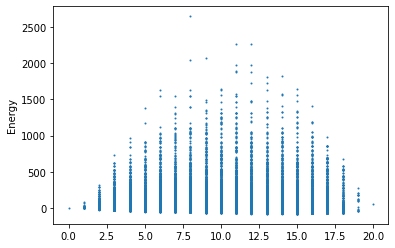

Best found: [0, 3, 4, 5, 6, 7, 8, 9, 14, 16, 17, 18, 19]
count: 13
Energy: -81.0
Solutions Sampled: 15422
[0, 3, 4, 5, 6, 7, 8, 9, 14, 16, 17, 18, 19] -81.0
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 3, 4, 5, 6, 7, 8, 9]
Total value: 100
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7, 8, 9, 10]


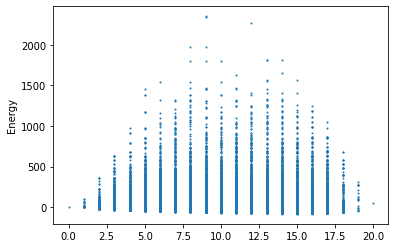

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19]
count: 16
Energy: -82.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19] -82.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7, 8, 9, 10]


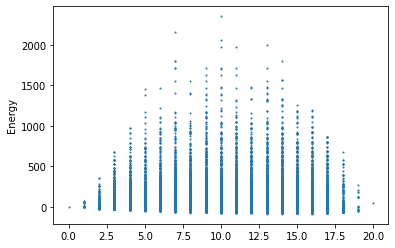

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


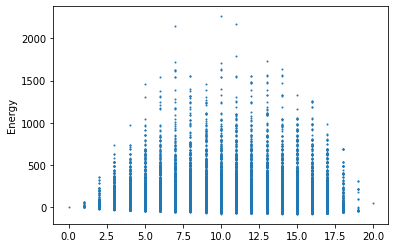

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19]
count: 16
Energy: -82.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 15, 16, 17, 18, 19] -82.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7, 8, 9, 10]


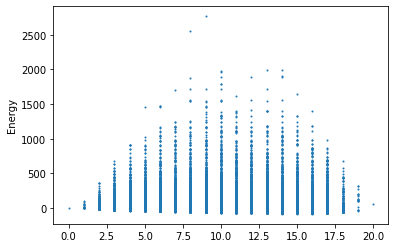

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


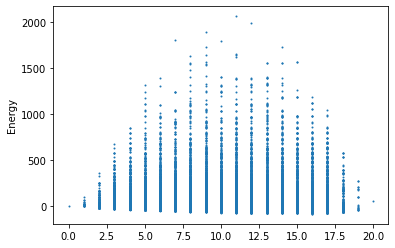

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]
count: 16
Energy: -85.0
Solutions Sampled: 15422
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19] -85.0
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 7, 8, 9, 10]


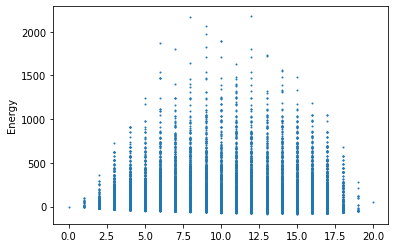

Best found: [1, 2, 4, 5, 6, 7, 8, 9, 15, 16, 17, 18, 19]
count: 13
Energy: -84.0
Solutions Sampled: 15422
[1, 2, 4, 5, 6, 7, 8, 9, 15, 16, 17, 18, 19] -84.0
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 5, 6, 7, 8, 9]
Total value: 100
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7, 8, 9, 10]


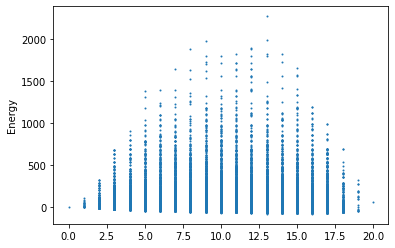

Best found: [2, 3, 4, 5, 6, 7, 8, 9, 14, 16, 17, 18, 19]
count: 13
Energy: -85.0
Solutions Sampled: 15422
[2, 3, 4, 5, 6, 7, 8, 9, 14, 16, 17, 18, 19] -85.0
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 7, 8, 9]
Total value: 104
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7, 8, 9, 10]
-------FAIL!------------
No good values found
Condition 1: One weight condition failed 100.0 %
Condition 2: Weight match condition failed 0.0 %


In [55]:
cond1_fail=0
cond2_fail=0
good_solution=[]
good_value=[]
good_weight=[]
good_energy=[]
count=50
for trial in range (count):

    solution=ProbabilisticSampler(Mf,1000)
    print(solution[0],solution[1])

    # check if constraints were met
    item_list=[]
    Vt=0
    Wt=0
    for i in solution[0]:
        if i <N:
            Vt+=value[i]
            Wt+=weight[i]
            print(i, value[i], weight[i])
            item_list.append(i)
    print('Items added to Knapsack',item_list)
    print('Total value:',Vt)
    print('Total weight:',Wt)

    check_y=0
    weight_list=[]
    for i in solution[0]:
        if i>=N:
            check_y+=1
            weight_list.append(i-N+1)
    print('Condition 1 - Only one weight should be selected.')
    if check_y>1:
        print('FAIL: One weight condition not met', weight_list)
        cond1_fail+=1

    else:
        print('OK: condition met', weight_list)
        print('Condition 2 - Total weight should be equal to weight selected')
        if Wt==weight_list[0]:
            print('OK: Condition met', Wt)
            good_solution.append(item_list)
            good_value.append(Vt)
            good_weight.append(Wt)
            good_energy.append(solution[1])
            
        else:
            print('FAIL: Weight match condition not met', Wt, weight_list[0])
            cond2_fail+=1

good_count=len(good_value)
if good_count==0:
    print('-------FAIL!------------')
    print('No good values found')
    print('Condition 1: One weight condition failed',(cond1_fail/count)*100, '%')
    print('Condition 2: Weight match condition failed',(cond2_fail/count)*100, '%')
else:
    print('-------Success!------------')
    for i in range(good_count):
        
        print(i, good_solution[i], 'Value', good_value[i],'Wt', good_weight[i], 'energy', good_energy[i])



Run on probabilitic solver with optimizes multipliers

In [57]:
A=400 #ensure only one weight is selected
B=2 # ensure weight matches total weight
C=1   # ensure correct items are selected

Mxf=C*np.array(Mv)+B*np.array(Mx)
print('Mxf',np.shape(Mxf))
Myf=A*np.array(Myc)+B*np.array(My)
print('Myf',np.shape(Myf))
MxyMyf=np.append(B*Mxy, Myf , axis=0) 
print('MxyMyf',np.shape(MxyMyf))
Mxzeros=np.zeros([wc,N],dtype=float)
print('Mxzeros',np.shape(Mxzeros))
Mxflarge=np.append(Mxf, Mxzeros, axis=0)
print('Mxflarge',np.shape(Mxflarge))
Mf=np.append(Mxflarge,MxyMyf, axis=1)
print('Mf',np.shape(Mf))
print(Mf)
np.savetxt('Mf.csv', Mf, delimiter=',')

Mxf (10, 10)
Myf (10, 10)
MxyMyf (20, 10)
Mxzeros (10, 10)
Mxflarge (20, 10)
Mf (20, 20)
[[   6.   24.   16.   24.   24.   40.   48.   40.   64.   72.   -8.  -16.
   -24.  -32.  -40.  -48.  -56.  -64.  -72.  -80.]
 [   0.   14.   24.   36.   36.   60.   72.   60.   96.  108.  -12.  -24.
   -36.  -48.  -60.  -72.  -84.  -96. -108. -120.]
 [   0.    0.    2.   24.   24.   40.   48.   40.   64.   72.   -8.  -16.
   -24.  -32.  -40.  -48.  -56.  -64.  -72.  -80.]
 [   0.    0.    0.   10.   36.   60.   72.   60.   96.  108.  -12.  -24.
   -36.  -48.  -60.  -72.  -84.  -96. -108. -120.]
 [   0.    0.    0.    0.    8.   60.   72.   60.   96.  108.  -12.  -24.
   -36.  -48.  -60.  -72.  -84.  -96. -108. -120.]
 [   0.    0.    0.    0.    0.   38.  120.  100.  160.  180.  -20.  -40.
   -60.  -80. -100. -120. -140. -160. -180. -200.]
 [   0.    0.    0.    0.    0.    0.   58.  120.  192.  216.  -24.  -48.
   -72.  -96. -120. -144. -168. -192. -216. -240.]
 [   0.    0.    0.    0.    0.    0

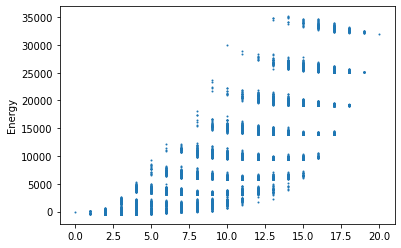

Best found: [2, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[2, 4, 7, 19] -432.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


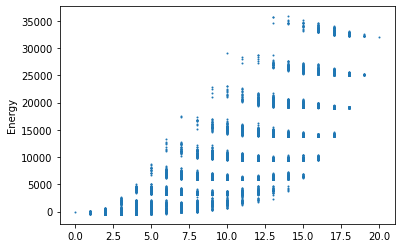

Best found: [2, 4, 7, 18]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 4, 7, 18] -430.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9


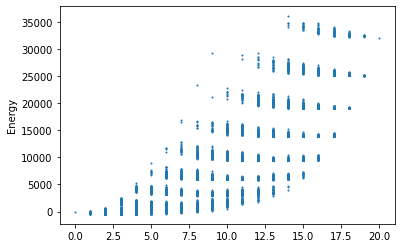

Best found: [2, 4, 7, 18]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 4, 7, 18] -430.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9


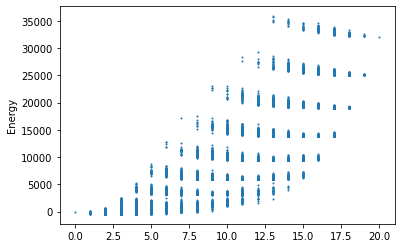

Best found: [2, 4, 7, 18]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 4, 7, 18] -430.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9


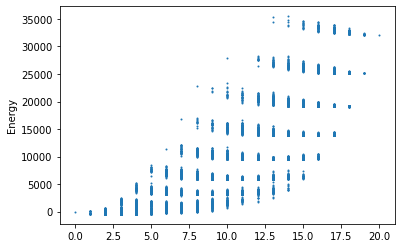

Best found: [3, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[3, 4, 7, 19] -432.0
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


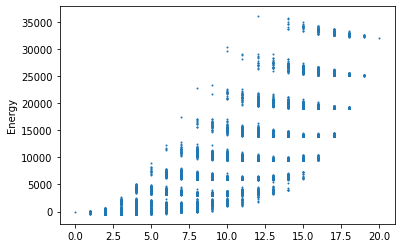

Best found: [2, 4, 7, 18]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 4, 7, 18] -430.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9


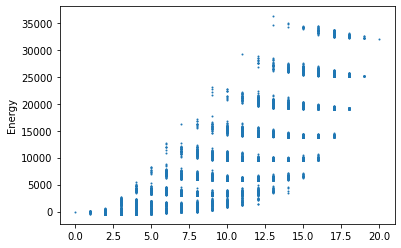

Best found: [5, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[5, 7, 19] -428.0
5 12 5
7 16 5
Items added to Knapsack [5, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


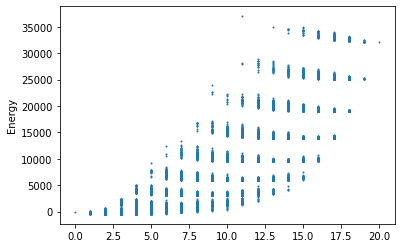

Best found: [6, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[6, 7, 19] -428.0
6 14 6
7 16 5
Items added to Knapsack [6, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


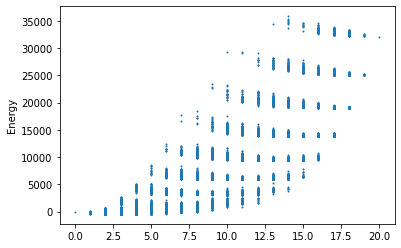

Best found: [2, 3, 7, 19]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 3, 7, 19] -430.0
2 6 2
3 8 3
7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


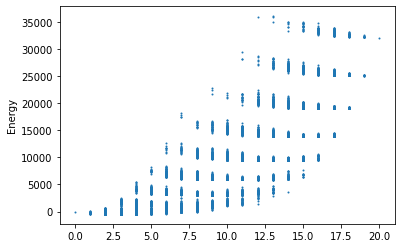

Best found: [5, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[5, 7, 19] -428.0
5 12 5
7 16 5
Items added to Knapsack [5, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


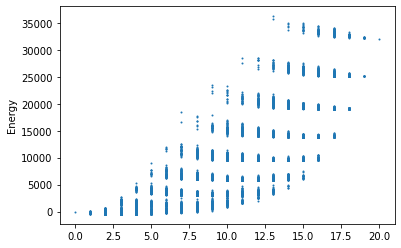

Best found: [3, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[3, 4, 7, 19] -432.0
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


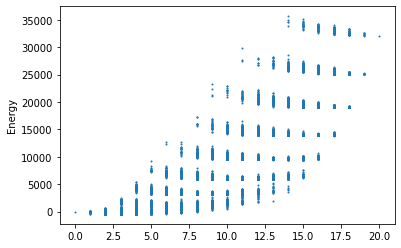

Best found: [5, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[5, 7, 19] -428.0
5 12 5
7 16 5
Items added to Knapsack [5, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


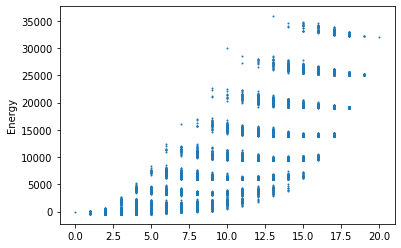

Best found: [2, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[2, 4, 7, 19] -432.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


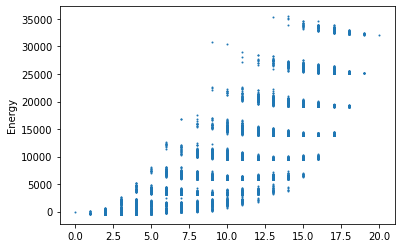

Best found: [5, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[5, 7, 19] -428.0
5 12 5
7 16 5
Items added to Knapsack [5, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


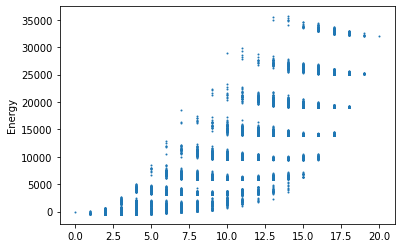

Best found: [6, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[6, 7, 19] -428.0
6 14 6
7 16 5
Items added to Knapsack [6, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


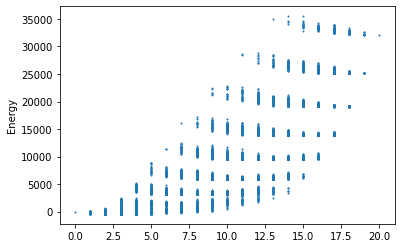

Best found: [2, 3, 7, 19]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 3, 7, 19] -430.0
2 6 2
3 8 3
7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


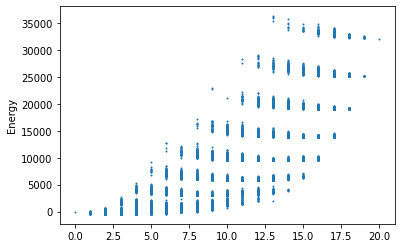

Best found: [4, 7, 17]
count: 3
Energy: -426.0
Solutions Sampled: 15422
[4, 7, 17] -426.0
4 10 3
7 16 5
Items added to Knapsack [4, 7]
Total value: 26
Total weight: 8
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 8


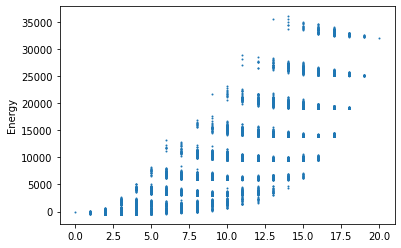

Best found: [5, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[5, 7, 19] -428.0
5 12 5
7 16 5
Items added to Knapsack [5, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


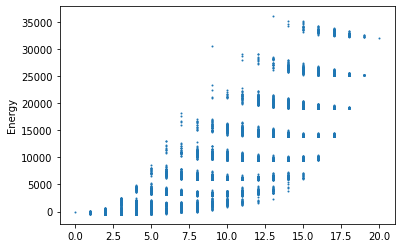

Best found: [3, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[3, 4, 7, 19] -432.0
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


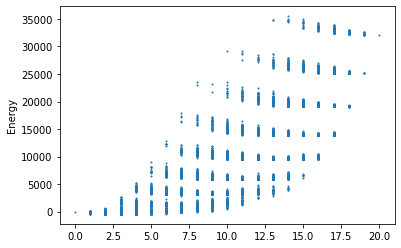

Best found: [2, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[2, 4, 7, 19] -432.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


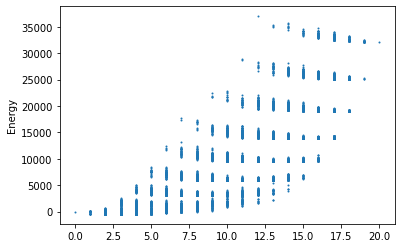

Best found: [2, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[2, 4, 7, 19] -432.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


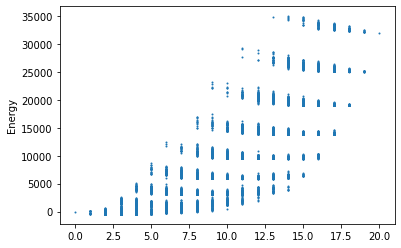

Best found: [6, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[6, 7, 19] -428.0
6 14 6
7 16 5
Items added to Knapsack [6, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


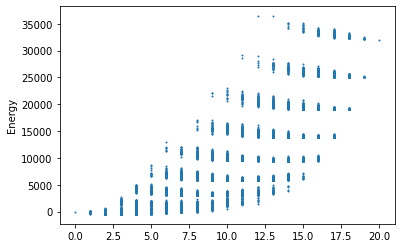

Best found: [2, 3, 7, 18]
count: 4
Energy: -428.0
Solutions Sampled: 15422
[2, 3, 7, 18] -428.0
2 6 2
3 8 3
7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9


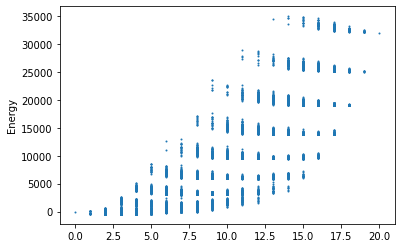

Best found: [5, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[5, 7, 19] -428.0
5 12 5
7 16 5
Items added to Knapsack [5, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


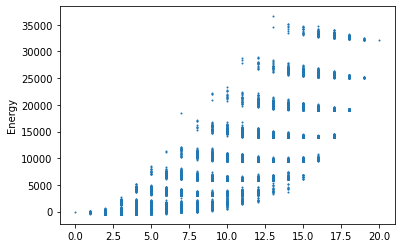

Best found: [2, 3, 7, 19]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 3, 7, 19] -430.0
2 6 2
3 8 3
7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


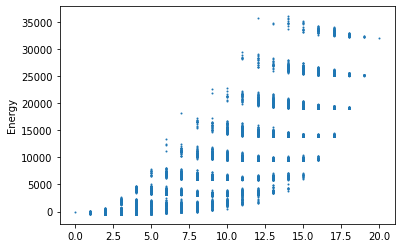

Best found: [5, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[5, 7, 19] -428.0
5 12 5
7 16 5
Items added to Knapsack [5, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


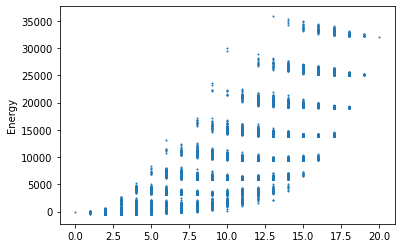

Best found: [5, 7, 18]
count: 3
Energy: -426.0
Solutions Sampled: 15422
[5, 7, 18] -426.0
5 12 5
7 16 5
Items added to Knapsack [5, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9


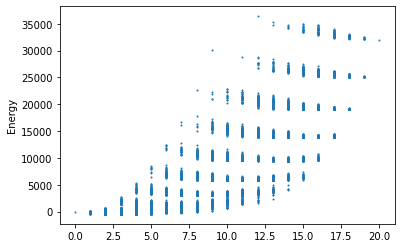

Best found: [2, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[2, 4, 7, 19] -432.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


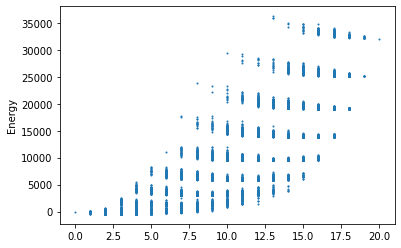

Best found: [5, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[5, 7, 19] -428.0
5 12 5
7 16 5
Items added to Knapsack [5, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


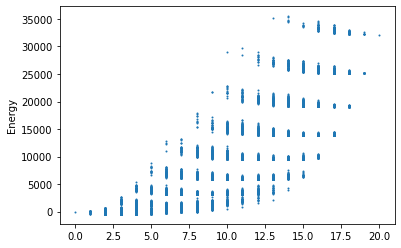

Best found: [3, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[3, 4, 7, 19] -432.0
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


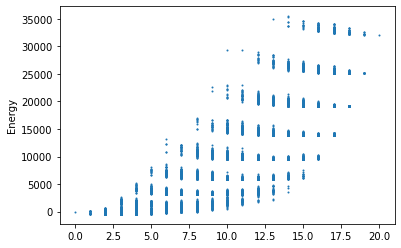

Best found: [3, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[3, 4, 7, 19] -432.0
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


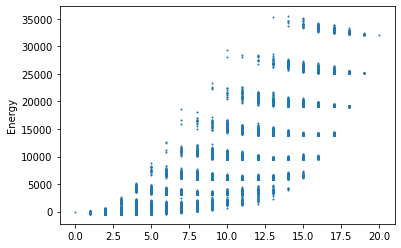

Best found: [3, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[3, 4, 7, 19] -432.0
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


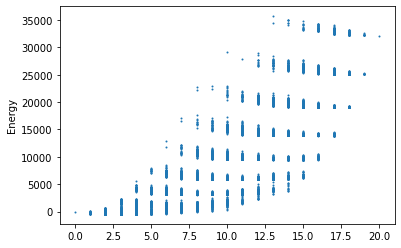

Best found: [2, 4, 6, 19]
count: 4
Energy: -428.0
Solutions Sampled: 15422
[2, 4, 6, 19] -428.0
2 6 2
4 10 3
6 14 6
Items added to Knapsack [2, 4, 6]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


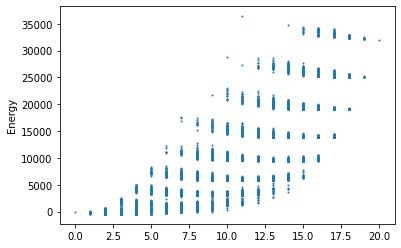

Best found: [2, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[2, 4, 7, 19] -432.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


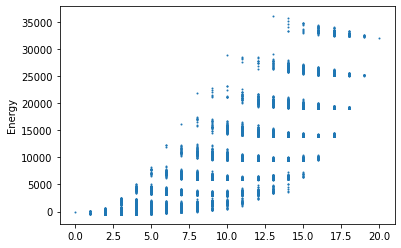

Best found: [3, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[3, 4, 7, 19] -432.0
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


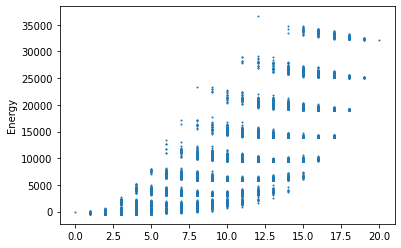

Best found: [2, 3, 7, 19]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 3, 7, 19] -430.0
2 6 2
3 8 3
7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


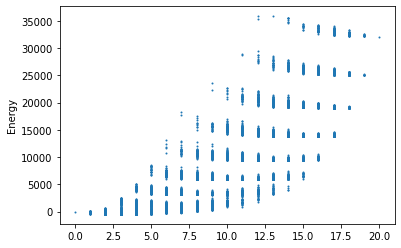

Best found: [2, 3, 7, 19]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 3, 7, 19] -430.0
2 6 2
3 8 3
7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


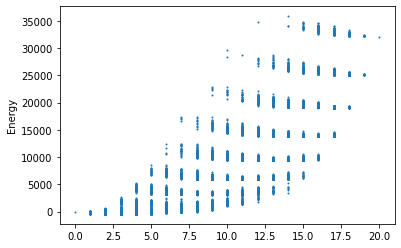

Best found: [2, 4, 7, 18]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 4, 7, 18] -430.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9


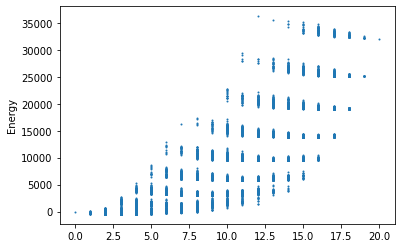

Best found: [2, 4, 7, 18]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 4, 7, 18] -430.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9


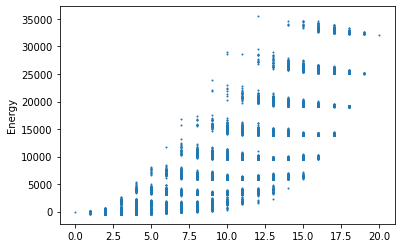

Best found: [2, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[2, 4, 7, 19] -432.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


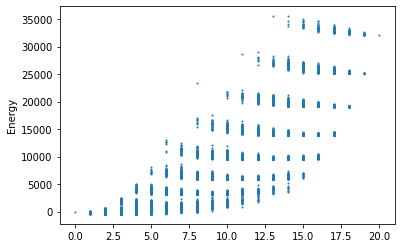

Best found: [2, 4, 7, 18]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 4, 7, 18] -430.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9


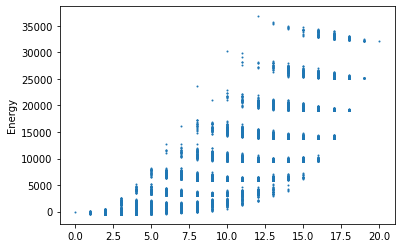

Best found: [2, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[2, 4, 7, 19] -432.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


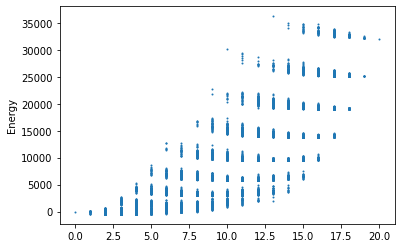

Best found: [6, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[6, 7, 19] -428.0
6 14 6
7 16 5
Items added to Knapsack [6, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


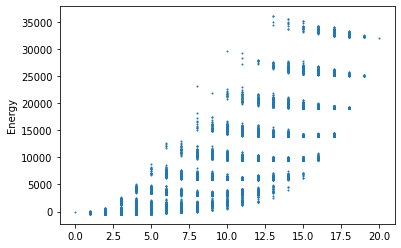

Best found: [6, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[6, 7, 19] -428.0
6 14 6
7 16 5
Items added to Knapsack [6, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


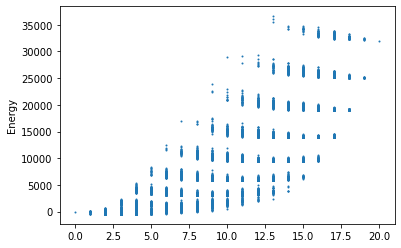

Best found: [2, 4, 7, 18]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 4, 7, 18] -430.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9


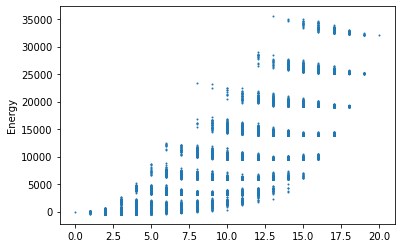

Best found: [2, 3, 7, 19]
count: 4
Energy: -430.0
Solutions Sampled: 15422
[2, 3, 7, 19] -430.0
2 6 2
3 8 3
7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


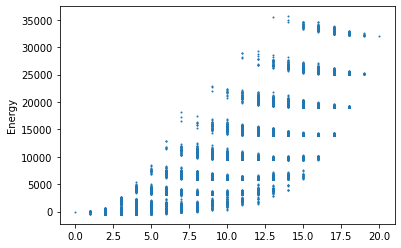

Best found: [3, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[3, 4, 7, 19] -432.0
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


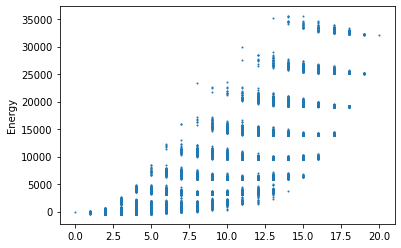

Best found: [4, 8, 19]
count: 3
Energy: -426.0
Solutions Sampled: 15422
[4, 8, 19] -426.0
4 10 3
8 18 8
Items added to Knapsack [4, 8]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10


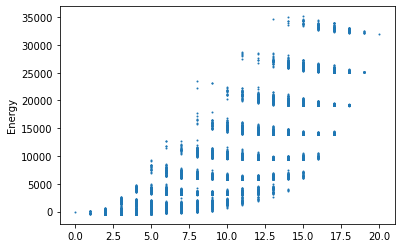

Best found: [2, 4, 7, 19]
count: 4
Energy: -432.0
Solutions Sampled: 15422
[2, 4, 7, 19] -432.0
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10


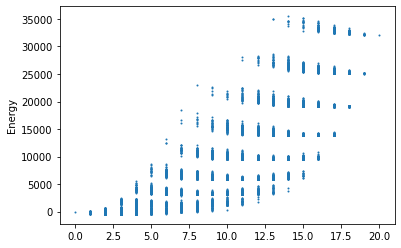

Best found: [5, 7, 19]
count: 3
Energy: -428.0
Solutions Sampled: 15422
[5, 7, 19] -428.0
5 12 5
7 16 5
Items added to Knapsack [5, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10
-------Success!------------
0 [2, 4, 7] Value 32 Wt 10 energy -432.0
1 [5, 7] Value 28 Wt 10 energy -428.0
2 [2, 3, 7] Value 30 Wt 10 energy -430.0
3 [5, 7] Value 28 Wt 10 energy -428.0
4 [5, 7] Value 28 Wt 10 energy -428.0
5 [2, 4, 7] Value 32 Wt 10 energy -432.0
6 [5, 7] Value 28 Wt 10 energy -428.0
7 [2, 3, 7] Value 30 Wt 10 energy -430.0
8 [4, 7] Value 26 Wt 8 energy -426.0
9 [5, 7] Value 28 Wt 10 energy -428.0
10 [2, 4, 7] Value 32 Wt 10 energy -432.0
11 [2, 4, 7] Value 32 Wt 10 energy -432.0
12 [5, 7] Value 28 Wt 10 energy -428.0
13 [2, 3, 7] Value 30 Wt 10 energy -430.0
14 [5, 7] Value 28 Wt 10 energy -428.0
15 [2, 4, 7] Value 32 Wt 10 energy -432.0
16 [5, 7] V

In [58]:
cond1_fail=0
cond2_fail=0
good_solution=[]
good_value=[]
good_weight=[]
good_energy=[]
count=50
for trial in range (count):

    solution=ProbabilisticSampler(Mf,1000)
    print(solution[0],solution[1])

    # check if constraints were met
    item_list=[]
    Vt=0
    Wt=0
    for i in solution[0]:
        if i <N:
            Vt+=value[i]
            Wt+=weight[i]
            print(i, value[i], weight[i])
            item_list.append(i)
    print('Items added to Knapsack',item_list)
    print('Total value:',Vt)
    print('Total weight:',Wt)

    check_y=0
    weight_list=[]
    for i in solution[0]:
        if i>=N:
            check_y+=1
            weight_list.append(i-N+1)
    print('Condition 1 - Only one weight should be selected.')
    if check_y>1:
        print('FAIL: One weight condition not met', weight_list)
        cond1_fail+=1

    else:
        print('OK: condition met', weight_list)
        print('Condition 2 - Total weight should be equal to weight selected')
        if Wt==weight_list[0]:
            print('OK: Condition met', Wt)
            good_solution.append(item_list)
            good_value.append(Vt)
            good_weight.append(Wt)
            good_energy.append(solution[1])
            
        else:
            print('FAIL: Weight match condition not met', Wt, weight_list[0])
            cond2_fail+=1

good_count=len(good_value)
if good_count==0:
    print('-------FAIL!------------')
    print('No good values found')
    print('Condition 1: One weight condition failed',(cond1_fail/count)*100, '%')
    print('Condition 2: Weight match condition failed',(cond2_fail/count)*100, '%')
else:
    print('-------Success!------------')
    for i in range(good_count):
        
        print(i, good_solution[i], 'Value', good_value[i],'Wt', good_weight[i], 'energy', good_energy[i])



Run on D-Wave

In [68]:
# run on 2000Q
chain_strength = 1.2
response=run_dwave(Mf,chain_strength)

Number of qubits:  2048
Number of couplers 5974
Shots max 10,000
26214400
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 ... 19 energy num_oc. ...
1616  0  0  0  1  1  0  0  1  0  0  0  0  0  0  0  0 ...  1 -432.0       1 ...
1686  0  0  0  1  1  0  0  1  0  0  0  0  0  0  0  0 ...  1 -432.0       1 ...
2430  0  0  0  1  1  0  0  1  0  0  0  0  0  0  0  0 ...  1 -432.0       1 ...
2585  0  0  0  1  1  0  0  1  0  0  0  0  0  0  0  0 ...  1 -432.0       1 ...
3164  0  0  0  1  1  0  0  1  0  0  0  0  0  0  0  0 ...  1 -432.0       1 ...
3294  0  0  0  1  1  0  0  1  0  0  0  0  0  0  0  0 ...  1 -432.0       1 ...
3450  0  0  0  1  1  0  0  1  0  0  0  0  0  0  0  0 ...  1 -432.0       1 ...
3494  0  0  0  1  1  0  0  1  0  0  0  0  0  0  0  0 ...  1 -432.0       1 ...
3505  0  0  0  1  1  0  0  1  0  0  0  0  0  0  0  0 ...  1 -432.0       1 ...
3646  0  0  0  1  1  0  0  1  0  0  0  0  0  0  0  0 ...  1 -432.0       1 ...
3694  0  0  

In [73]:

cond1_fail=0
cond2_fail=0
good_solution=[]
good_value=[]
good_weight=[]
good_energy=[]

temp_sol=[]
temp_energy=[]
for i in (response.data()):   
    temp=[]

    #print(solution[i], energy[i], quantity[i])
    for j in range(N+wc):
        if i[0][j]==1:
            temp.append(int(j))
    temp_sol.append(temp)
    temp_energy.append(i[1])

for trial in range(len(temp_sol)):    
    
    item_list=[]
    Vt=0
    Wt=0
    for i in temp_sol[trial]:
        if i <N:
            Vt+=value[i]
            Wt+=weight[i]
            print(i, value[i], weight[i])
            item_list.append(i)
    print('Items added to Knapsack',item_list)
    print('Total value:',Vt)
    print('Total weight:',Wt)

    check_y=0
    weight_list=[]
    for i in temp_sol[trial]:
        if i>=N:
            check_y+=1
            weight_list.append(i-N+1)
    print('Condition 1 - Only one weight should be selected.')
    if check_y>1:
        print('FAIL: One weight condition not met', weight_list)
        cond1_fail+=1

    elif check_y==1:
        print('OK: condition met', weight_list)
        print('Condition 2 - Total weight should be equal to weight selected')
        if Wt==weight_list[0]:
            print('OK: Condition met', Wt)
            good_solution.append(item_list)
            good_value.append(Vt)
            good_weight.append(Wt)
            good_energy.append(temp_energy[trial])
            
        else:
            print('FAIL: Weight match condition not met', Wt, weight_list[0])
            cond2_fail+=1
    else:
        print('No weight was found')

good_count=len(good_value)
if good_count==0:
    print('-------FAIL!------------')
    print('No good values found')
    print('Condition 1: One weight condition failed',(cond1_fail/count)*100, '%')
    print('Condition 2: Weight match condition failed',(cond2_fail/count)*100, '%')
else:
    print('-------Success!------------')
    for i in range(good_count):
        
        #print(i, good_solution[i], 'Value', good_value[i],'Wt', good_weight[i])
        print(i, good_solution[i], 'Value', good_value[i],'Wt', good_weight[i], 'energy', good_energy[i])

3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to

OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10
0 2 2
3 8 3
7 16 5
Items added to Knapsack [0, 3, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10
1 4 3
3 8 3
7 16 5
Items added to Knapsack [1, 3, 7]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10
0 2 2
3 8 3
7 16 5
Items added to Knapsack [0, 3, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10
1 4 3
3 8 3
7 16 5
Items added to Knapsack [1, 3, 7]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should b

7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 8
2 6 2
3 8 3
7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 8
2 6 2
3 8 3
7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 8
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight sele

7 16 5
Items added to Knapsack [0, 3, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 8
1 4 3
2 6 2
3 8 3
Items added to Knapsack [1, 2, 3]
Total value: 18
Total weight: 8
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 8
0 2 2
3 8 3
7 16 5
Items added to Knapsack [0, 3, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 8
0 2 2
3 8 3
7 16 5
Items added to Knapsack [0, 3, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition n

7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 8
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 8
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 8
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAI

3 8 3
7 16 5
Items added to Knapsack [1, 3, 7]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 8
1 4 3
2 6 2
3 8 3
4 10 3
Items added to Knapsack [1, 2, 3, 4]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 8
1 4 3
3 8 3
7 16 5
Items added to Knapsack [1, 3, 7]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 8
1 4 3
2 6 2
3 8 3
Items added to Knapsack [1, 2, 3]
Total value: 18
Total weight: 8
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight s

0 2 2
1 4 3
3 8 3
4 10 3
Items added to Knapsack [0, 1, 3, 4]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 8
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 14 10
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 14 10
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 

Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight matc

OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
0 2 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 3, 4, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 7]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 15 10
0 2 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 3, 4, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Kn

OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
2 6 2
3 8 3
8 18 8
Items added to Knapsack [2, 3, 8]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
2 6 2
3 8 3
8 18 8
Items added to Knapsack [2, 3, 8]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
2 6 2
3 8 3
8 18 8
Items added to Knapsack [2, 3, 8]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
2 6 2
3 8 3
8 18 8
Items added to Knapsack [2, 3, 8]
Total value: 32
Total weight: 13
Co

3 8 3
8 18 8
Items added to Knapsack [0, 3, 8]
Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
0 2 2
3 8 3
8 18 8
Items added to Knapsack [0, 3, 8]
Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
0 2 2
3 8 3
8 18 8
Items added to Knapsack [0, 3, 8]
Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 8
0 2 2
3 8 3
8 18 8
Items added to Knapsack [0, 3, 8]
Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected


OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 14 8
3 8 3
6 14 6
7 16 5
Items added to Knapsack [3, 6, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 14 8
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 14 8
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 14 8
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Tota

4 10 3
8 18 8
Items added to Knapsack [3, 4, 8]
Total value: 36
Total weight: 14
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 14 8
3 8 3
4 10 3
8 18 8
Items added to Knapsack [3, 4, 8]
Total value: 36
Total weight: 14
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 14 8
3 8 3
4 10 3
8 18 8
Items added to Knapsack [3, 4, 8]
Total value: 36
Total weight: 14
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 14 8
3 8 3
4 10 3
8 18 8
Items added to Knapsack [3, 4, 8]
Total value: 36
Total weight: 14
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selec

OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 15 8
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 7]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 15 8
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 7]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 15 8
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 7]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 15 8
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Ite

4 10 3
7 16 5
Items added to Knapsack [1, 2, 3, 4, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 2, 3, 4, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 2, 3, 4, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 6, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Conditi

FAIL: Weight match condition not met 16 8
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [2, 3, 4, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [2, 3, 4, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition 

3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [2, 3, 4, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal 

Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [2, 3, 4, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not me

4 10 3
8 18 8
Items added to Knapsack [2, 3, 4, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight se

OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
0 2 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 3, 4, 8]
Total value: 38
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
0 2 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 3, 4, 8]
Total value: 38
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
0 2 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 3, 4, 8]
Total value: 38
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 8
0 2 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 3, 4

FAIL: Weight match condition not met 18 8
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 7, 8]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 7, 8]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 7, 8]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 7, 8]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be select

Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 7, 8]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 7, 8]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 7, 8]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not 

Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 7]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 7]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 7]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
0 2 2
1 4 3
2 6 2
3 8 3
4 

4 10 3
8 18 8
Items added to Knapsack [0, 2, 3, 4, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
0 2 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 7, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
0 2 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 7, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
0 2 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 7, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weigh

Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
0 2 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 7, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
0 2 2
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 2, 3, 4, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 8
0 2 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 7, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condi

FAIL: Weight match condition not met 19 8
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 8
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 8
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 8
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be se

4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 8
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 8
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 8
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Tota

FAIL: Weight match condition not met 19 8
1 4 3
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 3, 7, 8]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 8
1 4 3
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 3, 7, 8]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 8
1 4 3
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 3, 7, 8]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 8
0 2 2
1 4 3
3 8 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 6, 7]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should 

3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 7, 8]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 20 8
0 2 2
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 7, 8]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 20 8
0 2 2
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 7, 8]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 20 8
0 2 2
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 7, 8]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
OK: condition 

FAIL: Weight match condition not met 21 8
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 7, 8]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 7, 8]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 7, 8]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 7, 8]
Total value: 58
Total weight: 21
Condit

8 18 8
Items added to Knapsack [2, 3, 4, 7, 8]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 7, 8]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 7, 8]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 7, 8]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Co

4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
0 2 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
0 2 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
0 2 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condit

Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 7, 8]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 7, 8]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 8
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 6, 7]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight m

3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 3, 4, 7, 8]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 22 8
0 2 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 3, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 22 8
0 2 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 3, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 22 8
0 2 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 3, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
OK: 

1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [1, 2, 3, 7]
Total value: 34
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [1, 2, 3, 7]
Total value: 34
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
8 18 8
Items added to Knapsack [3, 8]
Total value: 26
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [1, 2, 3, 7]
Total value: 34
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [1, 2, 3, 7]
Total value: 34
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [1, 2, 3, 7]
Total value: 34
Total

8 18 8
Items added to Knapsack [0, 2, 3, 4, 7, 8]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 23 8
0 2 2
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 7, 8]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 23 8
0 2 2
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 7, 8]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 23 8
0 2 2
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 2, 3, 4, 7]
Total value: 42
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL

Items added to Knapsack [0, 2, 3, 4, 7, 8]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 23 8
0 2 2
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 7, 8]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 23 8
0 2 2
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 7, 8]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 23 8
0 2 2
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 7, 8]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
O

4 10 3
8 18 8
Items added to Knapsack [2, 3, 4, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
7 16 5
8 18 8
Items added to Knapsack [3, 7, 8]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [2, 3, 4, 8]
Total value: 42
Total weight: 16
Condition 1 

1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 3, 4, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 3, 4, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 3, 4, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 3, 4, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
Items added to Knapsack [3]
Total value: 8
Total weight: 3
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 3, 4, 7]
Total value

7 16 5
8 18 8
Items added to Knapsack [2, 3, 7, 8]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 4, 7, 8]
Total value: 62
Total weight: 24
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 24 8
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 4, 7, 8]
Total value: 62
Total weight: 24
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 24 8
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [2, 3, 7, 8]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [2, 

0 2 2
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 6, 7, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 24 8
0 2 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 7, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
0 2 2
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 6, 7, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 24 8
0 2 2
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 2, 3, 4, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
4 10 3
Items added to Knapsack [3, 4]
Total v

3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 4, 7, 8]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [3, 

7 16 5
Items added to Knapsack [3, 7]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
7 16 5
Items added to Knapsack [3, 7]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
7 16 5
Items added to Knapsack [3, 7]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selected.
No weight was found
2 6 2
3 8 3
4 10 3
Items added to Knapsack [2, 3, 4]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
7 16 5
Items added to Knapsack [3, 7]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
7 16 5
Items added to Knapsack [3, 7]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
7 16 5
Items added to Knapsack [3, 7]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selec

3 8 3
6 14 6
8 18 8
Items added to Knapsack [1, 3, 6, 8]
Total value: 44
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 3, 6, 7, 8]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 8
1 4 3
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 3, 6, 7, 8]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 8
1 4 3
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 3, 6, 7, 8]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight m

1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 7, 8]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 7, 8]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 7, 8]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 7, 8]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 7, 8]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
1 4 3
2 6 2
3 8

4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
3 8 3
7 16 5
Items added to Knapsack [0, 3, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
3 8 3
7 16 5
Items added to Knapsack [0, 3, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
3 8 3
7 16 5
Items added to Knapsack [0,

4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total valu

3 8 3
7 16 5
Items added to Knapsack [0, 2, 3, 7]
Total value: 32
Total weight: 12
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 2, 3, 7]
Total value: 32
Total weight: 12
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 2, 3, 7]
Total value: 32
Total weight: 12
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 2, 3, 7]
Total value: 32
Total weight: 12
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 2, 3, 7]
Total value: 32
Total weight: 12
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 2, 3, 7]
Total value: 32
Total weight: 12
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
2 6 2
3 8 3
7 16

Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
No weight was found
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
No weight was found
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
No weight was found
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
No weight was found
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
No weight was found
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
No weight was found
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Tota

No weight was found
3 8 3
6 14 6
7 16 5
Items added to Knapsack [3, 6, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
No weight was found
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
No weight was found
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
No weight was found
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
No weight was found
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
No weight was found
3 8 3
6 14 6
7 16 5
Items added to Knapsack [3, 6, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
No weight was found
3 

3 8 3
7 16 5
9 20 9
Items added to Knapsack [3, 7, 9]
Total value: 44
Total weight: 17
Condition 1 - Only one weight should be selected.
No weight was found
1 4 3
3 8 3
6 14 6
7 16 5
Items added to Knapsack [1, 3, 6, 7]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
No weight was found
1 4 3
3 8 3
6 14 6
7 16 5
Items added to Knapsack [1, 3, 6, 7]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
No weight was found
1 4 3
3 8 3
6 14 6
7 16 5
Items added to Knapsack [1, 3, 6, 7]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 3, 4, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
No weight was found
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 6, 7, 8]
Total value: 74
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL

Run on D-Wave Simulated Annealer

In [172]:
success=0
expected='00101001000000000001'
total=1000
for i in range(total):
    result=run_neal(Mf)
    if result==expected:
        success+=1
print('percent success:',100*success/total)
    

Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 1, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 1, 19: 0}, energy=-424.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 1, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 1, 19: 0}
00001010000000000010
Sample(sample={0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 1, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}, energy=-414.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 1, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}
00101000000001000000
Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 1, 17: 0, 18: 0, 19: 0}, energy=-424.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 1, 17: 0, 18: 0, 19: 0}
00001001000000001000
Samp

Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 0, 5: 1, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 1, 18: 0, 19: 0}, energy=-420.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 0, 5: 1, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 1, 18: 0, 19: 0}
00000101000000000100
Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 1, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 1, 18: 0, 19: 0}, energy=-422.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 1, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 1, 18: 0, 19: 0}
00001100000000000100
Sample(sample={0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 1, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}, energy=-428.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 1, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}
00101010000000000001
Samp

Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 1, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 1, 18: 0, 19: 0}, energy=-422.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 1, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 1, 18: 0, 19: 0}
00001010000000000100
Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 1, 18: 0, 19: 0}, energy=-426.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 1, 18: 0, 19: 0}
00001001000000000100
Sample(sample={0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}, energy=-432.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}
00101001000000000001
Samp

Sample(sample={0: 0, 1: 0, 2: 1, 3: 1, 4: 0, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}, energy=-430.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 1, 4: 0, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}
00110001000000000001
Sample(sample={0: 0, 1: 0, 2: 0, 3: 1, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 1, 16: 0, 17: 0, 18: 0, 19: 0}, energy=-418.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 1, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 1, 16: 0, 17: 0, 18: 0, 19: 0}
00011000000000010000
Sample(sample={0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 1, 19: 0}, energy=-430.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 1, 19: 0}
00101001000000000010
Samp

Sample(sample={0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}, energy=-432.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}
00101001000000000001
Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 1, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 1, 17: 0, 18: 0, 19: 0}, energy=-420.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 1, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 1, 17: 0, 18: 0, 19: 0}
00001100000000001000
Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 0, 5: 1, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 1, 19: 0}, energy=-426.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 0, 5: 1, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 1, 19: 0}
00000101000000000010
Samp

Sample(sample={0: 0, 1: 0, 2: 0, 3: 1, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 1, 16: 0, 17: 0, 18: 0, 19: 0}, energy=-418.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 1, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 1, 16: 0, 17: 0, 18: 0, 19: 0}
00011000000000010000
Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 1, 17: 0, 18: 0, 19: 0}, energy=-424.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 1, 17: 0, 18: 0, 19: 0}
00001001000000001000
Sample(sample={0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 1, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}, energy=-428.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 1, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}
00101010000000000001
Samp

Sample(sample={0: 0, 1: 0, 2: 1, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 1, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}, energy=-406.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 1, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}
00100000000100000000
Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 1, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}, energy=-414.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 1, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}
00000001000001000000
Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 0, 5: 1, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}, energy=-428.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 0, 5: 1, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}
00000101000000000001
Samp

Sample(sample={0: 0, 1: 0, 2: 0, 3: 1, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 1, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}, energy=-416.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 1, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 1, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}
00011000000000100000
Sample(sample={0: 0, 1: 0, 2: 1, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0, 8: 0, 9: 1, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}, energy=-424.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0, 8: 0, 9: 1, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 1}
00100000010000000001
Sample(sample={0: 1, 1: 0, 2: 0, 3: 1, 4: 0, 5: 1, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 1, 19: 0}, energy=-420.0, num_occurrences=1)
{0: 1, 1: 0, 2: 0, 3: 1, 4: 0, 5: 1, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 1, 19: 0}
10010100000000000010
Samp

Sample(sample={0: 0, 1: 0, 2: 1, 3: 0, 4: 0, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 1, 17: 0, 18: 0, 19: 0}, energy=-422.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 0, 4: 0, 5: 0, 6: 0, 7: 1, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 0, 15: 0, 16: 1, 17: 0, 18: 0, 19: 0}
00100001000000001000
Sample(sample={0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 1, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}, energy=-414.0, num_occurrences=1)
{0: 0, 1: 0, 2: 1, 3: 0, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 0, 13: 1, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}
00101000000001000000
Sample(sample={0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 1, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}, energy=-410.0, num_occurrences=1)
{0: 0, 1: 0, 2: 0, 3: 0, 4: 1, 5: 0, 6: 0, 7: 0, 8: 0, 9: 0, 10: 0, 11: 0, 12: 1, 13: 0, 14: 0, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0}
00001000000010000000
Samp

Run on Amazon Braket Simulator SV1

In [152]:
device=set_device('SV1')
estimate_cost(device,num_shots=1000)

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
simulator cost per  minute : $ 0.075
total cost cannot be estimated


[0.1 0.2 0.3 0.4]
T   : |0|1|    2    |   3   |   4   |       5       |       6       |          7          |          8           |             9              |              10              |                  11                   |                    12                    |                       13                        |                        14                         |                            15                            |                            16                            |                                17                                |                                18                                 |                                      19                                      |                                       20                                        |                                             21                                             |                                       22                                        |                                  

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  65 ms
total cost estimated: $ 8.125000000000001e-05
{734862: 1, 166878: 1, 748728: 1, 209301: 1, 697052: 1, 855820: 1, 535427: 1, 564231: 1, 975147: 1, 1001139: 1, 559002: 1, 206747: 1, 827517: 1, 554058: 1, 382343: 1, 424841: 1, 634405: 1, 509377: 1, 747458: 1, 742953: 1, 696309: 1, 41623: 1, 565322: 1, 861777: 1, 851722: 1, 101337: 1, 1016031: 1, 938504: 1, 829004: 1, 10256: 1, 30501: 1, 540141: 1, 247438: 1, 352903: 1, 526900: 1, 48581: 1, 12527: 1, 856933: 1, 882411: 1, 576290: 1, 8521: 1, 531932: 1, 146110: 1, 660238: 1, 464384: 1, 541482: 1, 324048: 1, 196308: 1, 264836: 1, 282248: 1, 257425: 1, 1002039: 1, 50049: 1, 438435: 1, 305068: 1, 414767: 1, 329962: 1, 920542: 1, 859548: 1, 38815: 1, 314602: 1, 217348: 1, 65001: 1, 320099: 1, 515095

T   : |0|1|    2    |   3   |   4   |       5       |       6       |          7          |          8           |             9              |              10              |                  11                   |                    12                    |                       13                        |                        14                         |                            15                            |                            16                            |                                17                                |                                18                                 |                                      19                                      |                                       20                                        |                                             21                                             |                                       22                                        |                                       23           

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  222 ms
total cost estimated: $ 0.0002775
{605095: 1, 306705: 1, 772523: 1, 850850: 1, 604020: 1, 1042446: 1, 54150: 1, 482699: 1, 850088: 1, 514106: 1, 818197: 1, 1029611: 1, 567257: 1, 684345: 1, 207599: 1, 847134: 1, 480543: 1, 45407: 1, 796287: 1, 163863: 1, 888443: 1, 371752: 1, 68285: 1, 861705: 1, 319399: 1, 817737: 1, 1017549: 1, 624265: 1, 326517: 1, 344019: 1, 541893: 1, 325588: 1, 37716: 1, 709934: 1, 603437: 1, 88897: 1, 587566: 1, 980112: 1, 879590: 1, 56466: 1, 124878: 1, 851315: 1, 85432: 1, 748857: 1, 966792: 1, 676717: 1, 398193: 1, 898456: 1, 418554: 1, 37082: 1, 71330: 1, 20272: 1, 358793: 1, 490867: 1, 211512: 1, 490197: 1, 99026: 1, 983825: 1, 984792: 1, 830794: 1, 936385: 1, 710530: 1, 741517: 1, 1045264: 1, 33009: 1, 840736:

T   : |0|1|    2    |   3   |   4   |       5       |       6       |          7          |          8           |             9              |              10              |                  11                   |                    12                    |                       13                        |                        14                         |                            15                            |                            16                            |                                17                                |                                18                                 |                                      19                                      |                                       20                                        |                                             21                                             |                                       22                                        |                                       23           

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  234 ms
total cost estimated: $ 0.0002925
{782747: 1, 367401: 1, 871269: 1, 521673: 1, 503743: 1, 716695: 1, 433072: 1, 2513: 1, 680074: 1, 31113: 1, 851267: 1, 99797: 1, 167163: 1, 777767: 1, 38749: 1, 662433: 1, 359819: 1, 691356: 1, 489050: 1, 6092: 1, 514982: 1, 746653: 1, 971093: 1, 61114: 1, 948110: 1, 20946: 1, 507385: 1, 366518: 1, 1020700: 1, 782780: 1, 344964: 1, 880537: 1, 273933: 1, 562617: 1, 928398: 1, 811520: 1, 1016717: 1, 400668: 1, 439914: 1, 495747: 1, 311706: 1, 892711: 1, 1039034: 1, 671524: 1, 903987: 1, 275376: 1, 995423: 1, 97642: 1, 657636: 1, 244533: 1, 1026127: 1, 1024243: 1, 616831: 1, 18210: 1, 508004: 1, 344884: 1, 1012415: 1, 232449: 1, 894996: 1, 883437: 1, 95986: 1, 469463: 1, 732578: 1, 745701: 1, 533705: 1, 53293

T   : |0|1|    2    |   3   |   4   |       5       |       6       |          7          |          8           |             9              |              10              |                  11                   |                    12                    |                       13                        |                        14                         |                            15                            |                            16                            |                                17                                |                                18                                 |                                      19                                      |                                       20                                        |                                             21                                             |                                       22                                        |                                       23           

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  66 ms
total cost estimated: $ 8.250000000000001e-05
{348071: 1, 960113: 1, 220196: 1, 1002644: 1, 810450: 1, 32615: 1, 457245: 1, 132442: 1, 683143: 1, 327680: 1, 928605: 1, 555271: 1, 1002398: 1, 275486: 1, 309176: 1, 353206: 1, 538858: 1, 686651: 1, 747165: 1, 306483: 1, 262833: 1, 1017593: 1, 513711: 1, 846218: 1, 538893: 1, 1029683: 1, 3065: 1, 390054: 2, 930710: 1, 330600: 1, 619874: 1, 778933: 1, 975025: 1, 392108: 1, 655644: 1, 854036: 1, 784167: 1, 35205: 1, 120283: 1, 376764: 1, 4380: 1, 682031: 1, 45544: 1, 261828: 1, 957494: 1, 220913: 1, 544066: 1, 12618: 1, 10577: 1, 682145: 1, 307163: 1, 151094: 1, 193691: 1, 477844: 2, 357172: 1, 847787: 1, 1025789: 1, 365136: 1, 498452: 1, 705070: 1, 330109: 1, 300927: 1, 543431: 1, 196193: 1, 315

T   : |0|1|    2    |   3   |   4   |       5       |       6        |           7           |           8           |               9               |              10               |                   11                   |                    12                    |                       13                        |                        14                         |                             15                             |                             16                             |                                 17                                  |                                  18                                   |                                       19                                       |                                        20                                         |                                             21                                              |                                       22                                        |                           

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  220 ms
total cost estimated: $ 0.000275
{904098: 1, 339438: 1, 116047: 1, 996956: 1, 66570: 1, 192398: 1, 899197: 1, 424209: 1, 769813: 1, 636770: 1, 1030854: 1, 42340: 1, 289090: 1, 740457: 1, 151854: 1, 817409: 1, 114501: 1, 945989: 1, 217910: 1, 881093: 1, 780042: 1, 16947: 1, 353836: 1, 239674: 1, 866931: 1, 525087: 1, 457248: 1, 216904: 1, 282243: 1, 869310: 1, 723615: 1, 916231: 1, 248990: 1, 402732: 1, 506402: 1, 825669: 1, 534942: 1, 805626: 1, 587996: 1, 593588: 1, 568990: 1, 943237: 1, 451892: 1, 988345: 1, 925642: 1, 1023288: 1, 467800: 1, 86182: 1, 722735: 1, 596829: 1, 171064: 1, 10168: 1, 363137: 1, 743470: 1, 519122: 1, 612571: 1, 410926: 1, 736885: 1, 23765: 1, 4851: 1, 507547: 1, 903337: 1, 603421: 1, 709966: 1, 595812: 1, 749093

T   : |0|1|    2    |   3   |   4   |       5       |       6        |           7           |           8           |               9               |              10               |                   11                   |                    12                    |                       13                        |                        14                         |                             15                             |                             16                             |                                 17                                  |                                  18                                   |                                       19                                       |                                        20                                         |                                             21                                              |                                       22                                        |                           

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  63 ms
total cost estimated: $ 7.875e-05
{330095: 1, 770752: 1, 182802: 1, 215714: 1, 1043217: 1, 920468: 1, 841400: 1, 269832: 1, 296677: 1, 244642: 1, 75327: 1, 590897: 1, 660379: 1, 813586: 1, 921329: 2, 614803: 1, 145275: 1, 1043078: 1, 727420: 1, 297692: 1, 29411: 1, 77991: 1, 914253: 1, 287171: 1, 638546: 1, 766790: 1, 609005: 1, 439976: 1, 970271: 1, 881576: 1, 858615: 1, 160004: 1, 658409: 1, 652483: 1, 620443: 1, 512943: 1, 757765: 1, 89779: 1, 559230: 1, 536246: 1, 98751: 1, 516610: 1, 502949: 1, 826775: 1, 19798: 1, 196554: 1, 606803: 1, 589588: 1, 673712: 1, 549800: 1, 384552: 1, 994047: 1, 802917: 1, 323185: 1, 13070: 1, 432350: 1, 12327: 1, 927081: 1, 795585: 1, 804851: 1, 922116: 1, 816159: 1, 810265: 1, 480800: 1, 513993: 1, 10322:

T   : |0|1|    2    |   3   |   4   |       5       |       6        |           7           |           8           |               9               |              10               |                   11                   |                    12                    |                       13                        |                        14                         |                             15                             |                             16                             |                                 17                                  |                                  18                                   |                                       19                                       |                                        20                                         |                                             21                                              |                                       22                                        |                           

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  259 ms
total cost estimated: $ 0.00032375000000000004
{154886: 1, 246037: 1, 781709: 1, 506309: 1, 490675: 1, 658480: 1, 111809: 1, 105122: 1, 423196: 1, 961006: 1, 691549: 1, 396726: 1, 546667: 1, 498795: 1, 898971: 1, 793053: 1, 782975: 1, 495350: 1, 230370: 1, 929015: 1, 980396: 1, 609162: 1, 706036: 1, 902042: 1, 173604: 1, 950106: 1, 69591: 1, 759605: 1, 1007789: 1, 1047709: 1, 940623: 1, 748171: 1, 228034: 1, 260646: 1, 926972: 1, 200584: 1, 725353: 1, 517074: 1, 206970: 1, 256264: 1, 956250: 1, 210497: 1, 789230: 1, 561514: 1, 607452: 1, 997477: 1, 905552: 1, 1026950: 1, 1017165: 1, 1030492: 1, 923996: 1, 413781: 1, 625789: 1, 1031816: 1, 511969: 1, 113318: 1, 502562: 1, 692082: 1, 994730: 1, 293160: 1, 343208: 1, 674199: 1, 907982: 1, 120

T   : |0|1|    2    |   3   |   4   |       5       |       6        |           7           |           8           |               9               |              10               |                   11                   |                    12                    |                       13                        |                        14                         |                             15                             |                             16                             |                                 17                                  |                                  18                                   |                                       19                                       |                                        20                                         |                                             21                                              |                                       22                                        |                           

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  202 ms
total cost estimated: $ 0.0002525
{917860: 1, 757667: 1, 262203: 1, 985444: 1, 1027210: 1, 1046700: 1, 261819: 1, 875912: 1, 949193: 1, 645455: 1, 758285: 1, 169308: 1, 769501: 1, 570056: 1, 1016331: 1, 947913: 1, 32409: 1, 879309: 1, 1047261: 1, 863179: 1, 1000563: 1, 74274: 1, 628077: 1, 935731: 1, 135611: 1, 2901: 1, 654043: 1, 465381: 1, 629343: 1, 643438: 1, 319112: 1, 550758: 1, 163418: 1, 257689: 1, 192041: 1, 934415: 1, 821105: 1, 1039129: 1, 232628: 1, 1014398: 1, 234312: 1, 684507: 1, 878299: 1, 260296: 1, 250347: 1, 936887: 1, 637534: 1, 421121: 1, 1002439: 1, 929757: 1, 458366: 1, 253189: 1, 121833: 1, 352556: 1, 190752: 1, 500904: 1, 728397: 1, 784928: 1, 843517: 1, 263765: 1, 180418: 1, 936407: 1, 592837: 1, 643449: 1, 100235

T   : |0|1|    2    |   3    |   4   |        5        |        6        |           7            |           8            |               9               |              10               |                   11                   |                    12                    |                       13                        |                         14                          |                             15                             |                              16                              |                                  17                                  |                                   18                                    |                                       19                                        |                                        20                                         |                                             21                                              |                                       22                                        |             

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  63 ms
total cost estimated: $ 7.875e-05
{654943: 1, 1003369: 1, 894299: 1, 246453: 1, 536323: 1, 248069: 1, 262447: 1, 501357: 1, 719725: 1, 412715: 1, 818609: 1, 910644: 1, 276303: 1, 748998: 1, 109535: 1, 911288: 1, 144061: 1, 519665: 1, 643796: 1, 97984: 1, 114233: 1, 731646: 1, 481126: 1, 812137: 1, 822921: 1, 675458: 1, 238090: 2, 67561: 1, 234588: 1, 720664: 1, 585363: 1, 537004: 1, 335145: 1, 809034: 1, 289067: 1, 835660: 1, 915060: 1, 879959: 1, 294757: 1, 98339: 1, 885980: 1, 513724: 1, 948475: 1, 240624: 1, 709138: 1, 250299: 1, 182566: 1, 564039: 1, 49161: 1, 796523: 1, 43366: 1, 590938: 1, 795205: 1, 336846: 1, 595493: 1, 544986: 1, 976998: 1, 217164: 1, 736978: 1, 669003: 1, 87284: 1, 678767: 1, 836322: 1, 963651: 1, 482073: 1, 47236

T   : |0|1|    2    |   3    |   4   |        5        |        6        |           7            |           8            |               9               |              10               |                   11                   |                    12                    |                       13                        |                         14                          |                             15                             |                              16                              |                                  17                                  |                                   18                                    |                                       19                                        |                                        20                                         |                                             21                                              |                                       22                                        |             

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  61 ms
total cost estimated: $ 7.625000000000001e-05
{100620: 1, 530213: 1, 861395: 1, 1009770: 1, 180807: 1, 401184: 1, 682427: 1, 1025811: 1, 46890: 1, 888387: 1, 530189: 1, 870260: 1, 465749: 1, 748979: 1, 466371: 1, 703454: 1, 772801: 1, 1009957: 1, 70203: 1, 466337: 1, 785711: 1, 676669: 1, 670375: 1, 269447: 1, 988629: 1, 341981: 1, 4758: 1, 857880: 1, 252237: 1, 899368: 1, 564504: 1, 490100: 1, 487506: 1, 202672: 1, 872324: 1, 313344: 1, 573782: 1, 178176: 1, 547522: 1, 356700: 1, 416496: 1, 178817: 1, 643056: 1, 352649: 1, 455887: 1, 178020: 1, 23673: 1, 341524: 1, 751685: 1, 180058: 1, 87926: 1, 88433: 1, 226474: 1, 267519: 1, 151674: 1, 702310: 1, 177642: 1, 979070: 1, 58478: 1, 961469: 1, 641399: 1, 11349: 1, 737520: 1, 311945: 1, 11003

T   : |0|1|    2    |   3    |   4   |        5        |        6        |           7            |           8            |               9               |              10               |                   11                   |                    12                    |                       13                        |                         14                          |                             15                             |                              16                              |                                  17                                  |                                   18                                    |                                       19                                        |                                        20                                         |                                             21                                              |                                       22                                        |             

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  254 ms
total cost estimated: $ 0.0003175
{338746: 1, 923021: 1, 257286: 1, 833359: 1, 250728: 1, 663881: 1, 1025798: 1, 570029: 1, 790893: 1, 1005397: 1, 1039347: 1, 85131: 1, 187235: 1, 324: 1, 280596: 1, 354674: 1, 732222: 1, 181157: 1, 354625: 1, 1043939: 1, 644539: 1, 500073: 1, 116546: 1, 177738: 1, 857084: 1, 489098: 1, 526537: 1, 643035: 1, 345848: 1, 776866: 1, 717188: 1, 156865: 1, 499711: 1, 737904: 1, 128086: 1, 469330: 1, 833851: 1, 579790: 1, 972692: 1, 228542: 1, 894140: 1, 814280: 1, 191019: 1, 937315: 1, 497724: 1, 624665: 1, 331664: 1, 445683: 1, 33612: 1, 869336: 1, 925639: 1, 344982: 1, 114765: 1, 703031: 1, 467219: 1, 617510: 1, 286902: 1, 883940: 1, 416458: 1, 8430: 1, 610462: 1, 763609: 1, 443930: 1, 431813: 1, 948868: 1, 26

T   : |0|1|    2    |   3    |   4   |        5        |        6        |           7            |           8            |               9               |              10               |                   11                   |                    12                    |                       13                        |                         14                          |                             15                             |                              16                              |                                  17                                  |                                   18                                    |                                       19                                        |                                        20                                         |                                             21                                              |                                       22                                        |             

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  63 ms
total cost estimated: $ 7.875e-05
{144881: 1, 41126: 1, 608268: 1, 696671: 1, 832220: 1, 922677: 1, 660451: 1, 430125: 1, 298151: 1, 235836: 1, 530604: 1, 308644: 1, 944932: 1, 965198: 1, 540577: 1, 950036: 1, 922865: 1, 194428: 1, 289041: 1, 922030: 1, 504957: 1, 521290: 1, 313088: 1, 769205: 1, 337961: 1, 224153: 1, 337722: 1, 133162: 1, 321124: 1, 796873: 1, 926063: 1, 14501: 1, 466254: 1, 913346: 1, 904775: 1, 485747: 1, 985951: 1, 156950: 1, 443213: 1, 270793: 1, 747741: 1, 605931: 1, 182775: 1, 411950: 1, 149542: 1, 418436: 1, 919877: 1, 493186: 1, 815832: 1, 214059: 1, 377521: 1, 793633: 1, 624465: 1, 236497: 1, 352421: 1, 642830: 1, 42438: 1, 290314: 1, 154263: 1, 162415: 1, 826913: 1, 321011: 1, 803103: 1, 744918: 1, 643309: 1, 821

T   : |0|1|    2    |   3    |   4    |        5        |        6        |           7            |           8            |               9               |              10               |                   11                   |                    12                    |                        13                        |                         14                          |                              15                              |                              16                              |                                  17                                   |                                   18                                    |                                       19                                        |                                        20                                         |                                             21                                              |                                       22                                        |        

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  197 ms
total cost estimated: $ 0.00024625
{635534: 1, 523431: 1, 155147: 1, 188438: 1, 899509: 1, 715387: 1, 590273: 1, 253007: 1, 850814: 1, 215830: 1, 579446: 1, 383071: 1, 124673: 1, 543897: 1, 665630: 1, 208650: 1, 727254: 1, 15013: 1, 956015: 1, 517588: 1, 424324: 1, 599377: 1, 122826: 1, 842723: 1, 894961: 1, 201131: 1, 828139: 1, 708200: 1, 959536: 1, 959014: 1, 434745: 1, 932099: 1, 50947: 1, 969318: 1, 699520: 1, 175743: 1, 557440: 1, 582466: 1, 842429: 1, 996327: 1, 793890: 1, 746693: 1, 122573: 1, 927840: 1, 717465: 1, 405435: 1, 75339: 1, 376633: 1, 74100: 1, 782289: 1, 673348: 1, 990380: 1, 135452: 1, 445511: 1, 813657: 1, 465256: 1, 954548: 1, 17512: 1, 823798: 1, 566826: 1, 296707: 1, 811569: 1, 256042: 1, 395827: 1, 3316: 1, 11542

T   : |0|1|    2    |   3    |   4    |        5        |        6        |           7            |           8            |               9               |              10               |                   11                   |                    12                    |                        13                        |                         14                          |                              15                              |                              16                              |                                  17                                   |                                   18                                    |                                       19                                        |                                        20                                         |                                             21                                              |                                       22                                        |        

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  227 ms
total cost estimated: $ 0.00028375000000000004
{454364: 1, 315088: 1, 885459: 1, 711651: 1, 216966: 1, 793424: 1, 293743: 1, 699901: 1, 554009: 1, 450091: 1, 356642: 1, 256844: 1, 840690: 1, 593412: 1, 231546: 1, 770141: 1, 554024: 1, 782094: 1, 296146: 1, 144369: 1, 738380: 1, 1021070: 1, 948821: 1, 237860: 1, 678477: 1, 1017938: 1, 880839: 1, 523097: 1, 706337: 1, 552942: 1, 238122: 1, 883380: 1, 732251: 1, 734914: 1, 539648: 1, 109933: 1, 626375: 1, 472409: 1, 481111: 2, 976885: 1, 711548: 1, 234027: 1, 108528: 1, 25343: 1, 599568: 1, 541476: 1, 470577: 1, 117726: 1, 717477: 1, 271826: 1, 553372: 1, 689155: 1, 162338: 1, 961814: 1, 1021478: 1, 465103: 1, 736222: 1, 476671: 1, 608191: 1, 337586: 1, 320807: 1, 637923: 1, 474431: 1, 766502

T   : |0|1|    2    |   3    |   4    |        5        |        6        |           7            |           8            |               9               |              10               |                   11                   |                    12                    |                        13                        |                         14                          |                              15                              |                              16                              |                                  17                                   |                                   18                                    |                                       19                                        |                                        20                                         |                                             21                                              |                                       22                                        |        

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  69 ms
total cost estimated: $ 8.625000000000001e-05
{146972: 1, 878326: 1, 976029: 1, 136290: 1, 406061: 1, 990959: 1, 807101: 1, 408100: 1, 718634: 1, 613509: 1, 340455: 1, 453781: 1, 657818: 1, 401292: 1, 544083: 1, 13476: 1, 402172: 1, 141139: 1, 974669: 1, 633062: 1, 847741: 1, 675791: 1, 32995: 1, 41701: 1, 730110: 1, 750381: 1, 180250: 1, 610452: 1, 626088: 1, 209615: 1, 538130: 1, 248449: 1, 690808: 1, 214523: 1, 997717: 1, 154717: 1, 941619: 1, 232140: 1, 128975: 1, 205109: 1, 850109: 1, 995923: 1, 111915: 1, 669222: 1, 634187: 1, 636814: 1, 797520: 1, 290194: 1, 502077: 1, 1020996: 1, 1043626: 1, 998663: 1, 3278: 1, 590111: 1, 1006548: 1, 600403: 1, 626742: 1, 292866: 1, 182716: 1, 426038: 1, 168392: 1, 527636: 1, 708173: 1, 748004: 1, 9

T   : |0|1|    2    |   3    |   4    |        5        |        6        |           7            |           8            |               9               |              10               |                   11                   |                    12                    |                        13                        |                         14                          |                              15                              |                              16                              |                                  17                                   |                                   18                                    |                                       19                                        |                                        20                                         |                                             21                                              |                                       22                                        |        

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 1000
simulator cost per  minute : $ 0.075
total execution time:  115 ms
total cost estimated: $ 0.00014375000000000002
{809042: 1, 753317: 1, 792910: 1, 527682: 1, 747544: 1, 718617: 1, 761150: 1, 411264: 1, 223090: 1, 897792: 1, 163605: 1, 582345: 1, 922330: 1, 143661: 1, 550544: 1, 443466: 1, 1043410: 1, 407023: 1, 796528: 1, 519910: 1, 209578: 1, 145055: 1, 654548: 1, 768022: 1, 717595: 1, 223392: 1, 432059: 1, 544674: 1, 249517: 1, 838829: 1, 801560: 1, 573056: 1, 887870: 1, 827934: 1, 249236: 1, 203168: 1, 398880: 1, 959184: 1, 441554: 1, 425248: 1, 513435: 1, 637143: 1, 448404: 1, 308540: 1, 892886: 1, 737797: 1, 921935: 1, 238355: 1, 400537: 1, 250644: 1, 975039: 1, 253142: 1, 963000: 1, 541011: 1, 768794: 1, 812900: 1, 143341: 1, 613265: 1, 629305: 1, 350318: 1, 777527: 1, 873936: 1, 838823: 1, 13539: 

0.30000000000000004 0.2 -422.0


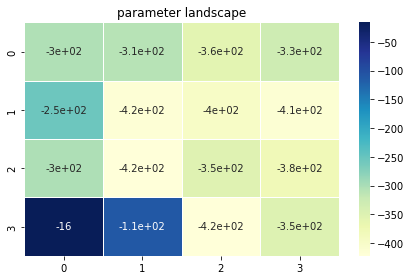

In [153]:
Qubits=len(Mf)
max_val=2**Qubits
param=np.arange(0.1,0.5,0.1,dtype=float)
print(param)
ideal_param1, ideal_param2, lowest_energy=param_optimizer_device(param, param, Mf, 1000,'SV1')
print(ideal_param1, ideal_param2, lowest_energy)

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  267 ms
total cost estimated: $ 0.00033375
{130610: 1, 1017946: 1, 649608: 1, 855394: 1, 557264: 1, 1023147: 1, 4369: 1, 303187: 1, 540480: 1, 435480: 1, 489034: 1, 59468: 1, 504364: 1, 1011021: 1, 33171: 1, 645499: 1, 275557: 1, 536829: 1, 287794: 1, 477477: 1, 384609: 1, 825717: 1, 212961: 1, 540729: 1, 334786: 1, 179853: 1, 635129: 1, 957816: 1, 211228: 1, 583917: 1, 185218: 1, 760880: 1, 479072: 1, 490058: 1, 16234: 1, 1035609: 1, 24307: 1, 850553: 1, 1019460: 1, 700019: 1, 454935: 1, 149553: 1, 927063: 1, 733161: 1, 598739: 1, 385672: 1, 410968: 1, 495542: 1, 108632: 1, 24824: 1, 1041045: 1, 38838: 1, 245365: 1, 524610: 1, 637875: 1, 26081: 1, 1001352: 1, 110066: 1, 530272: 1, 840627: 1, 204285: 1, 938749: 1, 917360: 1, 665501: 1, 627500: 1,

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  83 ms
total cost estimated: $ 0.00010375000000000001
{148827: 1, 219118: 1, 997015: 1, 154404: 1, 369081: 1, 132746: 1, 916424: 1, 953639: 1, 114377: 1, 839287: 1, 962060: 1, 225020: 1, 753315: 1, 208830: 1, 285546: 1, 904457: 1, 991650: 1, 423358: 1, 24842: 1, 874422: 1, 775814: 1, 883628: 1, 656792: 1, 432086: 1, 624272: 1, 267635: 1, 861056: 1, 282361: 1, 395336: 1, 1000629: 1, 580719: 1, 552801: 1, 435883: 1, 724865: 1, 159749: 1, 625541: 1, 365031: 1, 818085: 2, 8574: 1, 123580: 1, 563271: 1, 416982: 1, 1034363: 1, 420120: 1, 182483: 1, 810354: 1, 72821: 1, 45490: 1, 111099: 1, 906084: 1, 269986: 1, 466194: 1, 445075: 1, 247914: 1, 794036: 1, 1036981: 1, 985398: 1, 253468: 1, 209304: 1, 396765: 1, 239120: 2, 135076: 1, 67693: 1, 644103: 1, 

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  224 ms
total cost estimated: $ 0.00028000000000000003
{987827: 1, 145701: 1, 191682: 1, 796925: 1, 560058: 1, 268382: 1, 460068: 1, 917766: 1, 990270: 1, 840800: 1, 757328: 1, 696713: 1, 732553: 1, 639506: 2, 357472: 1, 65612: 1, 610718: 1, 439369: 1, 252850: 1, 881770: 1, 714295: 1, 960304: 1, 501809: 1, 273349: 1, 944432: 1, 1024668: 1, 385576: 1, 74040: 1, 118241: 1, 460854: 1, 374827: 1, 607272: 1, 931127: 1, 776294: 1, 33976: 1, 559244: 1, 789496: 1, 408102: 1, 835551: 1, 395576: 1, 34697: 1, 940206: 1, 476979: 1, 721048: 1, 461060: 1, 347398: 1, 123742: 1, 895031: 1, 617366: 1, 920930: 1, 21595: 1, 330182: 1, 993117: 1, 447396: 1, 385964: 1, 584890: 1, 765885: 1, 979051: 1, 24242: 1, 919036: 1, 682955: 1, 840072: 1, 370754: 1, 66859: 1, 90

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  144 ms
total cost estimated: $ 0.00018
{1035783: 1, 477696: 1, 943294: 1, 942633: 1, 970428: 1, 171161: 1, 543098: 1, 237141: 1, 1046538: 1, 944302: 1, 624856: 1, 927262: 1, 571552: 1, 682781: 1, 943627: 1, 162528: 1, 982492: 1, 606857: 1, 456495: 1, 18295: 1, 55805: 1, 105947: 1, 129125: 1, 751283: 1, 336033: 1, 959164: 1, 421892: 1, 390052: 1, 343301: 1, 185960: 1, 371208: 1, 382759: 1, 931383: 2, 38355: 1, 43527: 1, 590653: 1, 15521: 1, 390975: 2, 461457: 1, 429148: 1, 425869: 1, 171702: 1, 370419: 1, 1024665: 2, 680096: 1, 275287: 1, 768952: 1, 1903: 1, 688808: 1, 693069: 1, 130351: 1, 805870: 1, 33995: 1, 747708: 1, 1017993: 1, 625305: 1, 632011: 1, 501463: 1, 684143: 1, 317347: 1, 531114: 1, 685095: 1, 500865: 1, 43933: 1, 481181: 1, 22890

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  133 ms
total cost estimated: $ 0.00016625
{488226: 2, 546500: 1, 40339: 1, 191104: 1, 874142: 1, 219449: 1, 157739: 1, 619793: 1, 964742: 1, 432647: 1, 924659: 1, 525240: 1, 1035805: 1, 249529: 1, 285985: 1, 710537: 1, 373543: 1, 654063: 1, 233874: 1, 903510: 1, 841192: 1, 242433: 1, 199439: 1, 639882: 1, 32860: 1, 937195: 1, 61813: 1, 759893: 1, 421682: 1, 611160: 1, 542716: 1, 440330: 1, 583383: 1, 916087: 1, 431042: 1, 938241: 1, 177378: 1, 295774: 1, 421281: 1, 161793: 1, 117210: 1, 353309: 1, 150010: 1, 482330: 1, 133729: 1, 84526: 1, 703187: 1, 815048: 1, 439832: 1, 445391: 1, 1003960: 1, 335146: 1, 800627: 1, 470110: 1, 810367: 1, 349651: 1, 838401: 1, 421573: 1, 621851: 1, 625242: 1, 27651: 1, 778912: 1, 795074: 1, 516593: 1, 683825: 1, 

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  93 ms
total cost estimated: $ 0.00011625
{185895: 1, 554896: 1, 712250: 1, 780217: 1, 1018973: 1, 338420: 1, 1041743: 1, 635899: 1, 203611: 1, 703068: 2, 457369: 1, 449777: 1, 746476: 1, 901495: 1, 1034155: 1, 780611: 1, 768300: 1, 712711: 1, 136593: 1, 927539: 1, 153171: 1, 1030541: 1, 244364: 1, 194786: 1, 582258: 1, 449828: 1, 480841: 1, 934086: 1, 1044932: 1, 544188: 1, 285264: 1, 445316: 1, 310052: 1, 37540: 1, 926132: 1, 614791: 1, 471205: 1, 789710: 1, 668549: 1, 851021: 1, 869820: 1, 150561: 1, 490156: 1, 387473: 1, 175734: 1, 732653: 1, 436993: 1, 533870: 1, 511037: 1, 738115: 1, 687437: 1, 721036: 1, 490405: 1, 558820: 2, 45676: 1, 823035: 1, 747137: 1, 579709: 1, 298289: 1, 908589: 1, 324780: 1, 729704: 1, 691715: 1, 420676: 1, 790253

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  258 ms
total cost estimated: $ 0.00032250000000000003
{918120: 1, 924905: 1, 569661: 1, 930111: 1, 265472: 1, 264636: 2, 306988: 1, 403458: 1, 877515: 1, 156922: 1, 498648: 1, 494553: 1, 600956: 1, 628587: 1, 917909: 1, 945869: 1, 1013402: 1, 46063: 1, 773813: 1, 341799: 1, 744355: 1, 410675: 1, 491151: 1, 921048: 1, 306956: 1, 652191: 1, 455928: 1, 759601: 1, 680599: 1, 387829: 1, 932189: 1, 166233: 1, 734028: 1, 252969: 1, 171818: 1, 666036: 1, 10616: 1, 761639: 1, 892644: 1, 657221: 1, 497277: 1, 973: 1, 473793: 1, 967447: 1, 107169: 1, 616939: 1, 413984: 1, 778916: 1, 853873: 2, 357725: 1, 435056: 1, 779321: 1, 883715: 1, 676099: 1, 244673: 1, 179682: 1, 781671: 1, 920247: 1, 322898: 1, 448802: 1, 207624: 1, 188626: 1, 441377: 1, 159144: 1, 

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  79 ms
total cost estimated: $ 9.875e-05
{461526: 1, 192001: 1, 966903: 1, 613727: 1, 939783: 2, 547051: 1, 759094: 1, 805843: 1, 657217: 1, 500420: 1, 413471: 1, 342608: 1, 782604: 1, 107168: 1, 984277: 1, 835384: 1, 1000795: 1, 190241: 1, 42598: 1, 690032: 1, 720413: 1, 675282: 1, 415698: 1, 565323: 1, 979149: 1, 381270: 1, 1045214: 1, 707851: 1, 177826: 1, 642800: 1, 258819: 1, 50070: 1, 637906: 1, 415013: 1, 654069: 1, 499298: 1, 37369: 1, 964303: 1, 812669: 1, 1030971: 1, 625112: 1, 458285: 2, 237239: 1, 28804: 1, 84973: 1, 117229: 1, 456889: 1, 1014857: 1, 164706: 1, 658014: 1, 133627: 1, 228577: 1, 1040047: 1, 380025: 1, 1009853: 1, 580487: 1, 710414: 1, 1023782: 2, 12438: 1, 770848: 1, 411560: 1, 759133: 2, 804629: 1, 243463: 1, 570750: 1

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  95 ms
total cost estimated: $ 0.00011875000000000001
{675671: 1, 194927: 1, 86611: 1, 566779: 1, 400168: 1, 967922: 1, 911791: 1, 903037: 1, 913452: 1, 361165: 1, 642463: 1, 688252: 1, 262625: 1, 592115: 1, 674157: 1, 542202: 1, 1002914: 1, 871452: 1, 78670: 1, 836896: 1, 162787: 1, 50756: 1, 136944: 1, 16572: 1, 234786: 1, 515476: 1, 544931: 1, 884580: 1, 248293: 1, 1042681: 1, 188955: 1, 693033: 1, 871047: 1, 898870: 1, 691867: 1, 832555: 1, 27167: 1, 874246: 1, 769738: 1, 690676: 1, 1035190: 1, 477531: 1, 73348: 1, 165319: 1, 1029494: 1, 56563: 1, 31247: 1, 592760: 1, 76471: 1, 580085: 1, 224861: 1, 60957: 1, 85209: 1, 332063: 1, 803447: 1, 943457: 1, 561789: 1, 248397: 1, 665226: 1, 367611: 1, 202134: 1, 145085: 1, 1013517: 1, 463060: 1, 117

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  263 ms
total cost estimated: $ 0.00032875000000000005
{292025: 1, 323084: 1, 264000: 1, 811200: 1, 443303: 1, 647023: 1, 934048: 1, 406480: 1, 203846: 1, 314787: 1, 266277: 1, 675437: 1, 629173: 1, 280152: 1, 225789: 1, 95208: 1, 787789: 1, 967840: 1, 913954: 1, 601423: 1, 432251: 1, 349799: 1, 493390: 1, 280276: 1, 926133: 1, 1023915: 1, 814609: 1, 820223: 1, 310384: 1, 37731: 1, 753746: 1, 740214: 1, 910395: 1, 824653: 1, 710612: 1, 246709: 1, 508547: 1, 1025769: 1, 377311: 1, 872234: 1, 285035: 1, 517822: 1, 431062: 1, 429816: 1, 572919: 1, 945065: 1, 946470: 1, 739940: 1, 16852: 1, 253332: 1, 891040: 1, 891444: 1, 1011820: 1, 349362: 1, 263230: 1, 443387: 1, 756660: 1, 131875: 1, 192493: 1, 650159: 1, 622497: 1, 17723: 1, 318375: 1, 558968: 

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  81 ms
total cost estimated: $ 0.00010125000000000001
{295718: 1, 733148: 1, 168106: 1, 671696: 1, 381227: 1, 868069: 1, 827483: 1, 158897: 1, 434263: 1, 858529: 1, 398828: 1, 889867: 1, 529447: 1, 857937: 1, 784712: 1, 938512: 1, 506485: 1, 403726: 1, 776552: 1, 611861: 1, 705013: 1, 146154: 1, 467047: 1, 129804: 2, 156540: 1, 526082: 1, 569129: 1, 404330: 1, 582577: 1, 695052: 1, 400184: 1, 101800: 1, 879455: 1, 115275: 1, 739977: 1, 187585: 1, 731661: 1, 357380: 1, 392237: 1, 314585: 1, 268917: 1, 822254: 2, 38444: 1, 981865: 1, 640540: 1, 928820: 1, 1032089: 1, 170167: 1, 585695: 1, 446696: 1, 259996: 1, 203213: 1, 445744: 1, 562607: 1, 333510: 1, 72328: 1, 123289: 1, 263796: 1, 665508: 1, 980365: 1, 880489: 1, 527233: 1, 961630: 1, 878779: 1

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  92 ms
total cost estimated: $ 0.000115
{738752: 1, 923170: 1, 90166: 1, 414595: 1, 923113: 1, 1004385: 1, 659465: 1, 233670: 1, 214468: 1, 584200: 1, 505758: 1, 418794: 1, 906591: 1, 644973: 2, 330337: 1, 6112: 1, 701795: 1, 281790: 1, 817605: 1, 44083: 1, 816276: 1, 985206: 1, 703267: 1, 275034: 1, 226049: 1, 411833: 1, 112374: 1, 349687: 1, 410008: 1, 245097: 1, 179973: 1, 756904: 1, 781163: 1, 898162: 1, 606235: 1, 179004: 1, 777046: 1, 424934: 1, 240343: 1, 793171: 1, 792124: 1, 498157: 2, 683630: 1, 238583: 1, 770912: 1, 269223: 1, 114781: 1, 764379: 1, 937345: 1, 674873: 1, 885997: 1, 31299: 1, 104361: 1, 1028170: 1, 125073: 1, 445295: 1, 791950: 2, 446170: 1, 542936: 1, 279442: 1, 557021: 1, 1030374: 1, 379088: 1, 415342: 1, 358525: 1, 48

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  130 ms
total cost estimated: $ 0.00016250000000000002
{537849: 1, 41697: 1, 1025167: 1, 451639: 2, 658791: 1, 473580: 1, 47654: 2, 587719: 1, 652720: 1, 748994: 1, 105659: 1, 479730: 1, 296585: 1, 677449: 1, 951195: 1, 304230: 1, 550213: 1, 471692: 1, 1023404: 1, 476991: 1, 162640: 1, 675264: 1, 138727: 1, 182265: 1, 663739: 1, 83016: 1, 729980: 1, 170401: 1, 258716: 1, 818136: 1, 410025: 1, 635692: 1, 561776: 1, 552415: 1, 926780: 1, 98271: 1, 908351: 1, 331050: 1, 702940: 1, 337378: 1, 90526: 1, 594551: 1, 180621: 1, 1048233: 1, 267912: 1, 200995: 1, 361966: 1, 611336: 1, 85669: 1, 820019: 1, 116680: 1, 975388: 1, 978034: 1, 168091: 1, 652971: 1, 164232: 1, 659816: 1, 631403: 1, 244547: 1, 120453: 1, 1024335: 1, 177739: 1, 801474: 1, 327532: 1

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  85 ms
total cost estimated: $ 0.00010625000000000001
{509175: 2, 318020: 1, 370770: 1, 96604: 1, 116913: 1, 874744: 1, 205110: 1, 237820: 1, 497462: 1, 78413: 1, 79092: 1, 676000: 1, 252482: 1, 1006037: 2, 765146: 1, 247276: 1, 770179: 1, 29382: 1, 987219: 1, 127503: 1, 1032172: 1, 553515: 1, 148209: 1, 483219: 1, 196980: 1, 512063: 1, 665298: 1, 514450: 1, 531834: 2, 676081: 1, 723441: 1, 449988: 1, 947206: 1, 544036: 1, 858273: 1, 110959: 1, 483936: 1, 101335: 1, 973631: 1, 589876: 1, 751982: 1, 943209: 1, 265988: 1, 870907: 1, 129122: 1, 325025: 1, 778328: 1, 433804: 1, 819248: 1, 635100: 1, 787775: 1, 984235: 1, 880596: 1, 545475: 1, 508840: 1, 442715: 1, 659096: 1, 660146: 1, 116738: 1, 581937: 1, 1026880: 1, 87990: 1, 79784: 1, 386812: 1, 

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  86 ms
total cost estimated: $ 0.00010750000000000001
{656197: 1, 243754: 1, 700469: 1, 1012216: 1, 214919: 1, 233938: 1, 47164: 1, 16204: 1, 557849: 1, 104506: 1, 829709: 1, 815035: 1, 426883: 1, 476265: 1, 534242: 1, 75996: 1, 874684: 1, 343988: 1, 327681: 1, 31374: 1, 202858: 1, 871048: 1, 707773: 1, 538451: 1, 84785: 1, 131425: 1, 781214: 1, 833779: 1, 847535: 1, 509016: 2, 88139: 1, 773239: 1, 824717: 1, 257923: 1, 788762: 1, 252020: 1, 846069: 1, 824060: 1, 1023910: 1, 756038: 1, 965453: 2, 710097: 1, 560244: 1, 514917: 1, 785666: 1, 124967: 1, 589088: 1, 805098: 1, 1020187: 1, 465619: 1, 476063: 1, 217926: 1, 534144: 1, 200803: 1, 427510: 1, 450083: 1, 23572: 1, 870604: 1, 1019306: 1, 85380: 1, 105251: 1, 495490: 1, 178760: 1, 770818: 1, 4

Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
device Device('name': SV1, 'arn': arn:aws:braket:::device/quantum-simulator/amazon/sv1)
num reads 10000
simulator cost per  minute : $ 0.075
total execution time:  85 ms
total cost estimated: $ 0.00010625000000000001
{846979: 1, 903935: 1, 108340: 1, 399531: 1, 710627: 1, 592351: 1, 867822: 3, 850878: 1, 254072: 1, 931173: 1, 815642: 1, 628448: 1, 443525: 1, 945110: 1, 88071: 1, 797964: 1, 963145: 1, 470601: 1, 836746: 1, 542253: 1, 843151: 1, 467369: 1, 84857: 1, 923044: 1, 86622: 1, 538786: 1, 359183: 1, 544938: 1, 309101: 1, 807666: 1, 963315: 1, 662051: 1, 790572: 1, 562969: 1, 118835: 1, 163197: 1, 819106: 1, 311211: 1, 1037926: 1, 740427: 1, 537815: 1, 74478: 1, 87000: 1, 96901: 1, 638342: 1, 438998: 1, 307569: 1, 800085: 1, 123292: 1, 824585: 1, 214662: 1, 897185: 1, 758539: 1, 707096: 1, 398525: 1, 824500: 1, 553981: 1, 980002: 1, 662080: 1, 1042968: 1, 669693: 1, 4627: 1, 80618: 1, 804923: 1, 4753

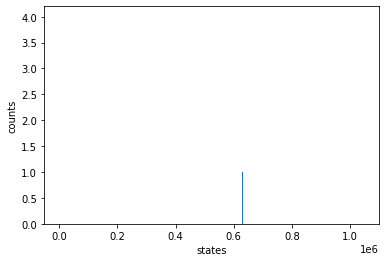

In [154]:
param1=np.arange(0.28,0.35,0.01,dtype=float)
param1=np.arange(0.18,0.32,0.02,dtype=float)
solution, quantity, energy, index=quantum_device_sampler(param, param, Mf, 10000,'SV1')

In [155]:
cond1_fail=0
cond2_fail=0
good_solution=[]
good_value=[]
good_weight=[]
good_energy=[]

temp_sol=[]
temp_energy=[]
for i in (index):   
    temp=[]
    #print(solution[i], energy[i], quantity[i])
    for j in range(N+wc):
        if solution[i][j]=='1':
            temp.append(int(j))
    temp_sol.append(temp)
    temp_energy.append(energy[i])

for trial in range(count):    
    
    item_list=[]
    Vt=0
    Wt=0
    for i in temp_sol[trial]:
        if i <N:
            Vt+=value[i]
            Wt+=weight[i]
            print(i, value[i], weight[i])
            item_list.append(i)
    print('Items added to Knapsack',item_list)
    print('Total value:',Vt)
    print('Total weight:',Wt)

    check_y=0
    weight_list=[]
    for i in temp_sol[trial]:
        if i>=N:
            check_y+=1
            weight_list.append(i-N+1)
    print('Condition 1 - Only one weight should be selected.')
    if check_y>1:
        print('FAIL: One weight condition not met', weight_list)
        cond1_fail+=1

    else:
        print('OK: condition met', weight_list)
        print('Condition 2 - Total weight should be equal to weight selected')
        if Wt==weight_list[0]:
            print('OK: Condition met', Wt)
            good_solution.append(item_list)
            good_value.append(Vt)
            good_weight.append(Wt)
            good_energy.append(temp_energy[trial])
            
        else:
            print('FAIL: Weight match condition not met', Wt, weight_list[0])
            cond2_fail+=1

good_count=len(good_value)
if good_count==0:
    print('-------FAIL!------------')
    print('No good values found')
    print('Condition 1: One weight condition failed',(cond1_fail/count)*100, '%')
    print('Condition 2: Weight match condition failed',(cond2_fail/count)*100, '%')
else:
    print('-------Success!------------')
    for i in range(good_count):
        
        #print(i, good_solution[i], 'Value', good_value[i],'Wt', good_weight[i])
        print(i, good_solution[i], 'Value', good_value[i],'Wt', good_weight[i], 'energy', good_energy[i])



2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10
0 2 2
4 10 3
7 16 5
Items added to Knapsack [0, 4, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 9
0 2 2
2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected

Run on Rigetti Aspen M1 

In [61]:
device=set_device('Aspen-M-1')
estimate_cost(device,num_shots=100000)

Device('name': Aspen-M-1, 'arn': arn:aws:braket:us-west-1::device/qpu/rigetti/Aspen-M-1)
device cost per  shot : $ 0.00035
total cost for 100000 shots is $35.30


Device('name': Aspen-M-1, 'arn': arn:aws:braket:us-west-1::device/qpu/rigetti/Aspen-M-1)
device Device('name': Aspen-M-1, 'arn': arn:aws:braket:us-west-1::device/qpu/rigetti/Aspen-M-1)
num reads 100000
device cost per  shot : $ 0.00035
total cost for 100000 shots is $35.30
{854: 2, 272089: 2, 827994: 2, 287917: 3, 11655: 1, 21202: 3, 13525: 6, 337052: 1, 956146: 1, 533466: 1, 577733: 3, 835165: 1, 10695: 1, 24758: 3, 819207: 1, 13261: 1, 610390: 1, 827518: 1, 286814: 2, 809974: 1, 21764: 2, 24767: 4, 26561: 2, 541916: 5, 9566: 2, 2385: 2, 15327: 3, 25159: 1, 29702: 1, 335482: 1, 29919: 9, 538530: 1, 28359: 3, 727064: 1, 620933: 1, 80081: 1, 9818: 2, 28788: 2, 90614: 2, 534675: 3, 9416: 6, 673965: 1, 29785: 2, 533508: 5, 530515: 2, 1738: 1, 42661: 1, 665221: 1, 532776: 2, 11158: 1, 348765: 1, 542269: 1, 811215: 2, 140886: 1, 668060: 1, 30300: 3, 919727: 1, 262167: 2, 545973: 3, 9877: 5, 14145: 1, 276925: 1, 75495: 2, 277653: 1, 155997: 1, 337068: 1, 24721: 3, 10812: 2, 529612: 3, 8263: 

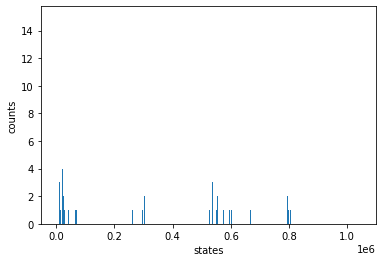

In [64]:
solution, quantity, energy, index=quantum_device_sampler([0.3], [0.3], Mf, 100000,'Aspen-M-1')

In [65]:
# Note the order of the numbers returned from Rigetti is reversed
#count=len(solution)
count=len(solution)
cond1_fail=0
cond2_fail=0
good_solution=[]
good_value=[]
good_weight=[]
good_energy=[]

temp_sol=[]
temp_energy=[]
for i in (index):   
    temp=[]
    #print(solution[i], energy[i], quantity[i])
    for j in range(N+wc):
        if solution[i][j]=='1':
            temp.append(int(j))
    temp_sol.append(temp)
    temp_energy.append(energy[i])

for trial in range(count):    
    
    item_list=[]
    Vt=0
    Wt=0
    for i in temp_sol[trial]:
        if i <N:
            Vt+=value[i]
            Wt+=weight[i]
            print(i, value[i], weight[i])
            item_list.append(i)
    print('Items added to Knapsack',item_list)
    print('Total value:',Vt)
    print('Total weight:',Wt)

    check_y=0
    weight_list=[]
    for i in temp_sol[trial]:
        if i>=N:
            check_y+=1
            weight_list.append(i-N+1)
    print('Condition 1 - Only one weight should be selected.')
    if check_y>1:
        print('FAIL: One weight condition not met', weight_list)
        cond1_fail+=1

    elif check_y==1:
        print('OK: condition met', weight_list)
        print('Condition 2 - Total weight should be equal to weight selected')
        if Wt==weight_list[0]:
            print('OK: Condition met', Wt)
            good_solution.append(item_list)
            good_value.append(Vt)
            good_weight.append(Wt)
            good_energy.append(temp_energy[trial])
            
        else:
            print('FAIL: Weight match condition not met', Wt, weight_list[0])
            cond2_fail+=1
    else:
        print('FAIL: No weight found')

good_count=len(good_value)
if good_count==0:
    print('-------FAIL!------------')
    print('No good values found')
    print('Condition 1: One weight condition failed',(cond1_fail/count)*100, '%')
    print('Condition 2: Weight match condition failed',(cond2_fail/count)*100, '%')
else:
    print('-------Success!------------')
    for i in range(good_count):
        
        #print(i, good_solution[i], 'Value', good_value[i],'Wt', good_weight[i])
        print(i, good_solution[i], 'Value', good_value[i],'Wt', good_weight[i], 'energy', good_energy[i])


2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 10
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10
6 14 6
7 16 5
Items added to Knapsack [6, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 10
2 6 2
4 10 3
6 14 6
Items added to Knapsack [2, 4, 6]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight m

2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [7]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 7
0 2 2
1 4 3
4 10 3
Items added to Knapsack [0, 1, 4]
Total value: 16
Total weight: 8
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 8 10
0 2 2
2 6 2
Items added to Knapsack [0, 2]
Total value: 8
Total weight: 4
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
OK: Condition met 4
0 2 2
6 14 6
Items added to Knapsack [0, 6]
Total value: 16
Total weight: 8
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not m

5 12 5
Items added to Knapsack [3, 4, 5]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [6]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 6
1 4 3
3 8 3
Items added to Knapsack [1, 3]
Total value: 12
Total weight: 6
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 6 10
0 2 2
4 10 3
Items added to Knapsack [0, 4]
Total value: 12
Total weight: 5
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 5 1
2 6 2
3 8 3
7 16 5
Items added to Knapsack [2, 3, 7]
Total value: 30
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [5]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match conditio

OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 17 10
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 2, 3, 4, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 9
0 2 2
1 4 3
5 12 5
Items added to Knapsack [0, 1, 5]
Total value: 18
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 4
0 2 2
2 6 2
3 8 3
5 12 5
7 16 5
Items added to Knapsack [0, 2, 3, 5, 7]
Total value: 44
Total weight: 17
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 17 10
0 2 2
6 14 6
Items added to Knapsack [0, 6]
To

Total value: 38
Total weight: 17
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 17 9
0 2 2
1 4 3
2 6 2
3 8 3
8 18 8
Items added to Knapsack [0, 1, 2, 3, 8]
Total value: 38
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 10
1 4 3
6 14 6
9 20 9
Items added to Knapsack [1, 6, 9]
Total value: 38
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 10
1 4 3
2 6 2
3 8 3
9 20 9
Items added to Knapsack [1, 2, 3, 9]
Total value: 38
Total weight: 17
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight ma

1 4 3
3 8 3
5 12 5
Items added to Knapsack [0, 1, 3, 5]
Total value: 26
Total weight: 13
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 13 4
0 2 2
4 10 3
6 14 6
Items added to Knapsack [0, 4, 6]
Total value: 26
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [2]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 11 2
0 2 2
3 8 3
7 16 5
Items added to Knapsack [0, 3, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 10 1
1 4 3
4 10 3
5 12 5
Items added to Knapsack [1, 4, 5]
Total value: 26
Total weight: 11
Condition 1 - Only one weight should be selected.
OK: condition met [2]
Condition 2 - Total weight should be equal to weigh

Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 7
0 2 2
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 5, 7, 9]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 10
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 4, 5, 7]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 20 9
0 2 2
1 4 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 7, 8]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 10
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items ad

Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 16 4
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 3, 5, 6]
Total value: 46
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 9
1 4 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 5, 6, 7]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [7]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 7
0 2 2
1 4 3
2 6 2
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 6, 9]
Total value: 46
Total weight: 22
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 22 10
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack

7 16 5
Items added to Knapsack [0, 2, 4, 6, 7]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [5]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 5
0 2 2
1 4 3
3 8 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 6, 9]
Total value: 48
Total weight: 23
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 23 10
0 2 2
1 4 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 4, 5, 9]
Total value: 48
Total weight: 22
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 22 9
0 2 2
1 4 3
2 6 2
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 7, 9]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Co

OK: condition met [7]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 7
0 2 2
1 4 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 1, 5, 6, 8]
Total value: 50
Total weight: 24
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 24 10
0 2 2
1 4 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 7, 8]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [7]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 7
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 3, 4, 5, 6]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
OK: condition met [8]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 22 8
0 2 2
3 8 3
4 10 

Items added to Knapsack [6, 9]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 15 1
1 4 3
3 8 3
4 10 3
9 20 9
Items added to Knapsack [1, 3, 4, 9]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [8, 10]
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [3, 4, 5, 6]
Total value: 44
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 10]
0 2 2
1 4 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 4, 5, 7]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [9, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [2, 3, 4, 5, 6]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition

Total value: 44
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 10]
0 2 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 3, 4, 8]
Total value: 38
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 10]
0 2 2
1 4 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 4, 5, 7]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 10]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 4, 6, 7]
Total value: 54
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 10]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 3, 5, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [8, 10]
0 2 2
6 14 6
9 20 9
Items added to Knapsack [0, 6, 9]
Total value: 36
Total weight: 17
C

7 16 5
Items added to Knapsack [1, 4, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8]
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 8]
0 2 2
3 8 3
5 12 5
7 16 5
Items added to Knapsack [0, 3, 5, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 10]
3 8 3
4 10 3
9 20 9
Items added to Knapsack [3, 4, 9]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 10]
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 10]
1 4 3
2 6 2
3 8 3
6 14 6
Items added to Knapsack [1, 2, 3, 6]
Total value: 32
Total weight: 14
Co

5 12 5
6 14 6
Items added to Knapsack [0, 2, 4, 5, 6]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 10]
0 2 2
2 6 2
4 10 3
7 16 5
Items added to Knapsack [0, 2, 4, 7]
Total value: 34
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6]
0 2 2
1 4 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 5, 7]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 10]
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 6, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 10]
0 2 2
3 8 3
7 16 5
Items added to Knapsack [0, 3, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6]
1 4 3
2 6 2
4 10 3
6 14 6
Items added to Knapsack [1, 2, 4, 6]
Total value: 

7 16 5
Items added to Knapsack [3, 7]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6]
3 8 3
7 16 5
Items added to Knapsack [3, 7]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5]
0 2 2
1 4 3
2 6 2
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 5, 7]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9]
2 6 2
7 16 5
8 18 8
Items added to Knapsack [2, 7, 8]
Total value: 40
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7]
0 2 2
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 4, 5, 7]
Total value: 40
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 10]
1 4 3
2 6 2
6 14 6
Items added to Knapsack [1, 2, 6]
Total value: 24
Total weight: 11
Condition 1 - Only

4 10 3
7 16 5
Items added to Knapsack [0, 3, 4, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 9]
0 2 2
1 4 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 6, 7]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9]
0 2 2
2 6 2
4 10 3
Items added to Knapsack [0, 2, 4]
Total value: 18
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
0 2 2
1 4 3
2 6 2
6 14 6
Items added to Knapsack [0, 1, 2, 6]
Total value: 26
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 8]
0 2 2
1 4 3
2 6 2
6 14 6
Items added to Knapsack [0, 1, 2, 6]
Total value: 26
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
2 6 2
3 8 3
7 16 5
9 20 9
Items added to Knapsack [2, 3, 7, 9]
Total value: 50
Total

Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
Items added to Knapsack [0, 1, 2, 3, 5]
Total value: 32
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [8, 10]
2 6 2
3 8 3
Items added to Knapsack [2, 3]
Total value: 14
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 6, 7]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 9]
2 6 2
3 8 3
8 18 8
Items added to Knapsack [2, 3, 8]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 10]
3 8 3
4 10 3
6 14 6
Items added to Knapsack [3, 4, 6]
Total value: 32
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weig

FAIL: One weight condition not met [4, 9]
1 4 3
2 6 2
7 16 5
Items added to Knapsack [1, 2, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
0 2 2
1 4 3
3 8 3
5 12 5
Items added to Knapsack [0, 1, 3, 5]
Total value: 26
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 9]
0 2 2
2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5]
1 4 3
4 10 3
5 12 5
Items added to Knapsack [1, 4, 5]
Total value: 26
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
1 4 3
3 8 3
5 12 5
7 16 5
Items added to Knapsack [1, 3, 5, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8]
0 2 2
3 8 3
7 16 5
Items added to Knaps

Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 8]
1 4 3
2 6 2
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 2, 5, 6, 8]
Total value: 54
Total weight: 24
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 24 9
2 6 2
6 14 6
7 16 5
Items added to Knapsack [2, 6, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
7 16 5
9 20 9
Items added to Knapsack [7, 9]
Total value: 36
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6]
0 2 2
2 6 2
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 2, 5, 6, 9]
Total value: 54
Total weight: 24
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL

Items added to Knapsack [0, 4, 9]
Total value: 32
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [8, 10]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 4, 5, 7]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
OK: condition met [5]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 20 5
1 4 3
2 6 2
3 8 3
Items added to Knapsack [1, 2, 3]
Total value: 18
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
1 4 3
3 8 3
9 20 9
Items added to Knapsack [1, 3, 9]
Total value: 32
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
2 6 2
4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
0 2 2
2 6 2
5 

Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
4 10 3
7 16 5
Items added to Knapsack [0, 4, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
0 2 2
1 4 3
4 10 3
5 12 5
Items added to Knapsack [0, 1, 4, 5]
Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
2 6 2
4 10 3
5 12 5
8 18 8
Items added to Knapsack [2, 4, 5, 8]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 18 3
1 4 3
2 6 2
7 16 5
9 20 9
Items added to Knapsack [1, 2, 7, 9]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
2 6 2
3 8 3
5 12 5
9 20 9
Items added to Knaps

7 16 5
9 20 9
Items added to Knapsack [1, 7, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
OK: condition met [2]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 17 2
0 2 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [0, 3, 6, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
0 2 2
2 6 2
6 14 6
Items added to Knapsack [0, 2, 6]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 3, 4, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7]
3 8 3
Items added to Knapsack [3]
Total value: 8
Total weight: 3
Condition 1 - Only one weight should be selected.
FAIL: No weight found
0 2 2
3 8 3
6 14 6
7 16 5
Items added to 

6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 5, 6, 7]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [8, 10]
2 6 2
5 12 5
7 16 5
Items added to Knapsack [2, 5, 7]
Total value: 34
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 10]
0 2 2
2 6 2
4 10 3
7 16 5
Items added to Knapsack [0, 2, 4, 7]
Total value: 34
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5]
2 6 2
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [2, 3, 4, 5, 9]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 6]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight

4 10 3
5 12 5
8 18 8
Items added to Knapsack [3, 4, 5, 8]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 10]
0 2 2
1 4 3
2 6 2
6 14 6
Items added to Knapsack [0, 1, 2, 6]
Total value: 26
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 6]
0 2 2
2 6 2
Items added to Knapsack [0, 2]
Total value: 8
Total weight: 4
Condition 1 - Only one weight should be selected.
FAIL: No weight found
0 2 2
3 8 3
7 16 5
Items added to Knapsack [0, 3, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 8]
0 2 2
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 5, 7, 8]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
0 2 2
2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only o

Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 8]
0 2 2
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 2, 3, 4, 7]
Total value: 42
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
1 4 3
2 6 2
4 10 3
Items added to Knapsack [1, 2, 4]
Total value: 20
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 10]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 6, 7]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 10]
0 2 2
1 4 3
2 6 2
4 10 3
9 20 9
Items added to Knapsack [0, 1, 2, 4, 9]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 2, 3, 5, 6]
Total value: 42
Total weight: 18
Condition 1 - O

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
2 6 2
4 10 3
6 14 6
Items added to Knapsack [2, 4, 6]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [1, 2, 3, 4, 5, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
1 4 3
2 6 2
3 8 3
5 12 5
Items added to Knapsack [1, 2, 3, 5]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [9, 10]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 4, 6, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9]
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 4, 5, 6, 7]
Total value: 56
Total weight: 22
Condition 1 - Only 

7 16 5
Items added to Knapsack [3, 4, 6, 7]
Total value: 48
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7]
1 4 3
8 18 8
Items added to Knapsack [1, 8]
Total value: 22
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
0 2 2
1 4 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 5, 7, 8]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 26 10
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 3, 5, 7]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 10]
0 2 2
1 4 3
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 7, 8]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: 

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6]
0 2 2
2 6 2
6 14 6
8 18 8
Items added to Knapsack [0, 2, 6, 8]
Total value: 40
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 4, 5, 6, 7]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [5]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 5
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 2, 3, 4, 5, 7]
Total value: 54
Total weight: 20
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 20 4
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 4, 6, 7]
Total value: 54
Total weight: 19
Condition 1 - Only one weight should be 

7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 5, 7, 9]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [8, 10]
2 6 2
4 10 3
8 18 8
Items added to Knapsack [2, 4, 8]
Total value: 34
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4]
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 6, 7]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 3
0 2 2
1 4 3
4 10 3
5 12 5
8 18 8
Items added to Knapsack [0, 1, 4, 5, 8]
Total value: 46
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [5]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 5
3 8 3
4 10 3
6 14 6
Items added to Knapsack [3, 4, 6]
Total value: 32
Total

2 6 2
5 12 5
Items added to Knapsack [0, 1, 2, 5]
Total value: 24
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 4, 6, 7]
Total value: 54
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7]
1 4 3
2 6 2
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 4, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 10]
1 4 3
3 8 3
5 12 5
Items added to Knapsack [1, 3, 5]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [8, 10]
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 3, 5, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
0 2 2
1 4 3
2 6 2
5 12 5
Items added to Knapsack [

Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6]
1 4 3
2 6 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [1, 2, 3, 4, 9]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 10]
0 2 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 3, 4, 5, 7]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 9]
0 2 2
2 6 2
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 2, 3, 6, 8]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7]
0 2 2
1 4 3
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 6, 8]
Total value: 46
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9]
0 2 2
1 4 3
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 6, 8]
Total value: 46
Total weight:

6 14 6
8 18 8
Items added to Knapsack [0, 6, 8]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
1 4 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 5, 7]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 7, 9]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [8, 10]
0 2 2
2 6 2
4 10 3
6 14 6
Items added to Knapsack [0, 2, 4, 6]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 4, 6, 7, 8]
Total value: 66
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 10]
0 2 2
3 8 3
4 10 3
5 12 5

6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9]
0 2 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 9]
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [3, 5, 6, 9]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
2 6 2
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 4, 7, 8, 9]
Total value: 70
Total weight: 27
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal 

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6]
1 4 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [1, 4, 6, 8]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
0 2 2
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 4, 7, 8]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
1 4 3
2 6 2
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 6, 9]
Total value: 46
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 10]
0 2 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 4, 6, 9]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 6, 7, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one wei

0 2 2
1 4 3
2 6 2
3 8 3
8 18 8
Items added to Knapsack [0, 1, 2, 3, 8]
Total value: 38
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
1 4 3
Items added to Knapsack [1]
Total value: 4
Total weight: 3
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
0 2 2
2 6 2
6 14 6
7 16 5
Items added to Knapsack [0, 2, 6, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4]
0 2 2
1 4 3
2 6 2
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 5, 6]
Total value: 38
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 8]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
OK: condition met [5]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight

4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 3, 4, 5, 6, 7]
Total value: 66
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9]
0 2 2
1 4 3
3 8 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 6, 7]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [2]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 2
0 2 2
2 6 2
3 8 3
4 10 3
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 8, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 10]
0 2 2
1 4 3
2 6 2
4 10 3
9 20 9
Items added to Knapsack [0, 1, 2, 4, 9]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
OK: condition met [2]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 19 2
2 6 2
4 10 3
5 12 5
7 16 5
9 20 9


8 18 8
9 20 9
Items added to Knapsack [0, 6, 8, 9]
Total value: 54
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 4, 6, 7]
Total value: 54
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 7]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 9]
Total value: 54
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 10]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 4, 5, 6, 7]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
0 2 2
1 4 3

Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
1 4 3
2 6 2
6 14 6
9 20 9
Items added to Knapsack [1, 2, 6, 9]
Total value: 44
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7]
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 6, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 4, 6]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6]
4 10 3
6 14 6
9 20 9
Items added to Knapsack [4, 6, 9]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 2, 3, 4, 7]
Total value: 44
Total weight: 16
Conditio

OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 28 10
0 2 2
2 6 2
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 2, 4, 5, 7, 8]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
0 2 2
2 6 2
6 14 6
Items added to Knapsack [0, 2, 6]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: No weight found
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 5, 6, 7]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9]
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [2, 4, 6, 7, 8]
Total value: 64
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 10]
0 2 2
2 6 2
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 6, 7, 8]
Total value: 64

7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 7, 9]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 4, 6, 7]
Total value: 54
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 7, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [7]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 7
0 2 2
1 4 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 5, 7, 9]
Total value: 54
Total weight: 24
Condition 1 - Only 

Total value: 46
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 3, 5, 6]
Total value: 46
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6]
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [3, 4, 6, 9]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 3
1 4 3
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [1, 2, 3, 4, 8]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
1 4 3
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 6, 8]
Total value: 46
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
0

FAIL: One weight condition not met [1, 2]
0 2 2
6 14 6
8 18 8
Items added to Knapsack [0, 6, 8]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 6]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
0 2 2
1 4 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 5, 7]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
6 14 6
9 20 9
Items added to Knapsack [6, 9]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
Items added to Knapsack [0, 1, 2, 4, 5]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
0 2 2
1 4 3
2 6 2
3 8 3
5 12

1 4 3
2 6 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 9]
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [3, 6, 7, 9]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7]
1 4 3
3 8 3
Items added to Knapsack [1, 3]
Total value: 12
Total weight: 6
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 4, 6, 7]
Total value: 58
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 5, 6, 7]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6

3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 7]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
0 2 2
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 6, 7]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4]
1 4 3
3 8 3
6 14 6
9 20 9
Items added to Knapsack [1, 3, 6, 9]
Total value: 46
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
Items added to Knapsack [1, 2, 4, 5, 6]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
0 2 2
2 6 2
8 18 8
9 20 9
Items added to Knapsack [0, 2, 8, 9]
Total value: 46
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
2 6 2
4 10 3
5 12 5
7 16 5
Items ad

9 20 9
Items added to Knapsack [2, 3, 4, 7, 9]
Total value: 60
Total weight: 22
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 22 3
1 4 3
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 6, 7, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [6]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 6
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 4, 5, 6, 7]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 23 4
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 5, 6, 9]
Total value: 60
Total weight: 28
Condition 1 - Only one weight should be selected.
OK: c

7 16 5
9 20 9
Items added to Knapsack [1, 4, 7, 9]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 20 1
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 3, 4, 5, 6, 8]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 10]
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [3, 4, 5, 9]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 20 1
0 2 2
2 6 2
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 2, 4, 6, 8]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [2]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match

9 20 9
Items added to Knapsack [4, 5, 8, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 10]
2 6 2
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 7, 8, 9]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7]
0 2 2
1 4 3
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 1, 3, 4, 9]
Total value: 44
Total weight: 20
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 20 1
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 5, 6, 9]
Total value: 60
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 10]
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 5, 6, 7]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should 

0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 2, 3, 4, 5, 6]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
Items added to Knapsack [0]
Total value: 2
Total weight: 2
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 5, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 3, 4, 5, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [4, 5, 6, 7]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to K

Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2]
0 2 2
6 14 6
9 20 9
Items added to Knapsack [0, 6, 9]
Total value: 36
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
0 2 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 3, 5, 6]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2]
0 2 2
1 4 3
3 8 3
9 20 9
Items added to Knapsack [0, 1, 3, 9]
Total value: 34
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [1, 2, 3, 7]
Total value: 34
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: No weight found
2 6 2
4 10 3
8 18 8
Items added to Knapsack [2, 4, 8]
Total value: 34
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: No weight f

7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 6, 7, 8]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 9]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 4, 5, 6, 7, 8]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 29 9
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 30 10
1 4 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 5, 6, 7, 8]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9]
0 2 2
5 12 5
6 14 6
7 1

3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 5, 6, 7]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [5]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 5
1 4 3
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [1, 3, 4, 6, 9]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6]
0 2 2
1 4 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 6, 7, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 4, 6, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6]
Total value: 56
Tot

Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 23 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 4, 5, 6, 7]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 1
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 9]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 3, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 4, 5, 7]
Total value: 50
Total 

3 8 3
9 20 9
Items added to Knapsack [0, 1, 2, 3, 9]
Total value: 40
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 3, 5, 6]
Total value: 40
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
0 2 2
1 4 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 6, 9]
Total value: 40
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 4, 5, 6]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 21 1
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 8]
Total value: 48
Total weight: 21
Condition 1 - Only one weight sh

0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 4, 6, 7, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 8]
0 2 2
2 6 2
3 8 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 5, 8, 9]
Total value: 66
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
0 2 2
1 4 3
3 8 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 6, 8, 9]
Total value: 66
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 10]
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [3, 4, 6, 7, 8]
Total value: 66
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FA

2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 4, 6, 7]
Total value: 58
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 4, 6, 7]
Total value: 58
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 2, 3, 4, 6, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 7, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 5, 6, 8]
Total value: 58
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One wei

1 4 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [1, 4, 6, 8]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
0 2 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 4, 6, 9]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [4, 6, 7, 8, 9]
Total value: 78
Total weight: 31
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 31 10
0 2 2
1 4 3
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 6, 8]
Total value: 46
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6]
5 12 5
6 14 6
9 20 9
Items added to Knapsack [5, 6, 9]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
F

FAIL: Weight match condition not met 24 3
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 4
1 4 3
2 6 2
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 2, 5, 6, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 4
0 2 2
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 3, 5, 6, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 4
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 7, 9]
Total value: 56
Total 

0 2 2
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 3, 4, 5, 7, 9]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [2, 3, 4, 5, 6, 8]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 6, 7, 9]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 9]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7]
Total value: 68
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 3, 4, 5, 6, 9]
Total value: 68
Total weight: 29
Condition 1 - Only one weight should be s

7 16 5
9 20 9
Items added to Knapsack [3, 4, 7, 9]
Total value: 54
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [1, 2, 3, 4, 5, 6]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [1, 2, 3, 4, 5, 6]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
0 2 2
1 4 3
4 10 3
8 18 8
9 20 9
Items added to Knapsack [0, 1, 4, 8, 9]
Total value: 54
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 7]
0 2 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 3, 4, 6, 9]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
1 4 3
3 8 3
4 

7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 3, 5, 7, 8, 9]
Total value: 76
Total weight: 32
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 32 10
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 5, 6, 7, 8]
Total value: 76
Total weight: 32
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 32 10
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 7, 8, 9]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 32 10
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [2, 3, 5, 6, 7, 8]
Total value: 74
Total weight: 29
Con

6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 4, 6, 7, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7]
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [4, 5, 8, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 3
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 7, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 9]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 5, 7, 8]
Total value: 70
Total

FAIL: One weight condition not met [3, 9]
0 2 2
2 6 2
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 6, 7, 8]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 4, 6, 8, 9]
Total value: 64
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
0 2 2
1 4 3
4 10 3
8 18 8
9 20 9
Items added to Knapsack [0, 1, 4, 8, 9]
Total value: 54
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 3
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 6, 7, 8]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to 

7 16 5
8 18 8
Items added to Knapsack [1, 6, 7, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
0 2 2
1 4 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 1, 5, 7, 8]
Total value: 52
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 2, 3, 4, 5, 6]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
0 2 2
2 6 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 2, 4, 6, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
0 2 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 3, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
1 4 3
2 6 2
4 10 3
6 14

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 10]
0 2 2
1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 5, 6, 7, 8]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 10]
3 8 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [3, 5, 6, 8, 9]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7]
1 4 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added 

8 18 8
Items added to Knapsack [0, 1, 3, 5, 6, 7, 8]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
OK: condition met [9]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 32 9
0 2 2
2 6 2
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 2, 4, 5, 7, 8]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 5, 6, 7]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 9]
Total value: 6

0 2 2
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 3, 5, 6, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 4, 6, 8]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5]
0 2 2
2 6 2
4 10 3
8 18 8
9 20 9
Items added to Knapsack [0, 2, 4, 8, 9]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4]
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [4, 5, 7, 8]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2]
0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 7, 8]
Total value: 56
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]


Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2]
0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 24 1
0 2 2
1 4 3
2 6 2
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 7, 9]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2]
0 2 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 3, 4, 5, 7]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: No weight found
0 2 2
1 4 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 5, 6, 7]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2]
0 2 2
2 6 2
3 8 3
6 14 6
7 

8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 6, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 9]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 6, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
1 4 3
2 6 2
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 5, 8, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7]
0 2 2
1 4 3
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 4, 7, 8, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condit

FAIL: One weight condition not met [1, 5]
0 2 2
1 4 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 6, 7, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [4, 5, 6, 9]
Total value: 56
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 8]
Total value: 56
Total weight: 23
Condition 1 - Only one weight sh

5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 5, 6, 7]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 25 1
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 27 3
0 2 2
1 4 3
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 6, 7, 9]
Total value: 64
Total weight: 28
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 28 4
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 7, 9]
Total value: 64
Total weight: 25
Condition 1 - Only one weight

4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 4, 5, 6, 7, 8]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 8]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 4, 5, 6, 7, 8]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
1 4 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 5, 7, 8, 9]
Total value: 72
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weigh

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 6, 7, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
0 2 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 6, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
0 2 2
1 4 3
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 5, 7, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
0 2 2
1 4 3
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 6, 7, 8]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [3, 4, 5, 6, 8]
Total value: 6

Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 29 4
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 4, 6, 7, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 28 3
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 5, 7, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 29 4
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 4, 6, 7, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal 

2 6 2
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 5, 6, 8, 9]
Total value: 74
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 8, 9]
Total value: 74
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 8, 9]
Total value: 74
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8]
1 4 3
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 3, 4, 6, 8, 9]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight

7 16 5
9 20 9
Items added to Knapsack [1, 3, 6, 7, 9]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
1 4 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 4, 6, 7, 8]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 6, 7, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
0 2 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 6, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
0 2 2
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 5, 8, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
0 2 2
2 6 2
4 10 

Items added to Knapsack [0, 6, 7, 8, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 30 4
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 7, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 30 4
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 6, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 29 3
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7]
Total value: 70
Total weight: 27
Condition 1 - Only one we

4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [2, 3, 4, 5, 7, 9]
Total value: 72
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
0 2 2
2 6 2
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 4, 7, 8, 9]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 6, 7, 8]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should 

2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 8, 9]
Total value: 98
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 7, 8, 9]
Total value: 96
Total weight: 40
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 8, 9]
Total value: 96
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 9]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 4, 5, 6, 7, 8, 9]
Total value: 96
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 10]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 6, 7, 8, 9

Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 8, 9]
Total value: 76
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 5, 6, 7, 8]
Total value: 76
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 5, 6, 7, 8]
Total value: 76
Total weight: 31
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 31 4
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 4, 6, 7, 8]
Total value: 76
Total weight: 30
Condition 1 - 

FAIL: One weight condition not met [1, 2]
0 2 2
2 6 2
3 8 3
4 10 3
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 8, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 2, 4, 5, 6, 8]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 9]
Total value: 62
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
0 2 2
1 4 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 5, 7, 8]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 6, 7, 9]
Total value: 62
Total weight: 27
Condition 1 

2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 7, 9]
Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
1 4 3
2 6 2
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 5, 7, 8, 9]
Total value: 76
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 9]
Total value: 76
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 5, 6, 7, 8]
Total value: 76
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
3 8 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 6, 7, 8, 9]
Total value: 76
Total weight: 31
Condition 1 - Only one weight s

Total value: 64
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
OK: condition met [5]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 33 5
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 2, 4, 5, 6, 8]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2]
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 4, 5, 6, 7, 8]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 32 4
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to 

9 20 9
Items added to Knapsack [4, 6, 7, 9]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 10]
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [3, 6, 7, 9]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [5, 6, 7, 8]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [2, 3, 4, 6, 9]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
0 2 2
2 6 2
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 7, 9]
Total value: 66
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9, 10]
0 2 2
2 6 2
4 10 3
5 12 5


3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 3, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7, 10]
0 2 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 10]
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [4, 5, 6, 7]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 9]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 7, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
0 2 2
2 6 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 7, 9]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 8, 

Total value: 50
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7, 10]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 7, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 10]
1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 5, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 10]
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
Items added to Knapsack [1, 2, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 10]
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [2, 3, 4, 5, 7]
Total value: 52
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 10]
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [3,

5 12 5
7 16 5
Items added to Knapsack [0, 2, 3, 4, 5, 7]
Total value: 54
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 9, 10]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [2, 4, 5, 6, 7, 9]
Total value: 78
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 9, 10]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 5, 6, 7]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 9, 10]
0 2 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 3, 4, 6, 9]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 10]
0 2 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 4, 6, 9]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 9

0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 2, 4, 6, 7]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
1 4 3
2 6 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [1, 2, 3, 4, 9]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 9, 10]
5 12 5
7 16 5
9 20 9
Items added to Knapsack [5, 7, 9]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7, 10]
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [2, 3, 6, 9]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 8, 10]
2 6 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 5, 6, 7]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
0 2 2
4 10 3
7 16 5
8 18 8
I

5 12 5
7 16 5
Items added to Knapsack [0, 2, 3, 5, 7]
Total value: 44
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 10]
0 2 2
1 4 3
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 1, 3, 4, 8]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
2 6 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [2, 4, 6, 9]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 2, 4, 5, 6]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7]
1 4 3
2 6 2
5 12 5
9 20 9
Items added to Knapsack [1, 2, 5, 9]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
0 2 2
6 14 6
7 16 5
8 18 8
Ite

4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 2, 3, 4, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [2, 3, 4, 6, 7, 9]
Total value: 74
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9, 10]
0 2 2
1 4 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 7, 9]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 2, 3, 4, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6]
0 2 2


7 16 5
Items added to Knapsack [1, 4, 5, 7]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6]
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [3, 4, 6, 7]
Total value: 48
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 8]
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [2, 3, 6, 9]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 10]
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [4, 5, 7, 9]
Total value: 58
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [3, 4, 6, 7]
Total value: 48
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7]
1 4 3
2 6 2
6 14 6
7 16 5
Items added to Knapsack [1, 2, 6

9 20 9
Items added to Knapsack [0, 3, 4, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 6, 7]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 10]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 3, 5, 6]
Total value: 40
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 10]
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 3, 5, 6, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 10]
2 6 2
6 14 6
9 20 9
Items added to Knapsack [2, 6, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9]
0 2 2
1 4 3
2 6 2
7 16 5
8 18 8
Items add

1 4 3
2 6 2
4 10 3
9 20 9
Items added to Knapsack [1, 2, 4, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 10]
0 2 2
1 4 3
4 10 3
5 12 5
8 18 8
Items added to Knapsack [0, 1, 4, 5, 8]
Total value: 46
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 8, 10]
0 2 2
1 4 3
2 6 2
4 10 3
8 18 8
Items added to Knapsack [0, 1, 2, 4, 8]
Total value: 40
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
1 4 3
2 6 2
6 14 6
7 16 5
Items added to Knapsack [1, 2, 6, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9]
0 2 2
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 4, 7, 8]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7]
2 6 2
3 8 3
4 10 3
5 1

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 10]
0 2 2
2 6 2
6 14 6
7 16 5
Items added to Knapsack [0, 2, 6, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7, 8]
1 4 3
3 8 3
5 12 5
6 14 6
Items added to Knapsack [1, 3, 5, 6]
Total value: 38
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7, 10]
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 7]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
2 6 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [2, 3, 4, 9]
Total value: 44
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 9]
0 2 2
2 6 2
6 14 6
7 16 5
Items added to Knapsack [0, 2, 6, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight shou

3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 2, 3, 4, 5, 6]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9]
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 7]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7]
0 2 2
1 4 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 6, 7]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 10]
0 2 2
2 6 2
6 14 6
9 20 9
Items added to Knapsack [0, 2, 6, 9]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 6, 7]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 9]
0 2 2
3 8 3
4 10 3
7

FAIL: One weight condition not met [3, 4, 10]
1 4 3
3 8 3
6 14 6
7 16 5
Items added to Knapsack [1, 3, 6, 7]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [4, 5, 6, 7]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9]
0 2 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 3, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
1 4 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [1, 4, 5, 7]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9]
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 6, 7]
Total value: 52
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not

Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 2, 3, 4, 6]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
6 14 6
7 16 5
9 20 9
Items added to Knapsack [6, 7, 9]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [3, 4, 5, 7, 8]
Total value: 64
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 10]
1 4 3
2 6 2
6 14 6
7 16 5
Items added to Knapsack [1, 2, 6, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 6, 10]
1 4 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [1, 4, 5, 6]
Total value: 40
Total weight: 17
Condition 1 - 

2 6 2
4 10 3
6 14 6
Items added to Knapsack [0, 2, 4, 6]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6]
0 2 2
2 6 2
4 10 3
6 14 6
Items added to Knapsack [0, 2, 4, 6]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
2 6 2
3 8 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 5, 7, 8, 9]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [3, 4, 6, 7]
Total value: 48
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
3 8 3
5 12 5
7 16 5
Items added to Knapsack [0, 3, 5, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
0 2 2
2 6 2
4 10 3
6 14 6
7 16

Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
1 4 3
3 8 3
4 10 3
6 14 6
Items added to Knapsack [1, 3, 4, 6]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 9]
0 2 2
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 2, 3, 6]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
Items added to Knapsack [0, 1, 2, 4, 6]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 6, 10]
3 8 3
9 20 9
Items added to Knapsack [3, 9]
Total value: 28
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 9]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
Items added to Knapsack [0, 1, 3, 4, 5]
Total value: 36
Total weight: 16
Condition 1 -

Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7]
0 2 2
1 4 3
2 6 2
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 7, 8]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
4 10 3
7 16 5
9 20 9
Items added to Knapsack [4, 7, 9]
Total value: 46
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 10]
4 10 3
5 12 5
6 14 6
Items added to Knapsack [4, 5, 6]
Total value: 36
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7]
0 2 2
1 4 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 4, 6]
Total value: 30
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 9]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 9]
Total value: 60
Total weight: 25
Condition 1 - 

Total value: 34
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5]
0 2 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [0, 3, 6, 9]
Total value: 44
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 10]
0 2 2
1 4 3
9 20 9
Items added to Knapsack [0, 1, 9]
Total value: 26
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
1 4 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 4, 5, 7]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 9]
1 4 3
4 10 3
5 12 5
8 18 8
Items added to Knapsack [1, 4, 5, 8]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 10]
3 8 3
9 20 9
Items added to Knapsack [3, 9]
Total value: 28
Total weight: 12
Condition 1 - Only one weig

2 6 2
4 10 3
9 20 9
Items added to Knapsack [0, 1, 2, 4, 9]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 10]
1 4 3
2 6 2
7 16 5
Items added to Knapsack [1, 2, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 8]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 6, 7]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
0 2 2
5 12 5
8 18 8
Items added to Knapsack [0, 5, 8]
Total value: 32
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
2 6 2
3 8 3
4 10 3
I

FAIL: One weight condition not met [1, 3, 10]
1 4 3
3 8 3
5 12 5
7 16 5
Items added to Knapsack [1, 3, 5, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 8]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 5, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 4, 6, 7]
Total value: 54
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 2, 3, 4, 5, 7]
Total value: 54
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9, 10]
2 6 2
5 12 5
7 16 5
9 20 9
Items added to Knapsack [2, 5, 7, 9]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selec

6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 5, 6, 7, 9]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3]
0 2 2
1 4 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 6, 8]
Total value: 38
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 9, 10]
1 4 3
4 10 3
6 14 6
Items added to Knapsack [1, 4, 6]
Total value: 28
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
5 12 5
6 14 6
Items added to Knapsack [0, 5, 6]
Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 8]
0 2 2
3 8 3
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [0, 3, 4, 5, 8, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
3 8 3
4 10 3
9 20 9
Items added to Knapsack [3,

FAIL: One weight condition not met [1, 2, 9]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 3, 5, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9]
2 6 2
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [2, 5, 6, 8, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 2, 3, 6, 8]
Total value: 52
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7]
Total value: 70
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7, 9]
0 2 2
3 8 3
5 12 5
7 16 5
Items added to Knapsack [0, 3, 5, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight

0 2 2
2 6 2
7 16 5
Items added to Knapsack [0, 2, 7]
Total value: 24
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
0 2 2
1 4 3
3 8 3
4 10 3
Items added to Knapsack [0, 1, 3, 4]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 6]
2 6 2
4 10 3
6 14 6
8 18 8
Items added to Knapsack [2, 4, 6, 8]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7]
0 2 2
3 8 3
6 14 6
Items added to Knapsack [0, 3, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 10]
0 2 2
2 6 2
4 10 3
7 16 5
Items added to Knapsack [0, 2, 4, 7]
Total value: 34
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 8]
2 6 2
5 12 5
7 16 5
Items added to Knapsack [2, 5, 7]
Total value

7 16 5
Items added to Knapsack [0, 2, 4, 6, 7]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
6 14 6
8 18 8
Items added to Knapsack [0, 6, 8]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
0 2 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 4, 7, 9]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 6, 7]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
0 2 2
2 6 2
3 8 3
4 10 3
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 8, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 8, 9]
0 2 2
3 8 3
7 16 5
9 20 9
Items added

9 20 9
Items added to Knapsack [0, 1, 8, 9]
Total value: 44
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 7, 9]
0 2 2
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 2, 3, 6]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7, 8]
0 2 2
4 10 3
8 18 8
Items added to Knapsack [0, 4, 8]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
2 6 2
3 8 3
4 10 3
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 8, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 9, 10]
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 2, 3, 4, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 9, 10]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
9 20 9
Items added to

2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 7, 10]
0 2 2
2 6 2
3 8 3
5 12 5
Items added to Knapsack [0, 2, 3, 5]
Total value: 28
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
0 2 2
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 2, 3, 4, 7]
Total value: 42
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: No weight found
1 4 3
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 6, 7, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 10]
0 2 2
2 6 2

4 10 3
6 14 6
Items added to Knapsack [0, 4, 6]
Total value: 26
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5]
0 2 2
4 10 3
6 14 6
Items added to Knapsack [0, 4, 6]
Total value: 26
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
2 6 2
9 20 9
Items added to Knapsack [2, 9]
Total value: 26
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
1 4 3
2 6 2
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 6, 7, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 7, 10]
0 2 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 3, 4, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 7]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 2, 3, 4, 6]
Tot

4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 4, 6, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 6, 8]
3 8 3
6 14 6
7 16 5
Items added to Knapsack [3, 6, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 9]
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [4, 5, 7, 8]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 9]
3 8 3
6 14 6
7 16 5
Items added to Knapsack [3, 6, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
1 4 3
6 14 6
9 20 9
Items added to Knapsack [1, 6, 9]
Total value: 38
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 9]
0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
Items added to Knapsack [0, 1, 2, 4, 

9 20 9
Items added to Knapsack [1, 2, 4, 6, 9]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 8]
2 6 2
6 14 6
7 16 5
Items added to Knapsack [2, 6, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4]
0 2 2
1 4 3
4 10 3
9 20 9
Items added to Knapsack [0, 1, 4, 9]
Total value: 36
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 7]
0 2 2
2 6 2
6 14 6
Items added to Knapsack [0, 2, 6]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4]
1 4 3
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [1, 3, 4, 5, 9]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 8, 9]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2

1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 7, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 9, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 4, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 9]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 3, 5, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 9]
0 2 2
2 6 2
3 8 3
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 7, 9]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 10]
6 14 6
9 20 9
Items added to Knapsack [6, 9]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]


Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9, 10]
6 14 6
7 16 5
Items added to Knapsack [6, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4]
2 6 2
4 10 3
6 14 6
Items added to Knapsack [2, 4, 6]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7]
7 16 5
Items added to Knapsack [7]
Total value: 16
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4]
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 6, 7]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9, 10]
1 4 3
5 12 5
6 14 6
Items added to Knapsack [1, 5, 6]
Total value: 30
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not m

Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 8]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 7]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 7]
0 2 2
1 4 3
3 8 3
6 14 6
Items added to Knapsack [0, 1, 3, 6]
Total value: 28
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5]
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 6, 7, 8]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 10]
1 4 3
3 8 3
7 16 5
Items added to Knapsack [1, 3, 7]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
3 8 3
9 20 9
Items added to Knapsack [3, 9]
Total value: 28
Total weight: 12
Condition 1 - Only

Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 8]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 32 3
2 6 2
7 16 5
9 20 9
Items added to Knapsack [2, 7, 9]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 8]
1 4 3
2 6 2
6 14 6
Items added to Knapsack [1, 2, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
0 2 2
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 5, 6, 7, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6

1 4 3
7 16 5
Items added to Knapsack [0, 1, 7]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7]
0 2 2
8 18 8
9 20 9
Items added to Knapsack [0, 8, 9]
Total value: 40
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
0 2 2
2 6 2
3 8 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 5, 7, 8]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 8]
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [4, 6, 8, 9]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 9]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 9, 10]
0 2 2
3 8 3
4 10 3
5 12 5
6 

9 20 9
Items added to Knapsack [0, 2, 3, 9]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 10]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 7, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 10]
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [3, 6, 7, 9]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 5, 6, 7]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
1 4 3
2 6 2
3 8 3
8 18 8
Items added to Knapsack [1, 2, 3, 8]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 9, 10]
2 6 2
6 14 6
8 18 8
9

4 10 3
5 12 5
Items added to Knapsack [0, 1, 2, 4, 5]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
1 4 3
3 8 3
9 20 9
Items added to Knapsack [0, 1, 3, 9]
Total value: 34
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [1, 2, 3, 4, 5, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 9]
2 6 2
4 10 3
Items added to Knapsack [2, 4]
Total value: 16
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 4, 6, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
Items

Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 10]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 3, 5, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 4, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
0 2 2
4 10 3
8 18 8
Items added to Knapsack [0, 4, 8]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 10]
0 2 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 3, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9]
0 2 2
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 2, 3, 6]
Total value: 30
Total weight

6 14 6
7 16 5
Items added to Knapsack [2, 5, 6, 7]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
1 4 3
2 6 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [1, 2, 3, 4, 9]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 6]
0 2 2
1 4 3
2 6 2
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 7, 9]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 5, 6, 7, 9]
Total value: 74
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 2, 4, 6, 7]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
0 2 2


1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 2, 3, 4, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 10]
0 2 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 5, 6, 7]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7]
0 2 2
2 6 2
6 14 6
Items added to Knapsack [0, 2, 6]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
0 2 2
1 4 3
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 1, 3, 4, 9]
Total value: 44
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
2 6 2
6 14 6
Items added to Knapsack [0, 2, 6]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8]
3 8 3
4 10 3
5 12 5
6 14 6
Items added to K

9 20 9
Items added to Knapsack [3, 5, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 2, 3, 4, 6]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5]
2 6 2
6 14 6
9 20 9
Items added to Knapsack [2, 6, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
0 2 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 3, 4, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 7]
2 6 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [2, 3, 5, 6]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsac

Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5]
0 2 2
2 6 2
5 12 5
7 16 5
Items added to Knapsack [0, 2, 5, 7]
Total value: 36
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4]
1 4 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 4, 5, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9]
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 7]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 9]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 7, 10]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 9]
T

2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 2, 3, 4, 6, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 10]
0 2 2
3 8 3
4 10 3
5 12 5
Items added to Knapsack [0, 3, 4, 5]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 2, 3, 4, 6, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
1 4 3
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [1, 3, 4, 7, 9]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 10]
1 4 3
2 6 2
3 8 3
6 14 6
Items added to Knapsack [1, 2, 3, 6]
Total value: 32
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 10]

8 18 8
Items added to Knapsack [2, 3, 4, 5, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
2 6 2
4 10 3
5 12 5
Items added to Knapsack [2, 4, 5]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 10]
0 2 2
4 10 3
7 16 5
Items added to Knapsack [0, 4, 7]
Total value: 28
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7]
1 4 3
2 6 2
3 8 3
4 10 3
Items added to Knapsack [1, 2, 3, 4]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 9]
Total value: 54
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knaps

3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [3, 5, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7]
1 4 3
2 6 2
6 14 6
Items added to Knapsack [1, 2, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 10]
6 14 6
7 16 5
9 20 9
Items added to Knapsack [6, 7, 9]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 4, 5, 7]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 10]
4 10 3
6 14 6
Items added to Knapsack [4, 6]
Total value: 24
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
0 2 2
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [0,

Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 3, 4, 5, 6]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
0 2 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 4, 6, 9]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8]
3 8 3
5 12 5
Items added to Knapsack [3, 5]
Total value: 20
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
1 4 3
2 6 2
3 8 3
Items added to Knapsack [0, 1, 2, 3]
Total value: 20
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9]
0 2 2
3 8 3
4 10 3
Items added to Knapsack [0, 3, 4]
Total value: 20
Total weight: 8
Condition 1 - Only one weight should be selected

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 9]
0 2 2
1 4 3
3 8 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 7, 8, 9]
Total value: 68
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7, 10]
0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 6, 7, 9]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 3, 4, 6]
Total value: 38
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5]
0 2 2
3 8 3
5 12 5
7 16 5
Items added to Knapsack [0, 3, 5, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4]
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [1, 3, 4, 5, 7, 8]
Total value

7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 5, 6, 7, 8, 9]
Total value: 88
Total weight: 37
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 5, 6, 7]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7, 9]
0 2 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 3, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8]
Total value: 88
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5]
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [3, 4, 5, 6, 9]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight cond

4 10 3
5 12 5
Items added to Knapsack [3, 4, 5]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 4, 5, 6, 7]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 4, 5, 6, 7]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 9]
1 4 3
2 6 2
9 20 9
Items added to Knapsack [1, 2, 9]
Total value: 30
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 9, 10]
0 2 2
1 

9 20 9
Items added to Knapsack [0, 3, 5, 6, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9]
0 2 2
2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 10]
2 6 2
3 8 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 5, 7, 8, 9]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4]
1 4 3
2 6 2
7 16 5
Items added to Knapsack [1, 2, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 10]
1 4 3
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 3, 4, 7, 8]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 1

3 8 3
8 18 8
9 20 9
Items added to Knapsack [2, 3, 8, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 7]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 8, 9]
Total value: 76
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [2, 3, 4, 5, 7]
Total value: 52
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 4, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8]
2 6 2
7 16 5
Items added to Knapsack [2, 7]
Total value: 22
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
0 2 2
2 6 2
3 8 

4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 4, 6, 8]
Total value: 48
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
1 4 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 4, 6, 8]
Total value: 48
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 6]
0 2 2
2 6 2
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 2, 3, 6, 8]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 10]
1 4 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 4, 7, 8]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 4, 5, 6]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 10]
0 2 2

7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 7, 9]
Total value: 66
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: No weight found
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 7, 9]
Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8, 10]
0 2 2
4 10 3
Items added to Knapsack [0, 4]
Total value: 12
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
0 2 2
4 10 3
5 12 5
8 18 8
Items added to Knapsack [0, 4, 5, 8]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
1 4 3
3 8 3
4 10 3
9 20 9
Items added to Knapsack [1, 3, 4, 9]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 4, 6, 7]

6 14 6
9 20 9
Items added to Knapsack [1, 3, 5, 6, 9]
Total value: 58
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: No weight found
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7]
Total value: 68
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 7, 9]
Total value: 68
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 10]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 9]
Total value: 68
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 9]
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [6, 7, 8, 9]
Total value: 68
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not m

FAIL: One weight condition not met [1, 5, 10]
2 6 2
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [2, 3, 5, 7, 9]
Total value: 62
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
1 4 3
2 6 2
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 6, 8, 9]
Total value: 62
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 10]
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 3, 4, 5, 6, 7]
Total value: 62
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
2 6 2
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [2, 4, 5, 6, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 10]
1 4 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 4, 5, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weigh

Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 5, 6, 7]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 9]
Total value: 58
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 10]
3 8 3
7 16 5
Items added to Knapsack [3, 7]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9]
0 2 2
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 3, 5, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [2, 3, 4, 6, 9]
Tota

0 2 2
1 4 3
3 8 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 7, 9]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 7]
0 2 2
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 7, 8]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 7]
7 16 5
Items added to Knapsack [7]
Total value: 16
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8]
7 16 5
Items added to Knapsack [7]
Total value: 16
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6]
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
2 6 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 5, 6, 7]
To

6 14 6
7 16 5
Items added to Knapsack [1, 3, 6, 7]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5]
0 2 2
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 6, 7, 8, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
0 2 2
2 6 2
Items added to Knapsack [0, 2]
Total value: 8
Total weight: 4
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 4, 5, 6]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5]
1 4 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [1, 4, 5, 7]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [7, 8, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
Items added t

4 10 3
6 14 6
Items added to Knapsack [0, 3, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7, 10]
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [4, 5, 6, 7, 9]
Total value: 72
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 7, 9]
0 2 2
5 12 5
9 20 9
Items added to Knapsack [0, 5, 9]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 6, 7, 8]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 7, 8]
Total value: 72
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 

6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 6, 7, 9]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7, 9]
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 3, 4, 5, 6, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 10]
0 2 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 5, 7, 8]
Total value: 66
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9]
1 4 3
2 6 2
3 8 3
4 10 3
Items added to Knapsack [1, 2, 3, 4]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 10]
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [3, 4, 5, 7, 9]
Total value: 66
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3

Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 1, 4, 5, 6, 8]
Total value: 60
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 2, 3, 5, 6, 8]
Total value: 60
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 10]
0 2 2
1 4 3
2 6 2
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 5, 7, 9]
Total value: 60
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9]
3 8 3
6 14 6
Items added to Knapsack [3, 6]

2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
1 4 3
2 6 2
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 2, 5, 6, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
1 4 3
2 6 2
5 12 5
7 16 5
8 18 8
Items added to Knapsack [1, 2, 5, 7, 8]
Total value: 56
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 10]
2 6 2
5 12 5
Items added to Knapsack [2, 5]
Total value: 18
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9]
2 6 2
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [2, 3, 4, 5, 9]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6]
0 2 2
2 6 2
4 10

FAIL: One weight condition not met [1, 3, 4]
6 14 6
7 16 5
9 20 9
Items added to Knapsack [6, 7, 9]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5]
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 4, 5, 7]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 7]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 9]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
0 2 2
4 10 3
Items added to Knapsack [0, 4]
Total value: 12
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition

4 10 3
5 12 5
7 16 5
Items added to Knapsack [4, 5, 7]
Total value: 38
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 7, 8, 9]
Total value: 96
Total weight: 40
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9]
2 6 2
6 14 6
7 16 5
Items added to Knapsack [2, 6, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
0 2 2
1 4 3
2 6 2
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 5, 7, 8, 9]
Total value: 78
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 9, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
Items added to Knapsack [0, 1, 2, 4, 6]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight cond

FAIL: One weight condition not met [4, 5, 9]
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 7, 8, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 10]
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 6, 8, 9]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 8, 9]
Total value: 88
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 7]
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 5, 7, 8]
Total valu

3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 6, 7, 9]
Total value: 82
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
2 6 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 6, 7, 9]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7]
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [2, 5, 6, 7, 8]
Total value: 66
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
1 4 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 5, 6, 7, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9]
2 6 2
8 18 8
Items added to Knapsack [2, 8]
Total value: 24
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 10]
0 2 

4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 2, 4, 5, 6, 8]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 9]
1 4 3
7 16 5
Items added to Knapsack [1, 7]
Total value: 20
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 10]
1 4 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 4, 5, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
1 4 3
6 14 6
Items added to Knapsack [0, 1, 6]
Total value: 20
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 9, 10]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 9]
Total value: 62
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
0 2 2
2 6 2
3 8 3
5 12 5
7 16 5


0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 7, 8]
Total value: 56
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 6]
1 4 3
3 8 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 3, 5, 6, 8]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [1, 2, 3, 4, 5, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL

1 4 3
2 6 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 9]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
2 6 2
5 12 5
6 14 6
8 18 8
Items added to Knapsack [2, 5, 6, 8]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 7]
0 2 2
2 6 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 6, 7, 9]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: No weight found
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 3, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4]
0 2 2
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 7, 8]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4]
0 2 2
1 4 3
4 10 

9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 8, 9]
Total value: 80
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 9, 10]
1 4 3
3 8 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 3, 6, 7, 8, 9]
Total value: 80
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 9, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 7, 9]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 9]
Total value: 78
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 7, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should 

1 4 3
2 6 2
6 14 6
Items added to Knapsack [1, 2, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 9, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 7, 8, 9]
Total value: 104
Total weight: 41
Condition 1 - Only one weight should be selected.
OK: condition met [10]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 41 10
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 4, 6, 7, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 5, 6, 7, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 10]
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 4, 6, 7, 

6 14 6
9 20 9
Items added to Knapsack [0, 3, 4, 5, 6, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 4, 6, 7, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 10]
2 6 2
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [2, 4, 5, 8, 9]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
0 2 2
2 6 2
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 7, 9]
Total value: 66
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 7, 8, 9]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not 

Items added to Knapsack [0, 1, 4, 5, 6, 9]
Total value: 62
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 10]
0 2 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 6, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 10]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 5, 6, 7]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 6]
2 6 2
4 10 3
Items added to Knapsack [2, 4]
Total value: 16
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 10]
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 4, 7, 8]
Total value: 62
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7]
1 4 3
2 6 2
3 8 3
4 10 3

0 2 2
3 8 3
Items added to Knapsack [0, 3]
Total value: 10
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7]
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 7, 9]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 7]
0 2 2
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 4, 5, 6, 8]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 9]
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [3, 5, 6, 9]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
0 2 2
3 8 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 3, 5, 6, 8]
Total value: 54
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8]
0 2 2
1 4 3
5 12 5
7 16 5


Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 32 1
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 7, 8, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should be selected.
OK: condition met [2]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 33 2
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 7, 9]
Total value: 78
Total weight: 32
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 32 1
1 4 3
3 8 3
6 14 6
8 18 8
Items added to Knapsack [1, 3, 6, 8]
Total value: 44
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5]
1 4 3
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 4, 5, 6, 8, 9]
Total valu

2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 7, 8]
Total value: 72
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
0 2 2
2 6 2
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 5, 6, 8, 9]
Total value: 72
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 8, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9]
3 8 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [3, 5, 6, 8, 9]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 8]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 6, 7, 8]
Total value: 72
Total weight: 27
Condition 1 - Only one weight shoul

0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 6, 7, 9]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
0 2 2
2 6 2
4 10 3
Items added to Knapsack [0, 2, 4]
Total value: 18
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 7, 10]
0 2 2
2 6 2
4 10 3
Items added to Knapsack [0, 2, 4]
Total value: 18
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 9]
1 4 3
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 4, 7, 8, 9]
Total value: 68
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 3, 4, 5, 6, 7]
Total value: 66
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6]
0 2 2
1 4 3
3 8

2 6 2
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 6, 7, 8]
Total value: 60
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8]
0 2 2
1 4 3
2 6 2
4 10 3
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 8, 9]
Total value: 60
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 7, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 3, 5, 6, 7, 8, 9]
Total value: 90
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 9]
0 2 2
3 8 3
Items added to Knapsack [0, 3]
Total value: 10
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 

5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8]
Total value: 82
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5]
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
Items added to Knapsack [1, 2, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4]
0 2 2
Items added to Knapsack [0]
Total value: 2
Total weight: 2
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
0 2 2
1 4 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 5, 6, 9]
Total value: 52
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
1 4 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 6, 7, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4]
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Kn

FAIL: One weight condition not met [3, 9, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 9]
Total value: 88
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 9, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 9]
Total value: 88
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 8, 10]
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 5, 6, 9]
Total value: 64
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: No weight found
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 7, 8, 9]
Total value: 88
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9, 10]
3 8 3
4 10 3
7 16 5
Items added to Knapsack [3, 4, 7]
Total value: 34
Total

FAIL: One weight condition not met [4, 5, 6]
0 2 2
3 8 3
4 10 3
Items added to Knapsack [0, 3, 4]
Total value: 20
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 9]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 5, 6, 7, 9]
Total value: 74
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 8]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7, 10]
1 4 3
2 6 2
4 10 3
Items added to Knapsack [1, 2, 4]
Total value: 20
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 7, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one wei

0 2 2
1 4 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 5, 6, 7, 9]
Total value: 68
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 10]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 3, 4, 5, 6, 9]
Total value: 68
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 6, 7, 8]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6]
0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 6, 7, 9]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6]
6 14 6
Items added to Knapsack [6]
Total value: 14
Total weight: 6
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4

6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 6, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6]
0 2 2
1 4 3
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 5, 7, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 7]
0 2 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 6, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 3, 4, 5, 6, 7]
Total value: 62
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5]
0 2 2
1 4 3
3 8 3
4 10 3
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 8, 9]
Total value: 62
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condit

Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3]
0 2 2
1 4 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 1, 5, 6, 8]
Total value: 50
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
1 4 3
2 6 2
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 8, 9]
Total value: 50
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
2 6 2
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 9]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 3, 4, 5, 6]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsac

Items added to Knapsack [3, 4, 5, 6, 7, 9]
Total value: 80
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 10]
0 2 2
2 6 2
6 14 6
Items added to Knapsack [0, 2, 6]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9, 10]
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 5, 6, 7, 8]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
4 10 3
5 12 5
Items added to Knapsack [4, 5]
Total value: 22
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9]
0 2 2
1 4 3
7 16 5
Ite

Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 3, 5, 6, 7, 8]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 9]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met

FAIL: One weight condition not met [3, 4, 5]
1 4 3
3 8 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 3, 6, 8, 9]
Total value: 64
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 6]
2 6 2
Items added to Knapsack [2]
Total value: 6
Total weight: 2
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 10]
0 2 2
1 4 3
Items added to Knapsack [0, 1]
Total value: 6
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 5, 6, 7]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5]
4

Items added to Knapsack [0, 1, 2, 4, 6, 8]
Total value: 54
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 9]
Total value: 54
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3]
1 4 3
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [1, 3, 4, 5, 9]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 8, 9]
Total value: 86
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not me

Total value: 88
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 8, 9]
Total value: 88
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7, 10]
0 2 2
2 6 2
7 16 5
Items added to Knapsack [0, 2, 7]
Total value: 24
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 7, 9]
Total value: 86
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 10]
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 4, 6, 7, 8, 9]
Total value: 86
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 10]
0 2 2
1 4 3
3 8 3
4 10 3

7 16 5
9 20 9
Items added to Knapsack [0, 4, 5, 6, 7, 9]
Total value: 74
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
1 4 3
2 6 2
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 7, 8, 9]
Total value: 74
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 8, 9]
Total value: 74
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8]
2 6 2
3 8 3
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 5, 8, 9]
Total value: 74
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight should be select

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4]
0 2 2
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 5, 6, 7, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 3, 4, 5, 6, 8]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6]
0 2 2
Items added to Knapsack [0]
Total value: 2
Total weight: 2
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
1 4 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 4, 6, 7, 9]
Total value: 64
Total weight: 26
Condition 1 - 

7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 5, 6, 7, 8, 9]
Total value: 88
Total weight: 36
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 36 3
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 9]
Total value: 88
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9]
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 4, 6, 7, 8, 9]
Total value: 86
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 108
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 

1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 8]
Total value: 78
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 8, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 7, 9]
Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6]
0 2 2
2 6 2
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 6, 7, 8, 9]
Total value: 76
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 9]
Total value: 76
Total wei

2 6 2
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [2, 4, 6, 8, 9]
Total value: 68
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 8]
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 6, 7, 8]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 3, 4, 5, 6, 9]
Total value: 68
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6]
1 4 3
2 6 2
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 2, 4, 5, 7, 9]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5]
0 2 2
Items added to Knapsack [0]
Total value: 2
Total weight: 2
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 10]
0 2 

1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 5, 6, 7, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 2, 3, 4, 6, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4]
0 2 2
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 3, 5, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 5, 6, 7]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4]
0 2 2
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 6, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL:

Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9]
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 4, 5, 6, 7, 8]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 6]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 5, 6, 7, 8]
Total value: 80
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 10]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 5, 6, 7, 8]
Total value: 80
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 9]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 7, 9]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not m

7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 7, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [3, 4, 6, 8, 9]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
Items added to Knapsack []
Total value: 0
Total weight: 0
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8]
0 2 2
2 6 2
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 5, 6, 7, 9]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 6]
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 4, 6, 7, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16

8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 8, 9]
Total value: 96
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 9]
Total value: 86
Total weight: 36
Condition 1 - Only one weight should be selected.
OK: condition met [2]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 36 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 8, 9]
Total value: 96
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 5, 6, 7, 8, 9]
Total value: 96
Total weight: 40
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 7]
0 2 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
9 20 9


FAIL: One weight condition not met [1, 4, 10]
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 4, 5, 6, 7, 9]
Total value: 82
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8]
Total value: 82
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 10]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 3, 4, 5, 6, 7, 8]
Total value: 82
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 8, 9]
Total value: 82
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 10]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
9 20 

0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 7]
0 2 2
1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 5, 6, 7, 8]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: No weight found
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 2, 3, 4, 5, 6, 8]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
1 4 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 6, 7, 8, 9]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 8, 9]
Total value: 72
Total weight: 33
Condition 1 - Only one weight should 

1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 5, 6, 7, 8, 9]
Total value: 92
Total weight: 40
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 9]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 5, 6, 7, 8, 9]
Total value: 92
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 5, 6, 7, 8, 9]
Total value: 92
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 9]
Total value: 92
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5,

8 18 8
9 20 9
Items added to Knapsack [0, 3, 5, 6, 8, 9]
Total value: 74
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 9]
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 3, 5, 6, 7, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 6, 7, 8]
Total value: 74
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 8, 9]
Total value: 74
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 9]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 4, 5, 7, 8]
Total value: 74
Total weight: 29
Condition 1 - Only one weight should be

2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 9]
Total value: 92
Total weight: 38
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 38 3
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 8, 9]
Total value: 92
Total weight: 39
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 39 4
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8]
Total value: 90
Total weight: 37
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4]
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 6, 7, 8, 9]
Total value: 88
Total weight: 36
Condition 1 - Only 

9 20 9
Items added to Knapsack [0, 1, 2, 6, 7, 8, 9]
Total value: 80
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 7]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 8, 9]
Total value: 80
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 9]
0 2 2
1 4 3
3 8 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 5, 7, 8, 9]
Total value: 80
Total weight: 35
Condition 1 - O

3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 8, 9]
Total value: 96
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 10]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 4, 5, 6, 7, 8, 9]
Total value: 96
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9]
4 10 3
Items added to Knapsack [4]
Total value: 10
Total weight: 3
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 9, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 8, 9]
Total value: 96
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 5, 6, 7, 8, 9]
Total value: 96
Total weight: 40
Condition 1 - Only one weight s

6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 9]
Total value: 76
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 8, 9]
Total value: 76
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 7, 9]
Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4]
0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 7, 8, 9]
Total value: 76
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6]
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 6, 8, 9]
Total value: 76
Total weight: 31
Condition 1 - Only one weight sho

7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 9]
Total value: 88
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 9]
Total value: 86
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 7, 8, 9]
Total value: 86
Total weight: 37
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 8, 9]
Total value: 86
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 9]
Total value: 86
To

2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 9]
Total value: 92
Total weight: 38
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 38 1
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 3, 5, 6, 7, 8, 9]
Total value: 90
Total weight: 38
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 38 1
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 7, 8, 9]
Total value: 90
Total weight: 38
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 38 1
1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 5

6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 5, 6, 7, 8]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4]
0 2 2
1 4 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 5, 7, 8, 9]
Total value: 72
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3]
3 8 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [3, 5, 6, 8, 9]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL

3 8 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 5, 6, 8, 9]
Total value: 80
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 8, 9]
Total value: 80
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 8, 9]
Total value: 80
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 9]
Total value: 80
Total

0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8, 9]
Total value: 102
Total weight: 43
Condition 1 - Only one weight should be selected.
OK: condition met [4]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 43 4
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 3, 4, 5, 6, 7, 8, 9]
Total value: 102
Total weight: 42
Condition 1 - Only one weight should be selected.
OK: condition met [3]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 42 3
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 8, 9]
Total value: 98
Total weight: 41
Condition 1 - Only one weight should be selected.
OK: condition met [2]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 41 2
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 

FAIL: One weight condition not met [1, 3, 4]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 7, 8, 9]
Total value: 86
Total weight: 37
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4]
0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 4, 6, 7, 8, 9]
Total value: 86
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4]
0 2 2
1 4 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 5, 6, 7, 8, 9]
Total value: 86
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 9]
Total value: 86
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
I

7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 7, 8, 9]
Total value: 98
Total weight: 40
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4]
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 4, 5, 6, 7, 8, 9]
Total value: 98
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 8, 9]
Total value: 104
Total weight: 44
Condition 1 - Only one weight should be selected.
OK: condition met [2]
Condition 2 - Total weight should be equal to weight selected
FAIL: Weight match condition not met 44 2
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8, 9]
Total value: 102
Total weight: 43
Condition 1 - Only one weight should be selected.
OK: condition met [1]
Condition 2 - Total weight should be equ

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 8, 10]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 3, 4, 5, 6, 9]
Total value: 68
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 8, 10]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 6, 7, 8]
Total value: 74
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 6, 7, 8]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 10]
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [3, 4, 6, 7, 9]
Total value: 68
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 1

Items added to Knapsack [0, 2, 3, 5, 7, 8]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 7, 8]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8, 10]
2 6 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [2, 3, 6, 7, 9]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 2, 3, 5, 6, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 9]
Total value: 64
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One

FAIL: One weight condition not met [4, 5, 8, 9]
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [3, 4, 5, 7, 9]
Total value: 66
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7, 10]
0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 4, 6, 7, 8]
Total value: 66
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 10]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 6, 9]
Total value: 66
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 9]
Total value: 58
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 9, 10]
0 2 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 6, 7, 9]
Total value: 60
Total

4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [4, 6, 7, 8]
Total value: 58
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 9]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 5, 6, 7]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 10]
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [3, 4, 5, 6, 9]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 9]
Total value: 58
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 8, 9]
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [4, 5, 7, 9]
Total value: 58
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condit

3 8 3
4 10 3
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 8, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 6, 7, 8]
Total value: 72
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 8, 10]
0 2 2
1 4 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 6, 7, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8, 9]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 2, 4, 5, 6, 8]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 7, 10]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 4, 6, 7]
Total value: 54
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One w

4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [4, 5, 6, 7, 9]
Total value: 72
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 9, 10]
0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 4, 6, 7, 8, 9]
Total value: 86
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 10]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 4, 5, 6, 7]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 7, 10]
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [3, 4, 7, 9]
Total value: 54
Total weight: 20
Condition 1 - Only one weight should be selected.
F

9 20 9
Items added to Knapsack [4, 6, 7, 9]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
1 4 3
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 6, 9]
Total value: 52
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 8, 10]
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [3, 4, 7, 9]
Total value: 54
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
3 8 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [3, 5, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6, 9]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [1, 2, 3, 4, 5, 6]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
7 16 5
8 18 8
9

2 6 2
3 8 3
7 16 5
9 20 9
Items added to Knapsack [2, 3, 7, 9]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 8]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 8]
Total value: 52
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 9]
1 4 3
2 6 2
3 8 3
6 14 6
8 18 8
Items added to Knapsack [1, 2, 3, 6, 8]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 9, 10]
1 4 3
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 6, 9]
Total value: 52
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
2 6 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [2, 4, 7, 9]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1,

5 12 5
6 14 6
Items added to Knapsack [0, 1, 3, 4, 5, 6]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 6, 10]
1 4 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 7, 8, 9]
Total value: 58
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 6, 10]
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [4, 6, 7, 8]
Total value: 58
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 2, 3, 6, 8]
Total value: 52
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 9, 10]
1 4 3
2 6 2
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 2, 5, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6, 9]
0

Total value: 56
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 9]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 8, 10]
2 6 2
3 8 3
7 16 5
9 20 9
Items added to Knapsack [2, 3, 7, 9]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 3, 4, 5, 6]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 9]
0 2 2
2 6 2
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 9]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 7, 10]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
Items add

6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9, 10]
1 4 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 4, 6, 7, 9]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 9, 10]
0 2 2
1 4 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 4, 6, 8]
Total value: 48
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 9]
2 6 2
4 10 3
6 14 6
8 18 8
Items added to Knapsack [2, 4, 6, 8]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 9]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 2, 4, 6, 8]
Total value: 54
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4,

Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6, 7]
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 6, 7]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 10]
1 4 3
2 6 2
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 2, 5, 6, 8]
Total value: 54
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
Items added to Knapsack [1, 2, 4, 5, 6]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7, 9]
3 8 3
4 10 3
7 16 5
9 20 9
Items added to 

3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 3, 4, 5, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
0 2 2
2 6 2
3 8 3
5 12 5
8 18 8
Items added to Knapsack [0, 2, 3, 5, 8]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6, 9]
1 4 3
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 6, 9]
Total value: 52
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 9]
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [3, 4, 6, 9]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 6, 7]
Total value: 52
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3

Items added to Knapsack [0, 1, 4, 7, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 7, 10]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 7, 9]
Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 10]
1 4 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 5, 7, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 10]
3 8 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [3, 5, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 10]
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 7, 8]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 9]
1 4 3
4 1

Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8]
0 2 2
2 6 2
7 16 5
9 20 9
Items added to Knapsack [0, 2, 7, 9]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9]
2 6 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [2, 4, 6, 9]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6, 8]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 4, 6]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 10]
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [1, 2, 3, 5, 6]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
0 2 2
1 4 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 4, 6, 9]
Total 

6 14 6
7 16 5
Items added to Knapsack [0, 2, 5, 6, 7]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 8]
1 4 3
2 6 2
3 8 3
5 12 5
9 20 9
Items added to Knapsack [1, 2, 3, 5, 9]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
0 2 2
2 6 2
6 14 6
9 20 9
Items added to Knapsack [0, 2, 6, 9]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
0 2 2
2 6 2
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 6, 8, 9]
Total value: 60
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 9, 10]
1 4 3
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 3, 4, 6, 8, 9]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 9, 

9 20 9
Items added to Knapsack [0, 3, 5, 9]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [1, 2, 3, 4, 6]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6, 7]
6 14 6
7 16 5
8 18 8
Items added to Knapsack [6, 7, 8]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 8]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 5, 6, 7]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 8, 10]
3 8 3
4 1

1 4 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 4, 5, 6, 8]
Total value: 58
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
2 6 2
7 16 5
9 20 9
Items added to Knapsack [2, 7, 9]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 5, 6, 8]
Total value: 58
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 10]
1 4 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [1, 4, 5, 7]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 6]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 9]
Total value: 58
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met 

1 4 3
2 6 2
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 7, 8]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 7, 10]
0 2 2
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 3, 5, 6, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 7]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6, 10]
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 3, 4, 5, 6]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL:

Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 10]
0 2 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 5, 6, 7]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 7]
0 2 2
1 4 3
2 6 2
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 5, 6]
Total value: 38
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
1 4 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 4, 6, 7]
Total value: 44
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9]
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [2, 3, 6, 7]
Total value: 

7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 6, 7, 8]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 9, 10]
0 2 2
1 4 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 6, 8]
Total value: 38
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 9]
0 2 2
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 2, 3, 4, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 4, 6]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6, 9]
0 2 2
6 14 6
9 20 9
Items added to Knapsack [0, 6, 9]
Total value: 36
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 9]
2 6 2
4 10 3
8 18

7 16 5
9 20 9
Items added to Knapsack [0, 6, 7, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 10]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 6, 7]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 8]
0 2 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 4, 6, 7]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 9]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 7, 9]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [1, 2, 3, 4, 6]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4,

Items added to Knapsack [2, 5, 6]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 10]
1 4 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 4, 6, 7, 9]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
0 2 2
1 4 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 4, 6, 9]
Total value: 50
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6, 9]
0 2 2
2 6 2
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 9]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 

6 14 6
Items added to Knapsack [2, 3, 5, 6]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 6]
1 4 3
3 8 3
4 10 3
8 18 8
Items added to Knapsack [1, 3, 4, 8]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 9]
0 2 2
1 4 3
3 8 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 7, 9]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
1 4 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 4, 6, 7, 9]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 9, 10]
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [3, 4, 6, 8]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 9, 10]
0 2 2
1 4 3
2 6 2
4 10 3


5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 9]
Total value: 62
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 8, 10]
1 4 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 4, 7, 8]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 9]
0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
Items added to Knapsack [0, 1, 2, 4, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 10]
2 6 2
4 10 3
5 12 5
9 20 9
Items added to Knapsack [2, 4, 5, 9]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 10]
0 2 2
4 10 3
9 20 9
Items added to Knapsack [0, 4, 9]
Total value: 32
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 6]
2 6 2
4 10 3
7 16 5
Item

Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 9, 10]
0 2 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 4, 6, 7, 8]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6, 7]
0 2 2
1 4 3
2 6 2
4 10 3
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 8, 9]
Total value: 60
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 9, 10]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 6, 7]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8]
0 2 2
1 4 3
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 6, 8]
Total value: 46
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8, 10]
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [2, 4,

7 16 5
Items added to Knapsack [0, 1, 4, 5, 7]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6, 10]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 4, 5, 6, 7]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 10]
0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 7, 8, 9]
Total value: 76
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8, 10]
0 2 2
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 2, 3, 4, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 6]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not me

4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 4, 6, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7]
0 2 2
1 4 3
2 6 2
9 20 9
Items added to Knapsack [0, 1, 2, 9]
Total value: 32
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6, 10]
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 3, 5, 6, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 8, 10]
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 4, 5, 6, 7]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met 

9 20 9
Items added to Knapsack [0, 3, 4, 6, 9]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
0 2 2
2 6 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 7, 9]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 10]
0 2 2
1 4 3
3 8 3
7 16 5
Items added to Knapsack [0, 1, 3, 7]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5]
4 10 3
6 14 6
7 16 5
Items added to Knapsack [4, 6, 7]
Total value: 40
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 10]
1 4 3
2 6 2
4 10 3
9 20 9
Items added to Knapsack [1, 2, 4, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
It

Items added to Knapsack [0, 2, 5, 6, 8]
Total value: 52
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
0 2 2
1 4 3
4 10 3
5 12 5
Items added to Knapsack [0, 1, 4, 5]
Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 6]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 6, 7, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 10]
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 6, 7]
Total value: 52
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 8, 9]
0 2 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 6, 7, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 10]
2 6 2
5 12

9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 9]
Total value: 70
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8, 9]
0 2 2
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 3, 4, 5, 7, 9]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 6, 10]
0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 6, 7, 9]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
0 2 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 3, 5, 6]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
1 4 3
3 8 3
4 10 3
6 14 6
Items added to Knapsack [1, 3, 4, 6]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 

Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
0 2 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 3, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9]
0 2 2
1 4 3
3 8 3
4 10 3
Items added to Knapsack [0, 1, 3, 4]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
1 4 3
4 10 3
9 20 9
Items added to Knapsack [1, 4, 9]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5]
1 4 3
4 10 3
9 20 9
Items added to Knapsack [1, 4, 9]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 6, 9]
0 2 2
1 4 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 5, 7]
Total value: 34
Total weight: 15
Condition 1 - O

4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 2, 4, 5, 7, 8]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
1 4 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [1, 4, 5, 9]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 7]
2 6 2
3 8 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 5, 8, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
0 2 2
3 8 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 3, 7, 8, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
0 2 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 4, 6, 9]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 

0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 3, 4, 5, 6, 7]
Total value: 62
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9]
1 4 3
2 6 2
3 8 3
5 12 5
Items added to Knapsack [1, 2, 3, 5]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8]
0 2 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 6, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 10]
0 2 2
1 4 3
3 8 3
5 12 5
8 18 8
Items added to Knapsack [0, 1, 3, 5, 8]
Total value: 44
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 6]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 5, 6, 7]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One 

5 12 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
0 2 2
3 8 3
8 18 8
Items added to Knapsack [0, 3, 8]
Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
0 2 2
4 10 3
5 12 5
8 18 8
Items added to Knapsack [0, 4, 5, 8]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 8, 9]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 8]
1 4 3
2 6 2
6 14 6
8 18 8
Items added to Knapsack [1, 2, 6, 8]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 8, 9]
0 2 2
1 4 3
2 6 2
3 8 3
4

6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 4, 6, 7]
Total value: 58
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
0 2 2
1 4 3
2 6 2
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 5, 7]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 9]
1 4 3
2 6 2
7 16 5
Items added to Knapsack [1, 2, 7]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
1 4 3
7 16 5
9 20 9
Items added to Knapsack [1, 7, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 5, 6, 7]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7]
2 6 2
3 8 3
5 12 5
6 14 6

Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9, 10]
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 3, 5, 6, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 10]
0 2 2
2 6 2
4 10 3
9 20 9
Items added to Knapsack [0, 2, 4, 9]
Total value: 38
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 8]
0 2 2
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 3, 4, 7, 9]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 10]
0 2 2
3 8 3
5 12 5
7 16 5
Items added to Knapsack [0, 3, 5, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9]
1 4 3
7 16 5
8 18 8
Items added to Knapsack [1, 7, 8]
Total value: 38
Total weight: 16

Items added to Knapsack [1, 3, 5, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 10]
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [4, 5, 6, 8]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7]
4 10 3
5 12 5
6 14 6
Items added to Knapsack [4, 5, 6]
Total value: 36
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
1 4 3
2 6 2
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 4, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
0 2 2
2 6 2
3 8 3
9 20 9
I

3 8 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 6]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 9]
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
Items added to Knapsack [1, 2, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 2, 3, 6, 8]
Total value: 52
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
0 2 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 3, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
1 4 3
2 6 2
4 10 3
6 14 6
Items added to Knapsack [1, 2, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 8]

1 4 3
2 6 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 9]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 6]
0 2 2
1 4 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 7, 8]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 10]
0 2 2
2 6 2
4 10 3
6 14 6
Items added to Knapsack [0, 2, 4, 6]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 8]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 6, 7, 8]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selecte

Items added to Knapsack [1, 2, 3, 4, 8]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8, 9]
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 4, 6, 7, 8]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6, 10]
0 2 2
2 6 2
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 2, 4, 5, 7]
Total value: 46
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 10]
0 2 2
3 8 3
7 16 5
9 20 9
Items added to Knapsack [0, 3, 7, 9]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 7, 10]
0 2 2
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [0, 2, 3, 6, 7]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 7, 10]
1 4 3
2 6 

6 14 6
Items added to Knapsack [0, 1, 2, 6]
Total value: 26
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 7]
1 4 3
3 8 3
6 14 6
Items added to Knapsack [1, 3, 6]
Total value: 26
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 8]
0 2 2
2 6 2
3 8 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 5, 8, 9]
Total value: 66
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 8, 9]
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [1, 2, 3, 5, 6]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 7]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 3, 4, 5, 6, 8]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 9, 10]
1 4 3
2 6 

7 16 5
Items added to Knapsack [1, 3, 6, 7]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6, 10]
0 2 2
2 6 2
3 8 3
4 10 3
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 8, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 8]
0 2 2
1 4 3
3 8 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 3, 5, 7]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6, 10]
1 4 3
3 8 3
5 12 5
8 18 8
Items added to Knapsack [1, 3, 5, 8]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2

3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 9]
0 2 2
1 4 3
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 6, 7, 8]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 9]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 3, 5, 6]
Total value: 40
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7, 9]
1 4 3
7 16 5
9 20 9
Items added to Knapsack [1, 7, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5]
1 4 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 4, 6, 7, 8]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
4 10 

6 14 6
7 16 5
Items added to Knapsack [0, 1, 6, 7]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 6, 9]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 9]
Total value: 58
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 7, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 8]
Total value: 84
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 8, 9]
Total value: 58
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 7, 9]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 9]
Total value: 84
Total weight: 35
Condition 1 - Only one 

6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 5, 6, 7]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 9]
Total value: 54
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9, 10]
0 2 2
6 14 6
7 16 5
Items added to Knapsack [0, 6, 7]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 5, 8]
Total value: 54
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not me

0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 8]
Total value: 52
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 8, 9, 10]
0 2 2
1 4 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 4, 6]
Total value: 30
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 1, 2, 3, 4]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
1 4 3
3 8 3
Items added to Knapsack [1, 3]
Total value: 12
Total weight: 6
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
0 2 2
2 6 2
3 8 3
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 7, 9]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7]
0 2 2
2 6 2


7 16 5
Items added to Knapsack [0, 2, 3, 6, 7]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 10]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 6, 7, 8]
Total value: 72
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6, 10]
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 3, 4, 6, 7, 9]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6, 10]
0 2 2
1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 5, 6, 7, 8]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7, 9]
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 3, 4, 6, 7, 9]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FA

Items added to Knapsack [1, 3, 4, 5, 7, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
0 2 2
1 4 3
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 1, 3, 4, 9]
Total value: 44
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 4, 6]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
0 2 2
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 2, 3, 4, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 8]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 6, 7, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not m

FAIL: One weight condition not met [3, 4, 5, 10]
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [2, 3, 4, 7]
Total value: 40
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9]
1 4 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 4, 6, 8, 9]
Total value: 66
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
2 6 2
3 8 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [2, 3, 6, 8, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
8 18 8
Items added to Knapsack [0, 1, 2, 4, 8]
Total value: 40
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 8, 10]
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [3, 4, 5, 7, 9]
Total value: 66
Total weight: 25
Condition 1 - Only one weight shoul

2 6 2
3 8 3
9 20 9
Items added to Knapsack [0, 2, 3, 9]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8, 9]
0 2 2
7 16 5
8 18 8
Items added to Knapsack [0, 7, 8]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6, 10]
0 2 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 3, 4, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7]
0 2 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 3, 4, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9]
0 2 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 3, 4, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 10]
2 6 2
6 14 6
7 16 5
Items added to Knapsack 

Items added to Knapsack [0, 4, 5, 6, 9]
Total value: 58
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 9]
0 2 2
1 4 3
2 6 2
9 20 9
Items added to Knapsack [0, 1, 2, 9]
Total value: 32
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 9]
Total value: 58
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7]
0 2 2
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 6, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 9, 10]
1 4 3
5 12 5
7 16 5
Items added to Knapsack [1, 5, 7]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 10]
0 2 2
3 8 3
5 12 5
7 16 5
9 20 

2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 6, 9]
Total value: 52
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 9, 10]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8]
Total value: 82
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 10]
1 4 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 5, 7, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 6]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 3, 4, 5, 6, 7, 8]
Total value: 82
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 7, 10]
1 4 3
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 6, 9]
Total value: 52
Total weight: 23
Condition 1 - Only one weight should be sel

6 14 6
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 6, 8, 9]
Total value: 76
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 6, 9]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 6, 7]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 7, 9]
Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [2, 4, 6, 7]
Total value: 46
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 7, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 5, 6, 7, 8]
Total value: 76
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: 

6 14 6
7 16 5
Items added to Knapsack [1, 3, 6, 7]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 2, 3, 4, 5, 6, 8]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 10]
0 2 2
1 4 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 7, 9]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 10]
0 2 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 4, 6, 7]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 9, 10]
2 6 2
3 8 3
5 12 5
7 16 5
Items added to Knapsack [2, 3, 5, 7]
Total value: 42
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
0 2 2
1

4 10 3
6 14 6
Items added to Knapsack [0, 1, 3, 4, 6]
Total value: 38
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9, 10]
3 8 3
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [3, 4, 5, 8, 9]
Total value: 68
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
1 4 3
6 14 6
9 20 9
Items added to Knapsack [1, 6, 9]
Total value: 38
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 9]
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [3, 5, 6, 7, 8]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 3, 4, 5, 6, 9]
Total value: 68
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 7, 10]
0 2

Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 9]
1 4 3
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [1, 4, 5, 8, 9]
Total value: 64
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
0 2 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 3, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 7, 10]
1 4 3
2 6 2
4 10 3
6 14 6
Items added to Knapsack [1, 2, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 9]
0 2 2
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 4, 6, 8, 9]
Total value: 64
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 7, 10]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 5, 6, 7]
T

5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 5, 6, 7]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7, 9, 10]
0 2 2
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 2, 3, 6]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 6, 7, 8]
Total value: 60
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 8]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8]
0 2 2
1 4 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 4, 6]
Total value: 30
Total weight: 14
Condition 1 - Only one weight should be selected.
F

3 8 3
5 12 5
Items added to Knapsack [1, 3, 5]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 10]
1 4 3
2 6 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [1, 2, 4, 6, 9]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 6]
0 2 2
2 6 2
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 2, 5, 7, 8]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5]
1 4 3
2 6 2
6 14 6
Items added to Knapsack [1, 2, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 8]
0 2 2
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 5, 6, 7, 8, 9]
Total value: 88
Total weight: 37
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9, 10]
1 4 

1 4 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [1, 4, 6, 8]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 5, 6, 8, 9]
Total value: 80
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9, 10]
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [2, 4, 6, 7]
Total value: 46
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 7, 10]
0 2 2
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 6, 7, 8, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 7, 10]
3 8 3
8 18 8
9 20 9
Items added to Knapsack [3, 8, 9]
Total value: 46
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not 

6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 5, 6, 7, 8]
Total value: 76
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 7, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 5, 6, 7, 8]
Total value: 76
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 6, 10]
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 4, 5, 6, 7, 9]
Total value: 76
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [1, 2, 3, 4, 6]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 9, 10]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 6, 7]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FA

Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
3 8 3
5 12 5
7 16 5
Items added to Knapsack [3, 5, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 9]
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 4, 6, 7, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 7]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 9, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
Items added to Knapsack [0, 1, 2, 4, 6]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 8, 10]
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 3, 4, 5, 

7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 6, 7, 8]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 10]
1 4 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 5, 6, 7, 8]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
0 2 2
2 6 2
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 6, 7, 8]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 10]
0 2 2
3 8 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 3, 7, 8, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
4 10 3
9 20 9
Items added to Knapsack [4, 9]
Total value: 30
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 7, 10]
1 4 3
4 1

3 8 3
6 14 6
Items added to Knapsack [0, 3, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 6, 10]
4 10 3
6 14 6
Items added to Knapsack [4, 6]
Total value: 24
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 8]
0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 8]
1 4 3
2 6 2
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 6, 7, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 7, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 7]
0 2 2
1 4 3
3 8 

7 16 5
Items added to Knapsack [0, 1, 2, 3, 5, 7]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 8, 9, 10]
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 6, 7]
Total value: 48
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 9, 10]
0 2 2
1 4 3
3 8 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 6, 9]
Total value: 48
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5]
0 2 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 3, 4, 5, 7]
Total value: 48
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7, 10]
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [3, 4, 6, 7]
Total value: 48
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9, 10]
2 6 2
4 10

Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
0 2 2
2 6 2
5 12 5
9 20 9
Items added to Knapsack [0, 2, 5, 9]
Total value: 40
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7, 9, 10]
4 10 3
6 14 6
7 16 5
Items added to Knapsack [4, 6, 7]
Total value: 40
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 8]
Total value: 78
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
4 10 3
6 14 6
7 16 5
Items added to Knapsack [4, 6, 7]
Total value: 40
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 7, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 

Items added to Knapsack [0, 1, 2, 4, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 7, 9]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 5, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 9]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 6]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 8, 9]
0 2 2
1 4 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 5, 7]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3

Items added to Knapsack [0, 2, 3, 6]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 10]
0 2 2
1 4 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 4, 6]
Total value: 30
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8, 10]
1 4 3
3 8 3
8 18 8
Items added to Knapsack [1, 3, 8]
Total value: 30
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8, 10]
1 4 3
2 6 2
3 8 3
5 12 5
Items added to Knapsack [1, 2, 3, 5]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
1 4 3
2 6 2
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 2, 4, 5, 7, 9]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 7]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
7 16 5
8 18

Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9]
4 10 3
6 14 6
Items added to Knapsack [4, 6]
Total value: 24
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 7]
0 2 2
3 8 3
6 14 6
Items added to Knapsack [0, 3, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6, 10]
2 6 2
3 8 3
4 10 3
Items added to Knapsack [2, 3, 4]
Total value: 24
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 10]
1 4 3
2 6 2
6 14 6
Items added to Knapsack [1, 2, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 10]
0 2 2
2 6 2
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 7, 9]
Total value: 62
Total weight: 24
Condition 1 - Only one weight should be s

5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 3, 5, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 3, 4, 5, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 8, 9, 10]
0 2 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 6, 7, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 6]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 9]
Total value: 52
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5]
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
Items added to Knapsack [1, 2, 4, 6, 8]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not 

5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 8]
Total value: 84
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 6, 10]
2 6 2
4 10 3
5 12 5
6 14 6
Items added to Knapsack [2, 4, 5, 6]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 9, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [1, 2, 3, 4, 6]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
1 4 3
3 8 3
6 14 6
7 16 5
Items added to Knapsack [1, 3, 6, 7]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
0 2 2
2 6 2
3 8 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 6, 7, 8, 9]
Total value: 84
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight cond

6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 3, 6, 7, 8, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 10]
0 2 2
1 4 3
4 10 3
9 20 9
Items added to Knapsack [0, 1, 4, 9]
Total value: 36
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 7, 10]
0 2 2
6 14 6
9 20 9
Items added to Knapsack [0, 6, 9]
Total value: 36
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 7, 9]
Total value: 78
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
0 2 2
4 10 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 5, 7, 8, 9]
Total value: 78
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight

Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
0 2 2
1 4 3
3 8 3
8 18 8
Items added to Knapsack [0, 1, 3, 8]
Total value: 32
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 7, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 8]
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 7, 8, 9]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
2 6 2
5 12 5
6 14 6
Items added to Knapsack [2, 5, 6]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8, 10]
0 2 2
1 

0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 6, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 10]
0 2 2
2 6 2
3 8 3
5 12 5
Items added to Knapsack [0, 2, 3, 5]
Total value: 28
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 10]
1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 5, 6, 7, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 8]
2 6 2
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 4, 7, 8, 9]
Total value: 70
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 10]
1 4 3
2 6 2
3 8 3
4 10 3
Items added to Knapsack [1, 2, 3, 4]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight 

2 6 2
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 2, 4, 5, 6, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 10]
1 4 3
2 6 2
3 8 3
4 10 3
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 8, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 3, 4, 5, 6, 7]
Total value: 66
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 7]
1 4 3
2 6 2
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 5, 7, 9]
Total value: 66
Total weight: 27
Condition 1 - Only one we

0 2 2
6 14 6
Items added to Knapsack [0, 6]
Total value: 16
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
0 2 2
2 6 2
3 8 3
Items added to Knapsack [0, 2, 3]
Total value: 16
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 8]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 4, 5, 6, 7]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
0 2 2
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 6, 7, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
7 16 5
Items added to Knapsack [7]
Total value: 16
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 6]
0 2 2
6 14 6
Items added to Knapsack [0, 6]
Total value: 16
Total wei

4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 8, 9]
Total value: 88
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8, 10]
0 2 2
1 4 3
2 6 2
4 10 3
9 20 9
Items added to Knapsack [0, 1, 2, 4, 9]
Total value: 42
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 9, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 2, 3, 5, 6]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 8, 10]
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 6, 7, 8, 9]
Total value: 88
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 8, 10]
0 2 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 4, 6, 7]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL

0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 6, 8]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 6, 7, 8, 9]
Total value: 80
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6, 10]
2 6 2
5 12 5
7 16 5
Items added to Knapsack [2, 5, 7]
Total value: 34
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 7, 9]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 5, 6, 8, 9]
Total value: 80
Total weight: 35
Conditio

7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 7, 8, 9]
Total value: 74
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 7]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 5, 6, 7, 9]
Total value: 74
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 7, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7]
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 7, 8, 9]
Total value: 74
Total weight: 32
Condition 1 - Only o

Items added to Knapsack [1, 2, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 10]
0 2 2
1 4 3
3 8 3
4 10 3
Items added to Knapsack [0, 1, 3, 4]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 9, 10]
1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 5, 6, 7, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 7]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 7, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
0 2 2
1 4 3
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 4, 7, 8, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3

Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 7]
0 2 2
6 14 6
Items added to Knapsack [0, 6]
Total value: 16
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 10]
0 2 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 6, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 6]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 5, 6, 7]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5]
0 2 2
6 14 6
Items added to Knapsack [0, 6]
Total value: 16
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
0 2 2
1 4 3
2 6 2
5 12 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 5, 8, 9]
Total valu

Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 9]
Total value: 88
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8]
Total value: 88
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 10]
0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
Items added to Knapsack [0, 1, 2, 4, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
0 2 2
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 4, 5, 6]
Total value: 38
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 9, 10]


4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 7, 8, 9]
Total value: 78
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 8]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 7, 8, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 9]
0 2 2
1 4 3
3 8 3
6 14 6
Items added to Knapsack [0, 1, 3, 6]
Total value: 28
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9, 10]
0 2 2
1 4 3
2 6 2
7 16 5
Items added to Knapsack [0, 1, 2, 7]
Total value: 28
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 8, 10]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 7, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One w

8 18 8
9 20 9
Items added to Knapsack [0, 3, 4, 6, 8, 9]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 10]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 5, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7]
1 4 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 6, 7, 8, 9]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
4 10 3
5 12 5
Items added to Knapsack [4, 5]
Total value: 22
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
Items added to Knapsack [0, 1, 2, 4]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 10]
0 2 2
2 6 2
6 14 6
It

5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 4, 5, 7, 8]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
2 6 2
6 14 6
8 18 8
9 20 9
Items added to Knapsack [2, 6, 8, 9]
Total value: 58
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5]
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [2, 3, 4, 6, 9]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 9]
Total value: 58
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
1 4 3
2 6 2
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 2, 5, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2

5 12 5
Items added to Knapsack [0, 3, 4, 5]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 9, 10]
0 2 2
3 8 3
4 10 3
5 12 5
Items added to Knapsack [0, 3, 4, 5]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 10]
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 4, 6, 7, 8, 9]
Total value: 86
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 4, 6, 7, 8, 9]
Total value: 86
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8]
Total value: 86
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One we

3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 8, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 10]
0 2 2
4 10 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 5, 7, 8, 9]
Total value: 78
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 9]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 9]
Total value: 78
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7]
4 10 3
6 14 6
Items added to Knapsack [4, 6]
Total value: 24
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 8, 9]
0 2 2
1 4 3
3 8 3
4 10 3
Items added to Knapsack [0, 1, 3, 4]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not

7 16 5
9 20 9
Items added to Knapsack [1, 2, 4, 6, 7, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [2, 3, 4, 5, 6, 8]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [3, 4, 6, 7, 9]
Total value: 68
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5]
1 4 3
4 10 3
Items added to Knapsack [1, 4]
Total value: 14
Total weight: 6
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6, 9]
0 2 2

2 6 2
3 8 3
7 16 5
Items added to Knapsack [1, 2, 3, 7]
Total value: 34
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
2 6 2
3 8 3
9 20 9
Items added to Knapsack [2, 3, 9]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 6]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 9, 10]
0 2 2
1 4 3
3 8 3
9 20 9
Items added to Knapsack [0, 1, 3, 9]
Total value: 34
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7, 9, 10]
7 16 5
8 18 8
Items added to Knapsack [7, 8]
Total value: 34
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8, 10]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items

7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 6, 7, 8, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 10]
1 4 3
2 6 2
5 12 5
Items added to Knapsack [1, 2, 5]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 9]
0 2 2
2 6 2
6 14 6
Items added to Knapsack [0, 2, 6]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 7, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 7, 9]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 10]
1 4 3
8 18 8
Items added to Knapsack [1, 8]
Total value: 22
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 9, 10]
0 2 2
2 6 2
6 14 6
Items added to 

8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 8, 9]
Total value: 70
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 8]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 7, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7]
1 4 3
3 8 3
Items added to Knapsack [1, 3]
Total value: 12
Total weight: 6
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 4, 6, 7, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
0 2 2
4 10 3
Items added to Knapsack [0, 4]
Total value: 12
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7]
0 2 2
1 4 3
2 6 2
4 10 3


1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 9]
Total value: 92
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
6 14 6
7 16 5
Items added to Knapsack [6, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8, 9]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 7, 8, 9]
Total value: 92
Total weight: 37
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 9]
0 2 2
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 2, 3, 6]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 9, 10]
2 6 2
4 10 3
6 14 6
Items added to Knapsack [2, 4, 6]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condit

4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [3, 4, 5, 6, 7, 8]
Total value: 78
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5]
0 2 2
2 6 2
3 8 3
Items added to Knapsack [0, 2, 3]
Total value: 16
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 9]
Total value: 78
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 6]
7 16 5
Items added to Knapsack [7]
Total value: 16
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 9]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 8, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 

Items added to Knapsack [0, 2, 4, 6]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 9, 10]
1 4 3
2 6 2
4 10 3
5 12 5
Items added to Knapsack [1, 2, 4, 5]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 9, 10]
0 2 2
3 8 3
4 10 3
5 12 5
Items added to Knapsack [0, 3, 4, 5]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 9, 10]
1 4 3
4 10 3
8 18 8
Items added to Knapsack [1, 4, 8]
Total value: 32
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 7, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 8, 9]
Total value: 98
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 9, 10]
2 6 2
4 10 3

2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8]
Total value: 82
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 10]
7 16 5
Items added to Knapsack [7]
Total value: 16
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
0 2 2
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 5, 6, 7, 8, 9]
Total value: 82
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 7]
0 2 2
6 14 6
Items added to Knapsack [0, 6]
Total value: 16
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 8, 9]
Total value: 82
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1,

FAIL: One weight condition not met [1, 3, 9, 10]
2 6 2
5 12 5
7 16 5
Items added to Knapsack [2, 5, 7]
Total value: 34
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 8, 10]
0 2 2
2 6 2
4 10 3
7 16 5
Items added to Knapsack [0, 2, 4, 7]
Total value: 34
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 9, 10]
1 4 3
2 6 2
4 10 3
6 14 6
Items added to Knapsack [1, 2, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [6, 7, 8, 10]
3 8 3
4 10 3
6 14 6
Items added to Knapsack [3, 4, 6]
Total value: 32
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 8, 10]
0 2 2
3 8 3
4 10 3
5 12 5
Items added to Knapsack [0, 3, 4, 5]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [5, 6, 9

4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 4, 5, 6, 7, 9]
Total value: 82
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7]
0 2 2
4 10 3
Items added to Knapsack [0, 4]
Total value: 12
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8]
Total value: 82
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 7]
0 2 2
1 4 3
2 6 2
Items added to Knapsack [0, 1, 2]
Total value: 12
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 7, 10]
1 4 3
3 8 3
Items added to Knapsack [1, 3]
Total value: 12
Total weight: 6
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 8, 9]
0 2 2
3 8 3
4 10 3
5 12 

Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 9]
Total value: 92
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7]
3 8 3
4 10 3
Items added to Knapsack [3, 4]
Total value: 18
Total weight: 6
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 8]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 9]
Total value: 92
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6, 8]
3 8 3
4 10 3
Items added to Knapsack [3, 4]
Total value: 18
Total weight: 6
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not m

Total weight: 42
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6, 10]
0 2 2
1 4 3
7 16 5
Items added to Knapsack [0, 1, 7]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 7, 8, 10]
0 2 2
3 8 3
5 12 5
Items added to Knapsack [0, 3, 5]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 7, 9, 10]
3 8 3
6 14 6
Items added to Knapsack [3, 6]
Total value: 22
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 6, 9, 10]
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 5, 6, 7, 8, 9]
Total value: 100
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
Items added to Knapsack [0, 1, 2, 4]
Total value: 22
Total weight: 10
Conditio

4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [4, 6, 7, 8, 9]
Total value: 78
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [2, 4, 5, 6, 7, 9]
Total value: 78
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 7, 8, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 5, 6, 7, 9]
Total value: 78
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 8]
Total value: 78
Total weight: 32

0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 8, 9]
Total value: 76
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 8]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 7, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
1 4 3
2 6 2
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 5, 6, 8, 9]
Total value: 74
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 9]
Total value: 74


5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8, 9]
Total value: 102
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8, 9]
Total value: 102
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 10]
0 2 2
1 4 3
2 6 2
Items added to Knapsack [0, 1, 2]
Total value: 12
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 9, 10]
0 2 2
3 8 3
Items added to Knapsack [0, 3]
Total value: 10
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 7, 9, 10]
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 5, 6, 7, 8, 9]
Total value: 100
Total weight: 41
Condition 1 - Only one weight should be s

Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 108
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 10]
3 8 3
Items added to Knapsack [3]
Total value: 8
Total weight: 3
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 9, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met 

1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 108
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 8, 9]
Total value: 104
Total weight: 44
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Total value: 110
Total weight: 46
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4]
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 5, 7, 8, 9]
Total value: 90
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 9, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 

0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 7, 8]
Total value: 72
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 7, 10]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 5, 6, 7, 9]
Total value: 74
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9, 10]
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 6, 8, 9]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 9, 10]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 4, 5, 6, 7, 9]
Total value: 74
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7, 10]
3 8 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [3, 5, 6, 8, 9]
Total value: 72
Total weight: 31
Condition 

Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9, 10]
1 4 3
2 6 2
4 10 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 4, 5, 8, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 9, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 5, 6, 7, 8]
Total value: 76
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7, 10]
0 2 2
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 6, 7, 8, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 8, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7]
Total value: 70
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [

2 6 2
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 2, 4, 5, 6, 8]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 7, 9]
0 2 2
2 6 2
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 4, 7, 8, 9]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9, 10]
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 6, 7, 8]
Total value: 72
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 7, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7, 9]
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 4, 5, 6, 7, 9]
Total value: 82
Total weight: 33
C

8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 6, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7, 10]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 4, 6, 7, 8]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 9]
Total value: 64
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 8, 10]
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 3, 4, 5, 7, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 6, 8, 9]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 6, 7, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one wei

6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 6, 7, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 6, 10]
0 2 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 6, 7, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 9]
Total value: 78
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 9, 10]
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 3, 4, 7, 8, 9]
Total value: 78
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 9, 10]
0 2 2
1 4 3
3 8 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 5, 7, 8]
Total value: 60
Total weight: 26
Condition 1 - Only one weight should

9 20 9
Items added to Knapsack [0, 1, 2, 5, 7, 9]
Total value: 60
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 7, 9]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 4, 5, 6, 7]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 6, 10]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 5, 6, 7, 9]
Total value: 76
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 7, 9, 10]
0 2 2
3 8 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [0, 3, 5, 8, 9]
Total value: 60
Total weight: 27
Condition 1 - Only one weight should be selecte

FAIL: One weight condition not met [1, 2, 4, 5, 10]
0 2 2
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 6, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 6, 10]
1 4 3
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 3, 5, 6, 9]
Total value: 58
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 8, 10]
0 2 2
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 4, 5, 7, 8]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 6, 10]
2 6 2
3 8 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [2, 3, 5, 6, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 10]
0 2 2
1 4 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 6, 7, 9]
Total value: 56
Total weight: 25
Condition

3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 7, 10]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 4, 5, 6, 7, 8]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 10]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 5, 6, 7]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 5, 6, 7]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [1, 2, 3, 4, 5, 6]
Total value: 54
Total weight: 22
Condition 1 - Only one weig

3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [2, 3, 4, 6, 8]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 10]
1 4 3
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 3, 4, 7, 8]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 7, 10]
1 4 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 4, 5, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 8, 10]
0 2 2
1 4 3
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 6, 7, 8]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 9, 10]
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [4, 5, 6, 9]
Total value: 56
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight

6 14 6
8 18 8
Items added to Knapsack [1, 3, 4, 6, 8]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 10]
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 5, 6, 7]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 9]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 3, 4, 5, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 10]
0 2 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 6, 7, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 10]
0 2 2
2 6 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 7, 9]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condit

2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 8]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 9]
Total value: 52
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 6, 7]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 10]
0 2 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 6, 7, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 6, 7]
0 2 2
1 4 3
2 6 2
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 5, 7, 8]
Total value: 58
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 10]
0 2 2
1 4 3
2 6 2
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 7, 9]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 10]
0 2 2
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 6, 7, 8, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 7, 9]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 10]
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [4, 5, 6, 9]
Total value: 56
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 9]
0 2 2
1 4 3
3 8 3
7 16 5
9 20 9
Items added to Knapsack [

4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [2, 4, 5, 6, 7, 9]
Total value: 78
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 7, 9]
Total value: 78
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 9]
Total value: 54
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
1 4 3
2 6 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [1, 2, 3, 4, 9]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 8]
Total value: 78
Total weight: 32
Cond

Total value: 44
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 6, 8]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 7, 9]
Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 8, 9, 10]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 7, 9]
Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 10]
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [5, 6, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 9]
1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 5, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 7, 9]
0 2 2


Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9]
5 12 5
8 18 8
9 20 9
Items added to Knapsack [5, 8, 9]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 6, 7]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6]
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [4, 6, 7, 9]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7, 9]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 6, 7, 8]
Total value: 74
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack

Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 6]
0 2 2
1 4 3
2 6 2
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 7, 9]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 6, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 2, 3, 4, 5, 6, 8]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 6, 10]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 4, 5, 6, 7]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 10]
0 2 2
3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 5, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8, 10]
0 2 2
1 4 3
3 8 3
6 1

Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 6, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 9]
Total value: 70
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7]
Total value: 70
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 9, 10]
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [2, 6, 7, 9]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 6, 10]
0 2 2
3 8 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 3, 5, 7, 8]
Total value: 56
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 7, 10]
0 2 2
1 4 3
2 6 2
3 

7 16 5
Items added to Knapsack [0, 1, 2, 4, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 6, 10]
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [3, 4, 5, 7, 9]
Total value: 66
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 6, 9]
Total value: 66
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 7, 10]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 9]
Total value: 52
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9, 10]
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [3, 4, 6, 7, 8]
Total value: 66
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: O

5 12 5
6 14 6
Items added to Knapsack [0, 1, 3, 4, 5, 6]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 10]
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [3, 4, 5, 6, 9]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 7, 8]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 10]
0 2 2
1 4 3
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 6, 7, 9]
Total value: 64
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 8, 10]
1 4 3
2 6 2
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 7, 8, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.


5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 5, 6, 7]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 4, 5, 6, 7]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6]
0 2 2
1 4 3
2 6 2
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 6, 9]
Total value: 46
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 7, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 9]
0 2 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 3, 6, 7, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: 

Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 10]
0 2 2
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 3, 6, 7, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 9, 10]
1 4 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 4, 6, 7]
Total value: 44
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7]
1 4 3
3 8 3
4 10 3
7 16 5
9 20 9
Items added to Knapsack [1, 3, 4, 7, 9]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9, 10]
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 4, 5, 6, 7, 8, 9]
Total value: 98
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 8, 10]
1 4 3
3 8 3
5 12 5
7 16 5
8 18 8
Items

3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 3, 4, 6, 7, 9]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 9, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 2, 4, 6, 8]
Total value: 54
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 8, 10]
1 4 3
2 6 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [1, 2, 4, 6, 9]
Total value: 54
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 8, 9]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 4, 5, 7, 8]
Total value: 72
Total weight: 28
Condition 1 - Only one

FAIL: One weight condition not met [1, 2, 4, 5, 9]
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 6, 10]
6 14 6
7 16 5
9 20 9
Items added to Knapsack [6, 7, 9]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 9]
0 2 2
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 6, 7, 9]
Total value: 68
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
Items added to Knapsack [0, 1, 2, 4, 6]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9]
0 2 2
1 4 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 4, 6, 9]
Total value: 50
Total weight: 23
Condition 1 - Only one

Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 9]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 6, 7]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5]
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 3, 4, 5, 6]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
0 2 2
1 4 3
3 8 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 6, 8]
Total value: 46
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 7, 10]
1 4 3
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [1, 2, 3, 4, 8]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
0 2 2
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsa

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
0 2 2
1 4 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 7, 8, 9]
Total value: 60
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 8, 9, 10]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 5, 6, 9]
Total value: 60
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
0 2 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 4, 6, 7, 8]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6, 7, 10]
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to

4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 10]
1 4 3
2 6 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [1, 2, 4, 7, 9]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 8, 10]
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [3, 5, 7, 9]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7, 10]
0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 7, 8]
Total value: 56
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6, 7, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 8]
Total value: 78
Total weight: 32
Condition 1 - Only one weight should be sel

4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 7, 9]
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 3, 4, 6, 7, 9]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 7, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 4, 6, 7, 8]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 10]
0 2 2
1 4 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 4, 6, 9]
Total value: 50
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 7, 10]
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 3, 4, 6, 7, 9]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should

Items added to Knapsack [0, 1, 2, 3, 6, 7, 8]
Total value: 68
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 7]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 1, 2, 3, 5, 6]
Total value: 46
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7, 9]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 7, 8]
Total value: 68
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 10]
1 4 3
3 8 3
6 14 6
9 20 9
Items added to Knapsack [1, 3, 6, 9]
Total value: 46
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 10]
0 2 2
1 4 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 5, 6, 7, 9]
Total value: 68
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weig

6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 4, 6, 9]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 8]
0 2 2
1 4 3
2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 6, 7, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 6, 8]
0 2 2
1 4 3
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 5, 7, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 9]
0 2 2
1 4 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 7, 8]
Total value: 40
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
1 4 3
2 6 2
6 14 6
7 16 5
Items added to Knapsack [1, 2, 6, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not me

6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8]
Total value: 82
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 8, 10]
0 2 2
6 14 6
8 18 8
Items added to Knapsack [0, 6, 8]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 8]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 4, 6, 8]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 6, 7, 9]
Total value: 82
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 9, 10]
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 4, 5, 6, 7]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected

Total value: 76
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 8]
0 2 2
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 5, 7, 9]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9, 10]
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 6, 10]
0 2 2
2 6 2
3 8 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 3, 7, 8]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8, 10]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 7, 9]
Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 8]
1 4 3
4 10 3
7 16 5
9 20 9

2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 2, 3, 4, 5, 6, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
1 4 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 6, 7, 8, 9]
Total value: 72
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 7, 9]
Total value: 72
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 6, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 6, 8, 9]
Total value: 72
Total wei

1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 5, 6, 7]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 8, 9]
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [3, 4, 5, 7, 8]
Total value: 64
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 9, 10]
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [3, 4, 5, 6, 9]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6]
8 18 8
9 20 9
Items added to Knapsack [8, 9]
Total value: 38
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 7, 8]
0 2 2
1 4 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 4, 5, 7, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight cond

6 14 6
7 16 5
Items added to Knapsack [2, 3, 5, 6, 7]
Total value: 56
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 9, 10]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 4, 6, 9]
Total value: 56
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 6]
1 4 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 6, 8, 9]
Total value: 56
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 8, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 7, 9]
Total value: 86
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 9]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 7, 9]
Total value: 86
Total weight: 36
Condition 1 - Only one weight shou

7 16 5
Items added to Knapsack [0, 1, 5, 6, 7]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6, 10]
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [4, 6, 7, 8, 9]
Total value: 78
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 8]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 9, 10]
2 6 2
3 8 3
6 14 6
9 20 9
Items added to Knapsack [2, 3, 6, 9]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 3, 5, 7]
Total value: 48
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not

Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7]
2 6 2
6 14 6
9 20 9
Items added to Knapsack [2, 6, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 8]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 6, 7, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 7]
1 4 3
3 8 3
5 12 5
7 16 5
Items added to Knapsack [1, 3, 5, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 6, 9]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
Items added to Knapsack [1, 2, 3, 4, 5]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 6, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9

6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 4, 5, 6, 7, 8, 9]
Total value: 94
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 9, 10]
1 4 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [1, 4, 5, 7, 8]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 7, 8, 10]
2 6 2
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [2, 4, 5, 6, 8]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 6, 9, 10]
1 4 3
4 10 3
7 16 5
Items added to Knapsack [1, 4, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 8]
0 2 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 4, 6, 7, 8]
Total value: 60
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition n

7 16 5
Items added to Knapsack [0, 1, 2, 3, 6, 7]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 8, 10]
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 3, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9, 10]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 4, 6, 7, 8, 9]
Total value: 84
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9, 10]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 4, 6, 7, 8, 9]
Total value: 84
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7, 8]
0 2 2
2 6 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 5, 6, 7]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be select

Items added to Knapsack [1, 4, 5, 8]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 8, 9]
0 2 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 5, 6, 7]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 2, 4, 5, 6]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 9, 10]
2 6 2
4 10 3
5 12 5
7 16 5
Items added to Knapsack [2, 4, 5, 7]
Total value: 44
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 6, 10]
1 4 3
2 6 2
7 16 5
8 18 8
Items added to Knapsack [1, 2, 7, 8]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 9, 10]
3 8 3
4 10 3
5 12 5
6 14 

Items added to Knapsack [0, 1, 2, 4, 5, 7, 9]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7]
2 6 2
6 14 6
7 16 5
Items added to Knapsack [2, 6, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 9]
3 8 3
4 10 3
8 18 8
Items added to Knapsack [3, 4, 8]
Total value: 36
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 7, 9]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 7, 9]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 10]
0 2 2
1 4 3
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 4, 7, 8, 9]
Total value: 70
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 9]


0 2 2
3 8 3
6 14 6
Items added to Knapsack [0, 3, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9]
0 2 2
1 4 3
8 18 8
Items added to Knapsack [0, 1, 8]
Total value: 24
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 8]
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [4, 5, 7, 9]
Total value: 58
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 8, 9, 10]
0 2 2
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 4, 5, 6, 9]
Total value: 58
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 9, 10]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 4, 5, 6, 7]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 8, 10]
0 2 2
1 

Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 7]
Total value: 46
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 6, 10]
1 4 3
2 6 2
7 16 5
9 20 9
Items added to Knapsack [1, 2, 7, 9]
Total value: 46
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6, 10]
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 4, 5, 7, 8, 9]
Total value: 84
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 9]
Total value: 84
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 9,

Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 6, 10]
3 8 3
6 14 6
7 16 5
Items added to Knapsack [3, 6, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 5, 7, 8]
Total value: 76
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 10]
1 4 3
6 14 6
9 20 9
Items added to Knapsack [1, 6, 9]
Total value: 38
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7, 10]
0 2 2
3 8 3
5 12 5
7 16 5
Items added to Knapsack [0, 3, 5, 7]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 10]
1 4 3
3 8 3
5 12 5
6 14 6
Items added to Knapsack [1, 3, 5, 6]
Total 

Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 7, 8, 10]
0 2 2
3 8 3
4 10 3
Items added to Knapsack [0, 3, 4]
Total value: 20
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 7]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 5, 7]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 5, 6, 9, 10]
0 2 2
1 4 3
2 6 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 9, 10]
0 2 2
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 3, 5, 7, 9]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 9, 10]
0 2 2
2 6 2
6 14 6
7 16 5
9 20 9
Items added

5 12 5
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 3, 5, 7, 8, 9]
Total value: 86
Total weight: 37
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 6, 7, 10]
0 2 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 5, 6, 7]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
Items added to Knapsack [0, 2, 4, 5, 6]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 8, 10]
0 2 2
1 4 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 4, 5, 7]
Total value: 44
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 7, 10]
1 4 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 4, 6, 7]
Total value: 44
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition

Items added to Knapsack [7, 8]
Total value: 34
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 6]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 9, 10]
0 2 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 3, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 10]
0 2 2
1 4 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 5, 7]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8, 9]
0 2 2
1 4 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 4, 7]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
1 4 3
4 10 3
8 18 8
Items added to 

Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 9, 10]
0 2 2
2 6 2
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 2, 5, 6, 7]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 6, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 6, 7]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 7, 8, 10]
1 4 3
2 6 2
3 8 3
6 14 6
8 18 8
Items added to Knapsack [1, 2, 3, 6, 8]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 8, 9]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [2, 3, 4, 5, 6]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 9, 10]
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [3, 4, 5,

8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 6, 7, 8, 9]
Total value: 84
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 10]
3 8 3
6 14 6
7 16 5
Items added to Knapsack [3, 6, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 8, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
Items added to Knapsack [0, 2, 3, 4, 5]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 10]
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 3, 4, 7]
Total value: 38
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6, 7]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 9]
Total value: 84
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition 

2 6 2
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 6, 7, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5]
1 4 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [1, 4, 5, 7, 9]
Total value: 62
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 6, 8, 9, 10]
0 2 2
1 4 3
3 8 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 5, 7, 9]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5]
0 2 2
1 4 3
4 10 3
Items added to Knapsack [0, 1, 4]
Total value: 16
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7]
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [1, 2, 3, 5, 6, 8]
Total value: 62
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight con

3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 8, 9]
Total value: 88
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
Items added to Knapsack [0, 2, 3, 4, 5]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6, 9]
2 6 2
5 12 5
9 20 9
Items added to Knapsack [2, 5, 9]
Total value: 38
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 7, 10]
0 2 2
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 5, 6, 7, 8, 9]
Total value: 88
Total weight: 37
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 10]
0 2 2
2 6 2
3 8 3
4 10 3
5 12 5
Items added to Knapsack [0, 2, 3, 4, 5]
Total value: 38
Total weight: 15
Condition 1 - Only one weight should be selecte

9 20 9
Items added to Knapsack [0, 4, 5, 6, 7, 9]
Total value: 74
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 7]
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 3, 4, 6, 7, 9]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 6]
3 8 3
6 14 6
Items added to Knapsack [3, 6]
Total value: 22
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 6, 7]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 4, 5, 6, 7, 8]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 6]
0 2 2
9 20 9
Items added to Knapsack [0, 9]
Total value: 22
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 6, 9]
1 4 3
8 18 8
Items added t

Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 8, 10]
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 4, 5, 6, 7, 8, 9]
Total value: 94
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 6, 10]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 3, 5, 6, 7, 8, 9]
Total value: 94
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 8, 10]
1 4 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [1, 4, 5, 6]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
7 16 5
Items added to Knapsack [0, 1, 3, 4, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9, 10]
1 4 3
2 6

5 12 5
6 14 6
Items added to Knapsack [5, 6]
Total value: 26
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 10]
0 2 2
2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 6, 9]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 7, 9]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 8]
0 2 2
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 6, 7, 8, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9]
0 2 2
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 6, 7, 8, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One we

Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 7, 8, 9]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 7, 8, 9]
Total value: 94
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 7, 10]
0 2 2
1 4 3
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 1, 2, 3, 7]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 6, 8, 10]
1 4 3
2 6 2
4 10 3
7 16 5
Items added to Knapsack [1, 2, 4, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 7, 10]
0 2 2
2 6 2
4 10 3
8 18 8
Items added to Knapsack [0, 2, 4, 8]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 7, 8, 10]
2 6 2
4 10 3
9 20 9
Items added to Knapsack

7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 5, 6, 7, 8, 9]
Total value: 82
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 10]
0 2 2
1 4 3
3 8 3
4 10 3
Items added to Knapsack [0, 1, 3, 4]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 10]
0 2 2
3 8 3
6 14 6
Items added to Knapsack [0, 3, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6, 7, 8]
0 2 2
1 4 3
2 6 2
5 12 5
Items added to Knapsack [0, 1, 2, 5]
Total value: 24
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 10]
0 2 2
3 8 3
6 14 6
Items added to Knapsack [0, 3, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 7, 9]
1 4 3
9 20 9
Items added to Knaps

6 14 6
7 16 5
Items added to Knapsack [2, 6, 7]
Total value: 36
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 9, 10]
0 2 2
2 6 2
3 8 3
9 20 9
Items added to Knapsack [0, 2, 3, 9]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 9, 10]
0 2 2
1 4 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 6, 7]
Total value: 36
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 9, 10]
0 2 2
1 4 3
3 8 3
9 20 9
Items added to Knapsack [0, 1, 3, 9]
Total value: 34
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 7, 9, 10]
1 4 3
2 6 2
4 10 3
6 14 6
Items added to Knapsack [1, 2, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 8, 9]
1 4 3
2 6 2
4 10 3
6 14 6
It

1 4 3
2 6 2
Items added to Knapsack [0, 1, 2]
Total value: 12
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 10]
1 4 3
3 8 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 3, 5, 6, 7, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5]
1 4 3
3 8 3
Items added to Knapsack [1, 3]
Total value: 12
Total weight: 6
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 7]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 9]
Total value: 74
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5]
1 4 3
2 6 2
Items added to Knapsack [1, 2]
Total value: 10
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7]
0 2 2
1 4 3
2 6 2
3 8 3
6

8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 4, 6, 7, 8, 9]
Total value: 94
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 10]
2 6 2
3 8 3
5 12 5
Items added to Knapsack [2, 3, 5]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 5, 8, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 8, 9]
Total value: 92
Total weight: 39
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 10]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 4, 5, 6, 7, 8, 9]
Total value: 92
Total weight: 38
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7, 9]
Total value: 92
Total weight: 38
Cond

Total value: 32
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7, 10]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 3, 4, 5, 6, 7, 8, 9]
Total value: 102
Total weight: 42
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 10]
0 2 2
3 8 3
4 10 3
5 12 5
Items added to Knapsack [0, 3, 4, 5]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 8, 10]
1 4 3
2 6 2
3 8 3
6 14 6
Items added to Knapsack [1, 2, 3, 6]
Total value: 32
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 9, 10]
1 4 3
2 6 2
3 8 3
6 14 6
Items added to Knapsack [1, 2, 3, 6]
Total value: 32
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 9, 10]
5 12 5
9 20 9
Items added to Knaps

4 10 3
7 16 5
Items added to Knapsack [2, 4, 7]
Total value: 32
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 6, 7, 9]
0 2 2
6 14 6
7 16 5
Items added to Knapsack [0, 6, 7]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 7, 9, 10]
3 8 3
4 10 3
6 14 6
Items added to Knapsack [3, 4, 6]
Total value: 32
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 8, 10]
0 2 2
6 14 6
7 16 5
Items added to Knapsack [0, 6, 7]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 9, 10]
2 6 2
5 12 5
6 14 6
Items added to Knapsack [2, 5, 6]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 9, 10]
0 2 2
2 6 2
3 8 3
7 16 5
Items added to Knapsack [0, 2, 3, 7]


4 10 3
5 12 5
Items added to Knapsack [4, 5]
Total value: 22
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 9, 10]
1 4 3
2 6 2
5 12 5
Items added to Knapsack [1, 2, 5]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 6, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
Items added to Knapsack [0, 1, 2, 3]
Total value: 20
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 9, 10]
0 2 2
3 8 3
4 10 3
Items added to Knapsack [0, 3, 4]
Total value: 20
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 6, 10]
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 5, 6, 7, 8, 9]
Total value: 98
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 10]
0 2 2
8 18 8


0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
Items added to Knapsack [0, 1, 2, 3, 5]
Total value: 32
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 8, 9, 10]
0 2 2
2 6 2
4 10 3
6 14 6
Items added to Knapsack [0, 2, 4, 6]
Total value: 32
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 9, 10]
0 2 2
2 6 2
3 8 3
6 14 6
Items added to Knapsack [0, 2, 3, 6]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 8, 10]
1 4 3
4 10 3
7 16 5
Items added to Knapsack [1, 4, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 8, 9, 10]
3 8 3
4 10 3
5 12 5
Items added to Knapsack [3, 4, 5]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 5, 7, 8, 10]
2 6 2
3 8 3
7 16 5
It

6 14 6
Items added to Knapsack [0, 4, 6]
Total value: 26
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 7, 9, 10]
1 4 3
3 8 3
4 10 3
Items added to Knapsack [1, 3, 4]
Total value: 22
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 5, 8, 9, 10]
3 8 3
6 14 6
Items added to Knapsack [3, 6]
Total value: 22
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 6, 7, 9, 10]
0 2 2
2 6 2
6 14 6
Items added to Knapsack [0, 2, 6]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 8, 9, 10]
3 8 3
5 12 5
Items added to Knapsack [3, 5]
Total value: 20
Total weight: 8
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [4, 5, 6, 8, 9]
3 8 3
5 12 5
Items added to Knapsack [3, 5]
Total value: 20
Total weight: 8
Condition 1 - Only

Total value: 84
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 8, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 7, 9]
Total value: 78
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 8, 10]
2 6 2
3 8 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [2, 3, 5, 6, 8, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 7, 9]
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 4, 5, 6, 7, 9]
Total value: 76
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 9, 10]
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [3, 4, 5, 6, 7, 8]
Total value: 78
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weig

4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 3, 4, 6, 7, 8]
Total value: 76
Total weight: 30
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 7, 8, 10]
3 8 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [3, 6, 7, 8, 9]
Total value: 76
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 9, 10]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 3, 4, 5, 6, 9]
Total value: 68
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [2, 3, 4, 5, 6, 9]
Total value: 70
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 1, 3, 4, 5, 6, 8]
Total value: 68
Total weight: 30
Condition

6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 2, 3, 6, 8, 9]
Total value: 70
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 6, 7, 10]
2 6 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [2, 3, 6, 7, 9]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 6, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 5, 6, 8, 9]
Total value: 80
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 8, 9]
0 2 2
1 4 3
2 6 2
5 12 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 2, 5, 8, 9]
Total value: 62
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 8, 9]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 9]
Total value: 64
Total weight: 28
Condition 1 - O

4 10 3
5 12 5
6 14 6
8 18 8
Items added to Knapsack [0, 3, 4, 5, 6, 8]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 6, 9]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 7, 8]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 8, 10]
0 2 2
2 6 2
4 10 3
5 12 5
7 16 5
8 18 8
Items added to Knapsack [0, 2, 4, 5, 7, 8]
Total value: 64
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 8]
0 2 2
3 8 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 3, 7, 8, 9]
Total value: 64
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 7, 9]
Total value: 74
Total weight: 31
Conditi

3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [1, 3, 4, 6, 9]
Total value: 56
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 6, 10]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 5, 6, 7, 8]
Total value: 80
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 9, 10]
0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 3, 5, 6, 8, 9]
Total value: 80
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 8, 9, 10]
2 6 2
3 8 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [2, 3, 6, 8, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 7, 10]
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [3, 4, 5, 6, 7, 9]
Total value: 80
Total weight: 3

5 12 5
7 16 5
8 18 8
Items added to Knapsack [2, 3, 4, 5, 7, 8]
Total value: 70
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7, 10]
2 6 2
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [2, 3, 4, 6, 8]
Total value: 56
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 10]
0 2 2
1 4 3
3 8 3
5 12 5
9 20 9
Items added to Knapsack [0, 1, 3, 5, 9]
Total value: 46
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 9]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 9]
Total value: 70
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8, 9, 10]
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [4, 5, 6, 9]
Total value: 56
Total weight: 23
Condition 1 - Only one weight should be selected.


FAIL: One weight condition not met [1, 2, 3, 5, 7, 10]
2 6 2
4 10 3
5 12 5
7 16 5
9 20 9
Items added to Knapsack [2, 4, 5, 7, 9]
Total value: 64
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7, 8]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 7, 8]
Total value: 64
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 8, 9]
Total value: 82
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 9, 10]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8]
Total value: 82
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 10]
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
7

Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 9, 10]
0 2 2
1 4 3
2 6 2
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 7, 9]
Total value: 48
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 10]
0 2 2
1 4 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 4, 6, 7, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 6, 7]
0 2 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 3, 4, 5, 6, 9]
Total value: 66
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 8, 9, 10]
0 2 2
2 6 2
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 3, 6, 7, 9]
Total value: 66
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 6, 9, 10]
0 2 2
1

Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 10]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 7, 8, 9]
Total value: 96
Total weight: 41
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6, 7, 9]
0 2 2
1 4 3
2 6 2
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 6, 7, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 9, 10]
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [3, 4, 6, 8, 9]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6, 7, 10]
0 2 2
1 4 3
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 5, 6, 9]
Total value: 70
Total weight: 31
Condition 1 - Only one weight should be selected.
FAIL: One weight cond

Items added to Knapsack [3, 4, 6, 8, 9]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 8, 9, 10]
3 8 3
7 16 5
9 20 9
Items added to Knapsack [3, 7, 9]
Total value: 44
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 6, 7]
0 2 2
1 4 3
3 8 3
5 12 5
8 18 8
Items added to Knapsack [0, 1, 3, 5, 8]
Total value: 44
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 8]
0 2 2
1 4 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 5, 6, 8, 9]
Total value: 70
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 7]
1 4 3
2 6 2
3 8 3
4 10 3
7 16 5
Items added to Knapsack [1, 2, 3, 4, 7]
Total value: 44
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4,

Total value: 84
Total weight: 35
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 7, 10]
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [4, 5, 6, 7]
Total value: 52
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 6, 9]
0 2 2
2 6 2
4 10 3
7 16 5
8 18 8
Items added to Knapsack [0, 2, 4, 7, 8]
Total value: 52
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 7, 10]
0 2 2
2 6 2
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 2, 4, 6, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 10]
0 2 2
1 4 3
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 2, 4, 5, 6, 7, 8]
Total value: 82
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 6, 10

Total value: 54
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 9, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [1, 2, 3, 4, 5, 6]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 6, 10]
1 4 3
2 6 2
4 10 3
7 16 5
8 18 8
Items added to Knapsack [1, 2, 4, 7, 8]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 8, 9]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 3, 4, 6, 7]
Total value: 54
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 8, 9]
0 2 2
2 6 2
4 10 3
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 7, 9]
Total value: 54
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9, 10]
2 

1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 4, 5, 6, 7]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 9, 10]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 4, 5, 6, 7]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7, 10]
3 8 3
5 12 5
8 18 8
9 20 9
Items added to Knapsack [3, 5, 8, 9]
Total value: 58
Total weight: 25
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 6, 7, 10]
4 10 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [4, 6, 7, 8]
Total value: 58
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 7, 10]
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [2, 4, 5, 6, 7]
Total value: 58
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One w

FAIL: One weight condition not met [2, 3, 5, 8, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 5, 6, 7]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 6, 9, 10]
1 4 3
3 8 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 3, 6, 7, 9]
Total value: 62
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6, 8, 10]
0 2 2
3 8 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 3, 6, 8, 9]
Total value: 62
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7, 9, 10]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 9]
Total value: 62
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 7, 9, 10]
0 2 2
1 4 3
3 8 3
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 1, 3, 

9 20 9
Items added to Knapsack [6, 9]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 10]
0 2 2
2 6 2
5 12 5
6 14 6
Items added to Knapsack [0, 2, 5, 6]
Total value: 34
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 10]
0 2 2
5 12 5
9 20 9
Items added to Knapsack [0, 5, 9]
Total value: 34
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 7]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 9]
Total value: 76
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 7]
1 4 3
3 8 3
4 10 3
6 14 6
8 18 8
9 20 9
Items added to Knapsack [1, 3, 4, 6, 8, 9]
Total value: 74
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition n

0 2 2
1 4 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 4, 6]
Total value: 30
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 10]
1 4 3
5 12 5
6 14 6
Items added to Knapsack [1, 5, 6]
Total value: 30
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 10]
1 4 3
3 8 3
8 18 8
Items added to Knapsack [1, 3, 8]
Total value: 30
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 10]
1 4 3
2 6 2
3 8 3
4 10 3
Items added to Knapsack [1, 2, 3, 4]
Total value: 28
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 7]
0 2 2
1 4 3
9 20 9
Items added to Knapsack [0, 1, 9]
Total value: 26
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 10]
0 2 2
2 6 2
3 8 3
4 10 3
I

Items added to Knapsack [0, 2, 3, 4, 6, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 8, 9, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
8 18 8
Items added to Knapsack [1, 2, 3, 4, 5, 8]
Total value: 58
Total weight: 24
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 6, 9, 10]
0 2 2
1 4 3
3 8 3
4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 4, 6, 9]
Total value: 58
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [3, 4, 5, 8, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 5, 7]
Total value: 58
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 4, 5, 6, 9, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 2, 3, 4, 6, 7]
Total value: 58
Total weight: 22
Condition 1 - Only one weight shoul

4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 4, 6, 7]
Total value: 52
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8, 9, 10]
3 8 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [3, 5, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 5, 6, 7, 10]
6 14 6
7 16 5
9 20 9
Items added to Knapsack [6, 7, 9]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 7, 9, 10]
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
Items added to Knapsack [2, 3, 4, 5, 6]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 9]
Total value: 50
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition n

0 2 2
2 6 2
3 8 3
5 12 5
6 14 6
Items added to Knapsack [0, 2, 3, 5, 6]
Total value: 42
Total weight: 18
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 9, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [1, 2, 3, 4, 6]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 7, 8, 10]
1 4 3
3 8 3
6 14 6
7 16 5
Items added to Knapsack [1, 3, 6, 7]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 6, 9, 10]
0 2 2
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 2, 3, 4, 6]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 6, 7, 10]
1 4 3
2 6 2
6 14 6
7 16 5
Items added to Knapsack [1, 2, 6, 7]
Total value: 40
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condit

Items added to Knapsack [2, 4, 6]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 7, 10]
0 2 2
1 4 3
2 6 2
8 18 8
Items added to Knapsack [0, 1, 2, 8]
Total value: 30
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 8, 10]
4 10 3
9 20 9
Items added to Knapsack [4, 9]
Total value: 30
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 9]
0 2 2
1 4 3
3 8 3
7 16 5
Items added to Knapsack [0, 1, 3, 7]
Total value: 30
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 6, 9]
0 2 2
5 12 5
6 14 6
Items added to Knapsack [0, 5, 6]
Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9, 10]
0 2 2
4 10 3
7 16 5
Items added to Knapsack [0, 4, 7]
T

0 2 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 3, 4, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 8, 9, 10]
0 2 2
4 10 3
5 12 5
7 16 5
Items added to Knapsack [0, 4, 5, 7]
Total value: 40
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 7, 10]
2 6 2
6 14 6
9 20 9
Items added to Knapsack [2, 6, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 7, 9, 10]
0 2 2
3 8 3
4 10 3
9 20 9
Items added to Knapsack [0, 3, 4, 9]
Total value: 40
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 9, 10]
4 10 3
5 12 5
7 16 5
Items added to Knapsack [4, 5, 7]
Total value: 38
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 9, 10]
2 6 2
3 8 3

Items added to Knapsack [4, 6]
Total value: 24
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 10]
0 2 2
1 4 3
7 16 5
Items added to Knapsack [0, 1, 7]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 9, 10]
1 4 3
3 8 3
4 10 3
Items added to Knapsack [1, 3, 4]
Total value: 22
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 9, 10]
0 2 2
2 6 2
6 14 6
Items added to Knapsack [0, 2, 6]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7, 10]
0 2 2
1 4 3
2 6 2
4 10 3
Items added to Knapsack [0, 1, 2, 4]
Total value: 22
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7, 10]
0 2 2
2 6 2
6 14 6
Items added to Knapsack [0, 2, 6]
Total v

5 12 5
Items added to Knapsack [0, 1, 5]
Total value: 18
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 7, 10]
3 8 3
4 10 3
Items added to Knapsack [3, 4]
Total value: 18
Total weight: 6
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 10]
0 2 2
2 6 2
4 10 3
Items added to Knapsack [0, 2, 4]
Total value: 18
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 5, 9, 10]
2 6 2
4 10 3
Items added to Knapsack [2, 4]
Total value: 16
Total weight: 5
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 9]
0 2 2
2 6 2
3 8 3
Items added to Knapsack [0, 2, 3]
Total value: 16
Total weight: 7
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 8, 10]
2 6 2
4 10 3
Items added to Knapsack [2, 4]
Total value: 16
Total weight: 5
Condi

2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 6, 7, 9]
Total value: 90
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 9, 10]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
8 18 8
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 8, 9]
Total value: 80
Total weight: 36
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 7, 9, 10]
1 4 3
4 10 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 4, 6, 7, 8, 9]
Total value: 82
Total weight: 34
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 6, 7, 10]
0 2 2
2 6 2
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 2, 4, 5, 6, 7, 9]
Total value: 80
Total weight: 32
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 8, 9]
1 4 3
3 8 3
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [1, 3, 

Total value: 106
Total weight: 43
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 8, 9]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 6, 8, 9, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 2, 3, 4, 6, 7, 9]
Total value: 80
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7, 9, 10]
0 2 2
1 4 3
4 10 3
5 12 5
6 14 6
7 16 5
9 20 9
Items added to Knapsack [0, 1, 4, 5, 6, 7, 9]
Total value: 78
Total weight: 33
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [2, 3, 4, 5, 7, 8, 10]
0 2 2
2 6 2
6 14 6
7 16 5
8 18 8
9 20 9
Items added to Knapsack [0, 2, 6, 7, 8, 9]
Total value: 76
Total weight: 32
Condition 1 - Only one we

8 18 8
Items added to Knapsack [0, 2, 3, 4, 7, 8]
Total value: 60
Total weight: 23
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 7, 10]
1 4 3
4 10 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [1, 4, 5, 6, 9]
Total value: 60
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 7, 9]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
8 18 8
Items added to Knapsack [0, 1, 2, 3, 4, 5, 8]
Total value: 60
Total weight: 26
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 6, 7, 10]
0 2 2
1 4 3
3 8 3
5 12 5
6 14 6
9 20 9
Items added to Knapsack [0, 1, 3, 5, 6, 9]
Total value: 60
Total weight: 28
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 8, 10]
1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
9 20 9
Items added to Knapsack [1, 2, 3, 4, 5, 9]
Total value: 60
Total weight: 25
Condition 1 - Only one we

1 4 3
2 6 2
3 8 3
4 10 3
5 12 5
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 4, 5, 6, 7]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 7, 9, 10]
0 2 2
4 10 3
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 4, 5, 6, 7, 8]
Total value: 72
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 5, 6, 8, 9, 10]
2 6 2
4 10 3
7 16 5
8 18 8
9 20 9
Items added to Knapsack [2, 4, 7, 8, 9]
Total value: 70
Total weight: 27
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 8, 9, 10]
1 4 3
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [1, 2, 5, 6, 7, 8]
Total value: 70
Total weight: 29
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 4, 5, 6, 7, 9, 10]
0 2 2
2 6 2
5 12 5
6 14 6
7 16 5
8 18 8
Items added to Knapsack [0, 2, 5, 6, 7, 8]
Total value: 68
T

4 10 3
6 14 6
9 20 9
Items added to Knapsack [0, 2, 4, 6, 9]
Total value: 52
Total weight: 22
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 9, 10]
1 4 3
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [1, 3, 4, 6, 7]
Total value: 52
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 7, 10]
3 8 3
4 10 3
6 14 6
8 18 8
Items added to Knapsack [3, 4, 6, 8]
Total value: 50
Total weight: 20
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 7, 10]
0 2 2
1 4 3
2 6 2
3 8 3
6 14 6
7 16 5
Items added to Knapsack [0, 1, 2, 3, 6, 7]
Total value: 50
Total weight: 21
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 8, 10]
0 2 2
3 8 3
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 3, 4, 6, 7]
Total value: 50
Total weight: 19
Condition 1 - Only one weight should be selected.
F

3 8 3
4 10 3
6 14 6
Items added to Knapsack [1, 2, 3, 4, 6]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 6, 9, 10]
4 10 3
6 14 6
8 18 8
Items added to Knapsack [4, 6, 8]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7, 8, 10]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [1, 2, 3, 4, 6]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 9, 10]
0 2 2
4 10 3
6 14 6
7 16 5
Items added to Knapsack [0, 4, 6, 7]
Total value: 42
Total weight: 16
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7, 8, 9]
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [1, 2, 3, 4, 6]
Total value: 42
Total weight: 17
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not 

4 10 3
7 16 5
Items added to Knapsack [1, 4, 7]
Total value: 30
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 9, 10]
0 2 2
2 6 2
3 8 3
4 10 3
Items added to Knapsack [0, 2, 3, 4]
Total value: 26
Total weight: 10
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 3, 4, 5, 7, 8, 9]
1 4 3
2 6 2
6 14 6
Items added to Knapsack [1, 2, 6]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 9, 10]
1 4 3
3 8 3
5 12 5
Items added to Knapsack [1, 3, 5]
Total value: 24
Total weight: 11
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 4, 5, 7, 9, 10]
0 2 2
2 6 2
7 16 5
Items added to Knapsack [0, 2, 7]
Total value: 24
Total weight: 9
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 7, 9, 10]
0 2 2
1 4 3
6 14 6
Items add

0 2 2
2 6 2
4 10 3
8 18 8
Items added to Knapsack [0, 2, 4, 8]
Total value: 36
Total weight: 15
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 8, 9, 10]
0 2 2
2 6 2
4 10 3
7 16 5
Items added to Knapsack [0, 2, 4, 7]
Total value: 34
Total weight: 12
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 6, 8, 10]
0 2 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 3, 4, 6]
Total value: 34
Total weight: 14
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 7, 9, 10]
1 4 3
2 6 2
8 18 8
Items added to Knapsack [1, 2, 8]
Total value: 28
Total weight: 13
Condition 1 - Only one weight should be selected.
FAIL: One weight condition not met [1, 2, 3, 4, 5, 7, 8, 10]
0 2 2
1 4 3
2 6 2
3 8 3
4 10 3
6 14 6
Items added to Knapsack [0, 1, 2, 3, 4, 6]
Total value: 44
Total weight: 19
Condition 1 - Only one weight should be selected.
FAIL: One weight c